In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.model_selection import (
    GroupKFold,
    KFold,
    LeaveOneGroupOut,
    cross_validate,
)
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.linear_model import ElasticNet, LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.manifold import TSNE
from sklearn.metrics import (
    precision_score,
    recall_score,
    balanced_accuracy_score,
    classification_report,
)
import numpy as np
from utils import add_group, load_and_format_data, drop_features
from models import (
    RegressorClf,
    ClfWrapper,
    RegWrapper,
    IsRecoThenClassify,
    PredScoresThenClassify,
    PredScoresThenClassifyV2,
    PredScoresThenClassifyV3,
    PredScoresThenClassifyV4,
    StatsBasedPrediction,
    MultiLevelThresholdClf,
)
from sklearn.linear_model import LogisticRegression
from fetal_brain_qc.qc_evaluation.preprocess import DropCorrelatedFeatures
from utils import print_cm
from utils import pick_scaler, GroupScalerSelector
from combat.pycombat import pycombat
from copy import deepcopy
from models import SCORES
# autoreload
%load_ext autoreload
%autoreload 2


In [ ]:
#from fetal_brain_qc.qc_evaluation import METRICS, METRICS_SEG


In [2]:
path_list = [
    "/media/tsanchez/tsanchez_data/data/onedrive/qc_analysis_for_marseille/qc_continued/QC_results_merged_757_norobust_seg_norobust_iqms.csv",
    #"/media/tsanchez/tsanchez_data/data/onedrive/qc_analysis_for_marseille/qc_continued/QC_results_merged_757_norobust_seg_robust_iqms.csv",
    #"/media/tsanchez/tsanchez_data/data/onedrive/qc_analysis_for_marseille/qc_continued/QC_results_merged_757_robust_seg_norobust_iqms.csv",
    "/media/tsanchez/tsanchez_data/data/onedrive/qc_analysis_for_marseille/qc_continued/QC_results_merged_757_robust_seg_robust_iqms.csv",
    "/media/tsanchez/tsanchez_data/data/onedrive/qc_analysis_for_marseille/qc_continued/QC_results_merged_757_bias_field.csv"
    ]

train_x, train_y, feta_x, feta_y = [], [], [], []
for i, path in enumerate(path_list):
    train_x_, train_y_, feta_x_, feta_y_ = load_and_format_data(path, first_iqm="centroid",  move_iqms=False)
    train_x.append(train_x_)
    train_y.append(train_y_)
    feta_x.append(feta_x_)
    feta_y.append(feta_y_)


In [3]:
# Discard all columns with _nan in their name
train_x = [df[[col for col in df.columns if "_nan" not in col]] for df in train_x]
feta_x = [df[[col for col in df.columns if "_nan" not in col]] for df in feta_x]


In [4]:
train_x_dropped = [DropCorrelatedFeatures(0.85, ignore=None).fit_transform(train_x_) for train_x_ in train_x]

# Remove cst columns
# Remove all feautres with "_nan" in their name
#train_x_dropped = train_x_dropped.loc[:, ~train_x_dropped.columns.str.contains("_nan")]
#train_x_dropped.shape

In [5]:
ALL_IQMS = train_x[0].columns.tolist()
ALL_IQMS_NOTOPO = [iqm for iqm in train_x[0].columns.tolist() if "topology" not in iqm]
IQMS_REDUCED = [t.columns for t in train_x_dropped]

In [6]:
def scale_data(train_x, train_y, norm_group,test_group, scaler):
    norm_group_str = (
        f"{scaler}({norm_group})" if scaler != "passthrough" else " no scaling"
    )
    print(f"cv_splitting by {test_group} --  {norm_group_str}")
    train_x_norm = train_x.copy().astype(float)

    train_x_norm["group"] = add_group(train_y, norm_group)

    if scaler != "combat":
        g = GroupScalerSelector(scaler=pick_scaler(scaler), group="group")
        train_x_norm = g.fit_transform(X=train_x_norm)
    else:
        gr = train_x_norm["group"]
        tr = (
            train_x_norm[train_x_norm.columns.difference(["group"])]
            .loc[:, (train_x != train_x.iloc[0]).any()]
            .astype(float)
        )
        train_x_norm = pycombat(tr.T, gr.T).T
    

    if test_group in ["sub_ses", "sub"]:
        cv = GroupKFold(n_splits=5)
    elif test_group is None or test_group.lower() == "none":
        cv = KFold(n_splits=5)
    else:
        cv = LeaveOneGroupOut()
    #
    eval_group = add_group(train_y, test_group)
    train_x_norm["group"] = eval_group

    return train_x_norm, cv

In [7]:
norm_group = "site_rec"
test_group = "sub"
scaler = "passthrough"

train_x_no_norm = [scale_data(df, df_y, norm_group, test_group, "passthrough")[0] for (df,df_y) in zip(train_x, train_y)]
train_x_norm = [scale_data(df,df_y,  norm_group, test_group, "grouprobustscaler")[0] for (df,df_y) in zip(train_x, train_y)]
train_x_combat = [scale_data(df,df_y,  norm_group, test_group, "combat")[0] for (df,df_y) in zip(train_x_dropped, train_y)]

cv_splitting by sub --   no scaling
cv_splitting by sub --   no scaling
cv_splitting by sub --   no scaling
cv_splitting by sub --  grouprobustscaler(site_rec)
cv_splitting by sub --  grouprobustscaler(site_rec)


/tmp/ipykernel_11943/746647238.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  train_x_norm["group"] = eval_group
/tmp/ipykernel_11943/746647238.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  train_x_norm["group"] = eval_group
/tmp/ipykernel_11943/746647238.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newfra

cv_splitting by sub --  grouprobustscaler(site_rec)
cv_splitting by sub --  combat(site_rec)
Found 10 batches.
Adjusting for 0 covariate(s) or covariate level(s).
Standardizing Data across genes.
Fitting L/S model and finding priors.
Finding parametric adjustments.
Adjusting the Data
cv_splitting by sub --  combat(site_rec)
Found 10 batches.
Adjusting for 0 covariate(s) or covariate level(s).
Standardizing Data across genes.
Fitting L/S model and finding priors.
Finding parametric adjustments.
Adjusting the Data
cv_splitting by sub --  combat(site_rec)
Found 10 batches.
Adjusting for 0 covariate(s) or covariate level(s).
Standardizing Data across genes.
Fitting L/S model and finding priors.
Finding parametric adjustments.
Adjusting the Data
Adjusting the Data


In [8]:
train_on_key = "qcglobal"
scoring = {
    "ba": balanced_accuracy_score,
    "precision": precision_score,
    "recall": recall_score,
}
threshold=1.0
gt_pred_scores = deepcopy(SCORES)
if train_on_key in gt_pred_scores:
    gt_pred_scores.remove(train_on_key)
models_data = {
    # "logreg": [
    #     ClfWrapper(
    #         LogisticRegression(
    #             penalty="l1", max_iter=1000, solver="liblinear"
    #         ),
    #         train_on_key,
    #         threshold=threshold,
    #     ),
    #     train_x_norm,
    # ],
    "rf": [
        ClfWrapper(
            RandomForestClassifier(), train_on_key, threshold=threshold
        ),
        train_x_no_norm,
    ],
    # "rf_reduced": [ClfWrapper(
    #     RandomForestClassifier(), train_on_key, threshold=threshold, iqms=IQMS_REDUCED
    # ), train_x_no_norm],
    # "rf_norm": [ClfWrapper(
    #     RandomForestClassifier(), train_on_key, threshold=threshold
    # ), train_x_norm],
    # "rf_combat": [ClfWrapper(
    #     RandomForestClassifier(), train_on_key, threshold=threshold
    # ), train_x_combat],
    # "is_reco_clf": IsRecoThenClassify(threshold=threshold),
    # "rf_reg": RegWrapper(
    #     RegressorClf(RandomForestRegressor(), threshold=threshold),
    #     train_on_key,
    # ),
    # "rf_reg2": RegWrapper(
    #     RegressorClf(
    #         RandomForestRegressor(), threshold=threshold, rescale_y=True
    #     ),
    #     train_on_key,
    # ),
    "predscore_clf": [PredScoresThenClassify(threshold=threshold), train_x_no_norm],
    "predscore_clf_v2": [PredScoresThenClassifyV2(threshold=threshold, iqms=ALL_IQMS), train_x_no_norm],
    # "predscore_clf_v2_norm": [PredScoresThenClassifyV2(threshold=threshold, iqms=ALL_IQMS), train_x_norm],
    # "predscore_clf_v2_combat": [PredScoresThenClassifyV2(threshold=threshold), train_x_combat],
    "predscore_clf_v2_red": [
        PredScoresThenClassifyV2(threshold=threshold, iqms=IQMS_REDUCED),
        train_x_no_norm,
    ],
    "predscore_clf_v3": [PredScoresThenClassifyV3(threshold=threshold), train_x_no_norm],
    "predscore_clf_v4": [
        PredScoresThenClassifyV4(threshold=threshold, iqms=ALL_IQMS),
        train_x_no_norm,
    ],
    # "predscore_clf_v4_norm": [PredScoresThenClassifyV4(threshold=threshold, iqms=ALL_IQMS), train_x_norm],
    # "predscore_clf_v4_combat": [PredScoresThenClassifyV4(threshold=threshold), train_x_combat],
    # "predscore_clf_v4_red": [PredScoresThenClassifyV4(threshold=threshold, iqms=IQMS_REDUCED), train_x_no_norm],
    "stats": [StatsBasedPrediction(threshold=threshold), train_x_no_norm],
    "gt_pred": [
        ClfWrapper(
            RandomForestClassifier(),
            train_on_key,
            threshold=threshold,
            iqms=gt_pred_scores,
        ),
        train_y,
    ],
    # "multilevel": MultiLevelThresholdClf(threshold=threshold),
}

In [9]:
# Attempting to leave out both a site and a reconstruction method at the same time
from sklearn.metrics import roc_curve, roc_auc_score

def piecewise_tanh(x, a=1, k=3):

    if x >= a:
        if isinstance(k, list):
            k = k[1]
        return np.tanh(k*(x-a))
    else:
        if isinstance(k, list):
            k = k[0]
        return np.tanh(k*(a-x))

def piecewise_tanh2(x, a=1, k=3):
    s = 0.2
    if x >= a+s:
        return np.tanh(k*(x-(a+s)))
    elif x <= a-s:
        return np.tanh(k*(a-s-x))
    else:
        return 0

def binary_entropy(y):
    """Computes entropy for binary classification with probabilistic labels."""
    y = np.clip(y, 1e-9, 1 - 1e-9)  # Avoid log(0)
    return - (y * np.log(y) + (1 - y) * np.log(1 - y))
def sigmoid(x, a=1.0, b=4):
    return 1 / (1+np.exp(-b*(x-a)))

def asym_sigmoid(x, a=1.0, b1=6, b2=3):
    if x < a:
        return 1 / (1+np.exp(-b1*(x-a)))
    else:
        return 1 / (1+np.exp(-b2*(x-a)))

def eval_model_thresh(train_y, models_data, scoring, train_on_key, nrepeat=2, is_clf=False, skip_not_reconstructed=False):
    cols = ["seed","model", "name", "fold", "nsamp_tr", "nsamp"]
    if is_clf:
        cols += ["npos","nneg"]
    cols += list(scoring.keys())
    sites = ["kispi", "chuv", "bcn"]
    recs = ["niftymic", "nesvor", "svrtk"]
    res_list = []
    pred_proba_list = []

    for seeds in range(nrepeat):
        res = pd.DataFrame(columns=cols)
        pred_dict = {}
        for name, model_data in models_data.items():
            pred_dict[name] = []
            for i, site in enumerate(sites):
                for j, rec in enumerate(recs):
                    # Do and between two series
                    np.random.seed(seeds)
                    model = model_data[0]
                    data_x = model_data[1]
                    data_x = data_x.drop(columns=["group"]) if "group" in data_x.columns else data_x
                    idx_tr = (train_y["site"] != site) & (train_y["rec"] != rec)
                    idx_tr = idx_tr[idx_tr].index             
                    # Randomly take 50 data points as validation, and then subsample 150 in the rest
                    idx_te = np.random.choice(idx_tr, 40, replace=False)
                    idx_tr = idx_tr.drop(idx_te)
                    # idx_tr = np.random.choice(idx_tr, min(150, len(idx_tr)), replace=False)
                   
                    tr_x = data_x.loc[idx_tr]
                    tr_y = train_y.loc[idx_tr]
                    if skip_not_reconstructed:
                        idx_rec = tr_y["is_reconstructed"] == 1
                        tr_x = tr_x.loc[idx_rec]
                        tr_y = tr_y.loc[idx_rec]
                    if "weight_sample" in name:
                        weight = tr_y[train_on_key]
                        #weight = np.vectorize(piecewise_tanh2)(np.array(weight), a=1.0, k=3)
                        weight = np.vectorize(asym_sigmoid)(np.array(weight), a=1.0)
                        weight = 1-np.vectorize(binary_entropy)(weight)
                        print(tr_y[train_on_key].tolist()) 
                        print(weight.round(2).tolist())
                        model.fit(tr_x, tr_y, sample_weight=weight)
                    else:
                        model.fit(tr_x, tr_y)
                    print(name, len(idx_tr), len(idx_te), site, rec, tr_x.shape, train_on_key)
                    
                    te_x = data_x.loc[idx_te]
                    if is_clf:
                        te_y = train_y.loc[idx_te, train_on_key] >= 1
                    else:
                        te_y = train_y.loc[idx_te, train_on_key]
                    if skip_not_reconstructed:
                        idx_rec = train_y.loc[idx_te, "is_reconstructed"] == 1
                        te_x = te_x.loc[idx_rec]
                        te_y = te_y.loc[idx_rec]
                    pred_proba = model.predict_proba(te_x)
                    
                    pred_dict[name].append([pred_proba, train_y.loc[idx_te]])
                    
                    roc_auc = roc_curve(te_y, pred_proba[:,1])

                    try:
                        roc_score = roc_auc_score(te_y, pred_proba[:,1])
                    except:
                        roc_score = np.nan
                    
                    for dec_thresh in [0.3, 0.5, 0.7,  0.9]:
                        pred = pred_proba[:,1] > dec_thresh
                        site_rec = site+"_"+rec
                        
                        nsamp_tr = len(tr_y)
                        nsamp = len(te_y)
                        npos = sum(te_y) if is_clf else None
                        nneg = nsamp - npos if is_clf else None
                        df_list = [
                                    seeds,
                                    name + f"_{dec_thresh}",
                                    site_rec,
                                    "id",
                                    nsamp_tr, 
                                    nsamp,
                                ]
                        if is_clf:
                            df_list += [npos, nneg]
                        df_list += [func(te_y, pred) if func != roc_auc_score else roc_score for func in scoring.values() ]
                        res_df = pd.DataFrame([df_list],columns=cols)
                        res = pd.concat([res, res_df], axis=0)
        res_list.append(res)
        pred_proba_list.append(pred_dict)
    return res_list, pred_proba_list


def eval_model_thresh_cv(cv, train_y, models_data, scoring, train_on_key, is_clf=False, skip_not_reconstructed=False):
    cols = ["seed", "model", "name", "fold", "nsamp_tr", "nsamp"]
    if is_clf:
        cols += ["npos","nneg"]
    cols += list(scoring.keys())
    sites = ["kispi", "chuv", "bcn"]
    recs = ["niftymic", "nesvor", "svrtk"]
    res_list = []
    pred_proba_list = []

    res = pd.DataFrame(columns=cols)
    pred_dict = {}
    for name, model_data in models_data.items():
        pred_dict[name] = []
        model = model_data[0]
        data_x = model_data[1]
        for i, (idx_tr, idx_te) in enumerate(cv.split(data_x, train_y, data_x["group"])):
            # Do and between two series
            data_x = data_x.drop(columns=["group"]) if "group" in data_x.columns else data_x
            tr_x = data_x.loc[idx_tr]
            tr_y = train_y.loc[idx_tr]
            if skip_not_reconstructed:
                idx_rec = tr_y["is_reconstructed"] == 1
                tr_x = tr_x.loc[idx_rec]
                tr_y = tr_y.loc[idx_rec]
            if "weight_sample" in name:
                weight = tr_y[train_on_key]
               #weight = np.vectorize(piecewise_tanh2)(np.array(weight), a=1.0, k=3)
                weight = np.vectorize(asym_sigmoid)(np.array(weight), a=1.0)
                weight = 1-np.vectorize(binary_entropy)(weight)
                print(tr_y[train_on_key].tolist()) 
                print(weight.round(2).tolist())
                model.fit(tr_x, tr_y, sample_weight=weight)
            else:
                model.fit(tr_x, tr_y)
            print(name, len(idx_tr), len(idx_te), tr_x.shape, train_on_key)
            
            te_x = data_x.loc[idx_te]
            if is_clf:
                te_y = train_y.loc[idx_te, train_on_key] >= 1
            else:
                te_y = train_y.loc[idx_te, train_on_key]
            if skip_not_reconstructed:
                idx_rec = train_y.loc[idx_te, "is_reconstructed"] == 1
                te_x = te_x.loc[idx_rec]
                te_y = te_y.loc[idx_rec]
            pred_proba = model.predict_proba(te_x)
            
            pred_dict[name].append([pred_proba, train_y.loc[idx_te]])
            
            roc_auc = roc_curve(te_y, pred_proba[:,1])

            try:
                roc_score = roc_auc_score(te_y, pred_proba[:,1])
            except:
                roc_score = np.nan
            
            for dec_thresh in [0.3, 0.5, 0.7, 0.75,0.8,  0.9]:
                pred = pred_proba[:,1] > dec_thresh
                            
                nsamp_tr = len(tr_y)
                nsamp = len(te_y)
                npos = sum(te_y) if is_clf else None
                nneg = nsamp - npos if is_clf else None
                df_list = [
                            0,
                            name + f"_{dec_thresh}",
                            i,
                            "id",
                            nsamp_tr, 
                            nsamp,
                        ]
                if is_clf:
                    df_list += [npos, nneg]
                df_list += [func(te_y, pred) if func != roc_auc_score else roc_score for func in scoring.values() ]
                res_df = pd.DataFrame([df_list],columns=cols)
                res = pd.concat([res, res_df], axis=0)
    res_list.append(res)
    pred_proba_list.append(pred_dict)
    return res_list, pred_proba_list

# print(f"Fold {i} -- {model}")
# print(classification_report(te_y, pred))

In [10]:
from models import IsRecoThenClassifyV2, Interp2models
from sklearn.metrics import roc_auc_score, balanced_accuracy_score

In [11]:
res_dict = {}
df = None
pred_proba = []
for i, train_on_key in enumerate(["qcglobal"]):
    for rep in range(10):
        scoring = {
            "ba": balanced_accuracy_score,
            "precision": precision_score,
            "recall": recall_score,
            "sensitivity": lambda y_true, y_pred: recall_score(y_true, y_pred, pos_label=1),
            "specificity": lambda y_true, y_pred: recall_score(y_true, y_pred, pos_label=0),
            "roc_auc": roc_auc_score,
            # "tp": lambda y_true, y_pred: sum((y_true == 1) & (y_pred == 1)),
            # "tn": lambda y_true, y_pred: sum((y_true == 0) & (y_pred == 0)),
            # "fp": lambda y_true, y_pred: sum((y_true == 0) & (y_pred == 1)),
            # "fn": lambda y_true, y_pred: sum((y_true == 1) & (y_pred == 0)),
        }
        threshold = 0.5 if train_on_key == "is_reconstructed" else 1.0

        gt_pred_scores = deepcopy(SCORES)
        if train_on_key in gt_pred_scores:
            gt_pred_scores.remove(train_on_key)
        models_data = {
            # "rf": [
            #     ClfWrapper(
            #         RandomForestClassifier(), train_on_key, threshold=threshold, iqms=ALL_IQMS_NOTOPO
            #     ),
            #     train_x_no_norm,
            # ],
            "rf": [
                ClfWrapper(
                    RandomForestClassifier(), train_on_key, threshold=threshold, iqms=ALL_IQMS
                ),
                train_x_no_norm[0],
            ],
            "rf2": [
                ClfWrapper(
                    RandomForestClassifier(), train_on_key, threshold=threshold, iqms=ALL_IQMS
                ),
                train_x_no_norm[1],
            ],
            # "rf_weight_sample": [
            #     ClfWrapper(
            #         RandomForestClassifier(n_estimators=200, criterion="log_loss", class_weight="balanced_subsample", oob_score=balanced_accuracy_score), train_on_key, threshold=threshold
            #     ),
            #     train_x_no_norm,
            # ],
            # "predscore_clf_v2": [
            #     PredScoresThenClassifyV2(threshold=threshold, iqms=ALL_IQMS),
            #     train_x_no_norm,
            # ],
            # "stats": [StatsBasedPrediction(threshold=threshold), train_x_no_norm],
            # "gt_pred": [
            #     ClfWrapper(
            #         RandomForestClassifier(),
            #         train_on_key,
            #         threshold=threshold,
            #         iqms=gt_pred_scores,
            #     ),
            #     train_y,
            # ]
        }
        skip_not_rec = True if train_on_key not in ["is_reconstructed", "qcglobal"] else False
        cv = KFold(n_splits=10, shuffle=True, random_state=rep)
        #res_list, pred_proba_list = eval_model_thresh(train_y, models_data, scoring, train_on_key, nrepeat=10, is_clf=True, skip_not_reconstructed = skip_not_rec)
        res_list, pred_proba_list = eval_model_thresh_cv(cv, train_y[0], models_data, scoring, train_on_key, is_clf=True, skip_not_reconstructed = skip_not_rec)
        res = pd.concat(res_list, axis=0)
        res["target"] = train_on_key
        res["repetition"] = rep
        pred_proba.append(pred_proba_list[0])
        if df is None:
            df = res
        else:
            df = pd.concat([df, res], axis=0)
        df["roc_auc"] = df["roc_auc"].astype(float)

rf 605 68 (605, 106) qcglobal
rf 605 68 (605, 106) qcglobal
rf 605 68 (605, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf2 605 68 (605, 106) qcglobal
rf2 605 68 (605, 106) qcglobal
rf2 605 68 (605, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf2 606 67 (606, 106) qcglobal
rf 605 68 (605, 106) qcglobal
rf 605 68 (605, 106) qcglobal
rf 605 68 (605, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf 606 67 (606, 106) qcglobal
rf2 605 68 (605, 106) qcglobal
rf2 605 68 (605, 106) qcglobal
rf2 605 68 (605, 106) qcglob

In [12]:
df.groupby(["model", "target"]).mean().round(2)

,,ba,precision,recall,sensitivity,specificity,roc_auc,repetition
model,target,,,,,,,
rf2_0.3,qcglobal,0.79,0.82,0.99,0.99,0.59,0.95,4.5
rf2_0.5,qcglobal,0.87,0.90,0.93,0.93,0.81,0.95,4.5
rf2_0.7,qcglobal,0.88,0.96,0.82,0.82,0.93,0.95,4.5
rf2_0.75,qcglobal,0.86,0.96,0.78,0.78,0.94,0.95,4.5
rf2_0.8,qcglobal,0.84,0.97,0.73,0.73,0.96,0.95,4.5
rf2_0.9,qcglobal,0.75,0.98,0.53,0.53,0.98,0.95,4.5
rf_0.3,qcglobal,0.75,0.79,0.98,0.98,0.51,0.94,4.5
rf_0.5,qcglobal,0.85,0.89,0.92,0.92,0.78,0.94,4.5
rf_0.7,qcglobal,0.86,0.96,0.79,0.79,0.93,0.94,4.5


In [53]:
pred_ = []
for model in ["rf", "rf2"]:
    data = train_y[0].copy()

    # Add empty list as new column thresh_pred
    data["thresh_pred"] = data["name"].apply(lambda x: [])
    for s in range(len(pred_proba)):
        for prob, dat in pred_proba[s][model]:
            for i, (id_, row) in enumerate(dat.iterrows()):
                data.loc[id_, "thresh_pred"].append(prob[i][1])

    # Keep thresh_pred with len > 0
    data = data[data["thresh_pred"].apply(lambda x: len(x) > 0)]
    data["thresh_pred_list"] = data["thresh_pred"]
    data["thresh_pred"] = data["thresh_pred"].apply(lambda x: np.mean(x))
    data["model"] = model
    data["qc"] = data["qcglobal"] >= 1
    pred_.append(data)

df2 = pd.concat(pred_, axis=0)

In [15]:

df_ = df2[df2["model"] == "rf"]
# Print cm at 0.5 and 0.7 threshold
print_cm(confusion_matrix(df_["qc"], (df_["thresh_pred"] > 0.5)))
print()
print_cm(confusion_matrix(df_["qc"], (df_["thresh_pred"] > 0.7)))
print(roc_auc_score(df_["qc"], df_["thresh_pred"]))
print(balanced_accuracy_score(df_["qc"], df_["thresh_pred"] > 0.5))
print(balanced_accuracy_score(df_["qc"], df_["thresh_pred"] > 0.7))

df_ = df2[df2["model"] == "rf2"]
print_cm(confusion_matrix(df_["qc"], (df_["thresh_pred"] > 0.5)))
print()
print_cm(confusion_matrix(df_["qc"], (df_["thresh_pred"] > 0.7)))
print(roc_auc_score(df_["qc"], df_["thresh_pred"]))
print(balanced_accuracy_score(df_["qc"], df_["thresh_pred"] > 0.5))
print(balanced_accuracy_score(df_["qc"], df_["thresh_pred"] > 0.7))

            | Predicted | Tot |
            |  0     1  |     |
-------------------------------------------
Actual  0   |  183   48 | 231 | Spec. 0.79
        1   |   37  405 | 442 | Sens. 0.92
-------------------------------------------
      Tot   |  220  453 | 673 |
-------------------------------------------
Prec./Rec.  | 0.83 0.89 |     |

            | Predicted | Tot |
            |  0     1  |     |
-------------------------------------------
Actual  0   |  214   17 | 231 | Spec. 0.93
        1   |   88  354 | 442 | Sens. 0.80
-------------------------------------------
      Tot   |  302  371 | 673 |
-------------------------------------------
Prec./Rec.  | 0.71 0.95 |     |
0.9396289984525279
0.8542486924839866
0.8636559518912461
            | Predicted | Tot |
            |  0     1  |     |
-------------------------------------------
Actual  0   |  187   44 | 231 | Spec. 0.81
        1   |   30  412 | 442 | Sens. 0.93
-------------------------------------------
      Tot   

In [20]:

for name in df2["name"].unique():
    data = df2[df2["name"] == name]
    rf_ = data[data["model"] == "rf"]
    rf_w = data[data["model"] == "rf_bias"]
    if len(data) > 2:
        break 
    x = data["qcglobal"].tolist()
    y = data["thresh_pred"].tolist()
    #plt.plot(y,x, "k-")

<AxesSubplot: xlabel='thresh_pred', ylabel='qcglobal'>

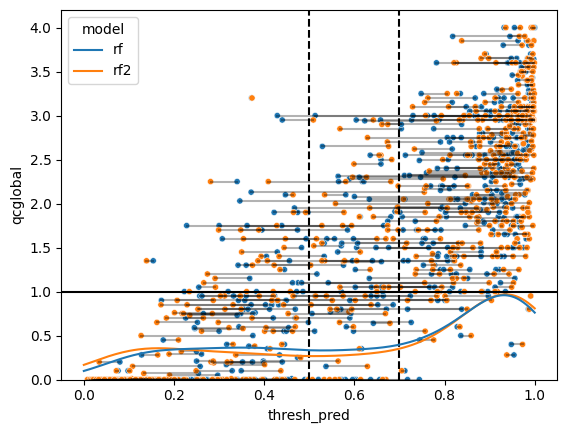

In [21]:

# Print lines as how each individual data point moved between rf and rf_weight_sample


for name in df2["name"].unique():
    data = df2[df2["name"] == name]
    # Sort by model
    data = data.sort_values(by="model")
    x = data["qcglobal"].tolist()
    y = data["thresh_pred"].tolist()
    # Plot an arrow between the two points
    #plt.arrow(y[0], x[0], y[1]-y[0], x[1]-x[0], head_width=0.02, head_length=0.02, fc='k', ec='k')
    if x[0] != x[1]:
        continue
    plt.plot(y,x, "k-", alpha=0.3)

sns.scatterplot(data=df2, x="thresh_pred", y="qcglobal", hue="model", s=20)

# Two vertical lines at 0.5 and 1.0
plt.axvline(0.5, color="black", linestyle="--")
plt.axvline(0.7, color="black", linestyle="--")
plt.axhline(1.0, color="black", linestyle="-")
# Print number of correct classi

# Plot distributions of thresh_pred but smoothed kde on top of the plot
sns.kdeplot(df2, x ="thresh_pred", hue="model", fill=False, clip=(0,1))

In [22]:
def sigmoid(x, a=1.0, b=4):
    return 1 / (1+np.exp(-b*(x-a)))

/tmp/ipykernel_11943/2369681378.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_["qc_norm"] = df_["qcglobal"].apply(asym_sigmoid)


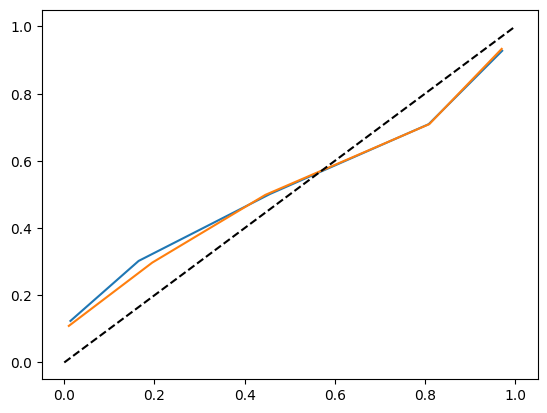

In [23]:
# Can you do a check of the calibration of both models?

from sklearn.calibration import calibration_curve
df_ = df2[df2["model"] == "rf"]

df_["qc_norm"] = df_["qcglobal"].apply(asym_sigmoid)
x, y= calibration_curve(df_["qc"] , df_["thresh_pred"], n_bins=5)
plt.plot(x,y)

df_ = df2[df2["model"] == "rf2"]
x, y= calibration_curve(df_["qc"] , df_["thresh_pred"], n_bins=5)

plt.plot(x,y)

plt.plot([0,1],[0,1], "k--")

0.04544116874964288
0.04148097475833426


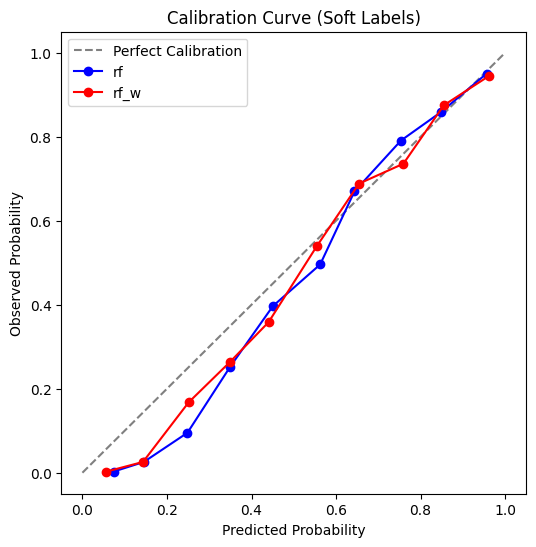

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.calibration import calibration_curve
from functools import partial 
def plot_probabilistic_calibration_curve(y_true_prob, y_pred_prob, n_bins=10):
    """Plots a calibration curve using soft (probabilistic) labels."""
    bins = np.linspace(0, 1, n_bins + 1)
    bin_indices = np.digitize(y_pred_prob, bins) - 1

    bin_means = []
    actual_means = []

    for i in range(n_bins):
        mask = bin_indices == i
        if np.any(mask):
            bin_means.append(np.mean(y_pred_prob[mask]))
            actual_means.append(np.mean(y_true_prob[mask]))
    return bin_means, actual_means

def ece(y_true_prob, y_pred_prob, n_bins=10):
    """Computes Expected Calibration Error (ECE)."""
    bins = np.linspace(0, 1, n_bins + 1)
    bin_indices = np.digitize(y_pred_prob, bins) - 1

    ece = 0
    for i in range(n_bins):
        mask = bin_indices == i
        if np.any(mask):
            avg_pred = np.mean(y_pred_prob[mask])
            avg_true = np.mean(y_true_prob[mask])
            ece += np.abs(avg_pred - avg_true) * np.sum(mask) / len(y_pred_prob)

    return ece


df_ = df2[df2["model"] == "rf"].copy()
df_["qc_norm"] = df_["qcglobal"].apply(partial(asym_sigmoid))

x, y = plot_probabilistic_calibration_curve(df_["qc_norm"] , df_["thresh_pred"])
print(ece(df_["qc_norm"] , df_["thresh_pred"]))
plt.figure(figsize=(6, 6))
plt.plot([0, 1], [0, 1], linestyle="--", color="gray", label="Perfect Calibration")
plt.plot(x, y, marker="o", color="blue", label="rf")
df_ = df2[df2["model"] == "rf2"].copy()
df_["qc_norm"] = df_["qcglobal"].apply(partial(asym_sigmoid))
x, y = plot_probabilistic_calibration_curve(df_["qc_norm"] , df_["thresh_pred"])
plt.plot(x, y, marker="o", color="red", label="rf_w")
print(ece(df_["qc_norm"] , df_["thresh_pred"]))
plt.xlabel("Predicted Probability")
plt.ylabel("Observed Probability")
plt.title("Calibration Curve (Soft Labels)")
plt.legend()
plt.show()


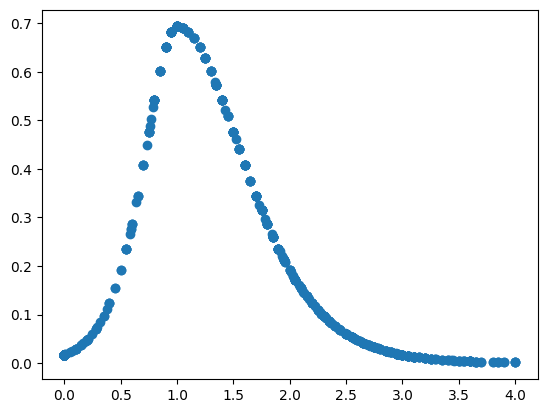

In [25]:
def binary_entropy(y):
    """Computes entropy for binary classification with probabilistic labels."""
    y = np.clip(y, 1e-9, 1 - 1e-9)  # Avoid log(0)
    return - (y * np.log(y) + (1 - y) * np.log(1 - y))
def sigmoid(x, a=1.0, b=4):
    return 1 / (1+np.exp(-b*(x-a)))

def asym_sigmoid(x, a=1.0, b1=6, b2=3):
    if x < a:
        return 1 / (1+np.exp(-b1*(x-a)))
    else:
        return 1 / (1+np.exp(-b2*(x-a)))
df_["qc_norm"] = df_["qcglobal"].apply(partial(asym_sigmoid))
y = binary_entropy(df_["qc_norm"]).tolist()
plt.scatter(df_["qcglobal"],y)

In [26]:


ece = expected_calibration_error(y_true_prob, y_pred_prob)



NameError: name 'expected_calibration_error' is not defined

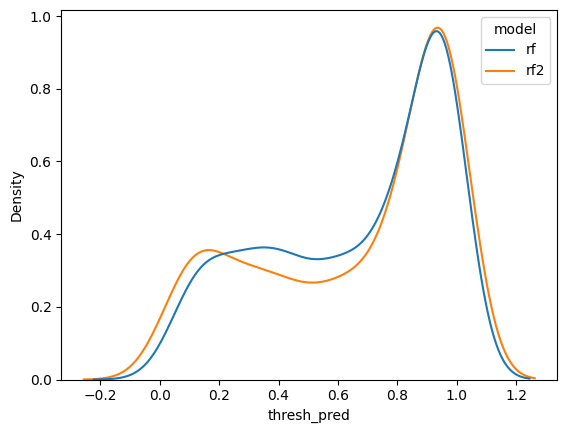

In [27]:
sns.kdeplot(df2, x ="thresh_pred", hue="model",  fill=False)
plt.show()


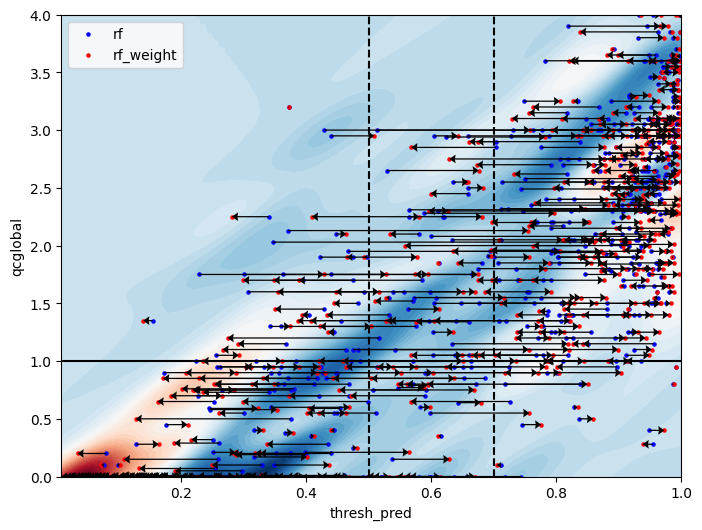

In [28]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Load or create your DataFrame
# Example structure: df = pd.read_csv("your_data.csv")
# df should have columns: ['x', 'y', 'model'] where 'model' distinguishes the two datasets.

"""Compute and plot the KDE difference between two models in 2D."""

gridsize = 100
bandwidth = 0.2
# Split data by model
df2["qcnorm"] = df2["qcglobal"].apply(partial(sigmoid,b=0.1))
data1 = df2[df2["model"] == "rf"][["thresh_pred", "qcglobal"]].values
data2 = df2[df2["model"] == "rf2"][["thresh_pred", "qcglobal"]].values

# Define grid for evaluation
xmin, xmax = df2["thresh_pred"].min(), df2["thresh_pred"].max()
ymin, ymax = df2["qcglobal"].min(), df2["qcglobal"].max()
X, Y = np.meshgrid(np.linspace(xmin, xmax, gridsize), np.linspace(ymin, ymax, gridsize))

# Compute KDE for both models
kde1 = gaussian_kde(data1.T, bw_method=bandwidth)
kde2 = gaussian_kde(data2.T, bw_method=bandwidth)

# Evaluate densities
positions = np.vstack([X.ravel(), Y.ravel()])
Z1 = np.reshape(kde1(positions), X.shape)
Z2 = np.reshape(kde2(positions), X.shape)

# Compute the difference in KDE
Z_diff = Z2 - Z1

# Plot the KDE difference
plt.figure(figsize=(8, 6))
contour = plt.contourf(X, Y, Z_diff, cmap="RdBu_r", levels=50)  # Red-blue colormap for difference
#plt.colorbar(label="KDE Difference (Model1 - Model2)")
plt.scatter(data1[:, 0], data1[:, 1], color="blue", alpha=1, s=5, label="rf")
plt.scatter(data2[:, 0], data2[:, 1], color="red", alpha=1., s=5, label="rf_weight")


X, Y = data1[:, 0], data1[:, 1]
U, V = data2[:, 0]-data1[:, 0], data2[:, 1]-data1[:, 1]


plt.legend()
plt.xlabel("X")
plt.ylabel("Y")
# for name in df2["name"].unique():
#     data = df2[df2["name"] == name]
#     # Sort by model
#     data = data.sort_values(by="model")
#     x = data["qcglobal"].tolist()
#     y = data["thresh_pred"].tolist()
#     # Plot an arrow between the two points
#     #plt.arrow(y[0], x[0], y[1]-y[0], x[1]-x[0], head_width=0.02, head_length=0.02, fc='k', ec='k')
#     if x[0] != x[1]:
#         continue
#     plt.plot(y,x, "k-", alpha=0.3)
plt.quiver(X, Y, U, V, angles='xy', scale_units='xy', scale=1, color="black", width=0.002, headwidth=7, headlength=5)


plt.xlabel("thresh_pred")
plt.ylabel("qcglobal")
plt.axvline(0.5, color="black", linestyle="--")
plt.axvline(0.7, color="black", linestyle="--")
plt.axhline(1.0, color="black", linestyle="-")

# semilogy
plt.show()

# Example usage:
# kde_2d_difference(df, "Model_A", "Model_B")


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


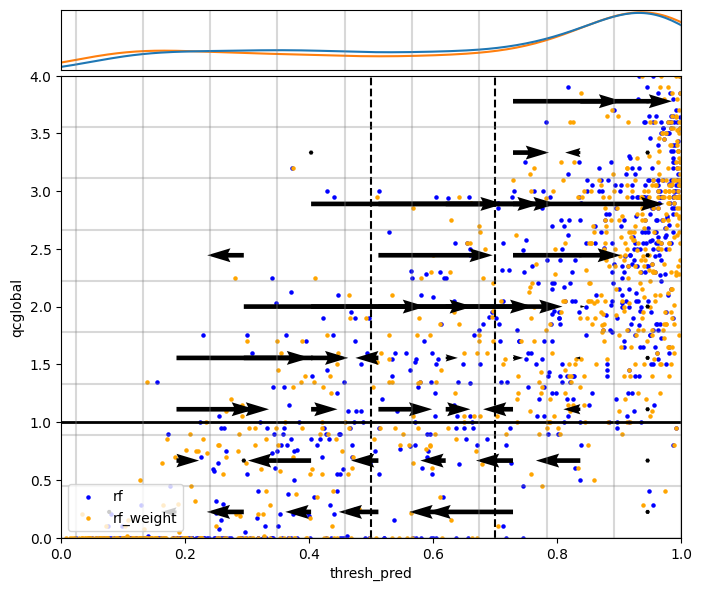

In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Example Data (Replace with your actual data)
qcglobal = data1[:, 1]
x_model1 = data1[:, 0]
x_model2 = data2[:, 0]

# Compute shifts
dx = data2[:, 0] - data1[:, 0]  # Horizontal shift
dy = np.zeros_like(dx)  # No vertical movement

# Create a DataFrame
df = pd.DataFrame({"thresh_pred": x_model1, "qcglobal": qcglobal, "shift": dx})

# Define bin edges
num_bins_x = 10  # Number of bins along x-axis
num_bins_y = 10  # Number of bins along y-axis
x_bins = np.linspace(df["thresh_pred"].min(), df["thresh_pred"].max(), num_bins_x)
y_bins = np.linspace(df["qcglobal"].min(), df["qcglobal"].max(), num_bins_y)

# Compute bin indices for each point
df["x_bin"] = np.digitize(df["thresh_pred"], bins=x_bins) - 1
df["y_bin"] = np.digitize(df["qcglobal"], bins=y_bins) - 1

# Compute average motion per bin
#df_avg = df.groupby(["x_bin", "y_bin"]).agg({"thresh_pred": "mean", "qcglobal": "mean", "shift": "mean"}).reset_index()
df_avg = df.groupby(["x_bin", "y_bin"]).agg({"thresh_pred": ["mean","count"], "qcglobal": "mean", "shift": "mean"}).reset_index()

# Extract averaged motion data
# X, Y at center of each bin, U, V as average motion
#X, Y = df_avg["thresh_pred"]["mean"], df_avg["qcglobal"]["mean"]
#X, Y = np.meshgrid(df_avg["x_bin"][:-1] + np.diff(x_bins)/2, y_bins[:-1] + np.diff(y_bins)/2)
df_avg["x_bin_mid"] = df_avg["x_bin"] * np.diff(x_bins)[0] + x_bins[0] + np.diff(x_bins)[0]/2
df_avg["y_bin_mid"] = df_avg["y_bin"] * np.diff(y_bins)[0] + y_bins[0] + np.diff(y_bins)[0]/2
X, Y = df_avg["x_bin_mid"], df_avg["y_bin_mid"]
U, V = df_avg["shift"]["mean"], np.zeros_like(df_avg["shift"])  # No vertical motion
arrow_sizes = df_avg["thresh_pred"]["count"] / df_avg["thresh_pred"]["count"].max()
arrow_sizes *= df_avg["thresh_pred"]["mean"] / df_avg["thresh_pred"]["mean"].abs().max()
arrow_sizes = 10*arrow_sizes.clip(0.1, 1).to_numpy()

# Plot
fig= plt.figure(figsize=(8, 6))

plt.scatter(data1[:, 0], data1[:, 1], color="blue", alpha=1., s=5, label="rf")
plt.scatter(data2[:, 0], data2[:, 1], color="orange", alpha=1., s=5, label="rf_weight")
plt.legend(loc="lower left")
#plt.quiver(X, Y, U, V, angles='xy', scale_units='xy', scale=1, color="black", alpha=0.8)
from matplotlib import cm
colors = cm.coolwarm((U - np.min(U)) / (np.max(U) - np.min(U)))
#plt.quiver(X, Y, U, V, angles='xy', scale_units='xy', scale=1, color="black", alpha=1)
plt.quiver(X, Y, U, V, angles='xy', scale_units='xy', scale=arrow_sizes, linewidth=arrow_sizes)
plt.xlabel("thresh_pred")
plt.ylabel("qcglobal")

#plt.xticks(x_bins)  # Set x-ticks at the bin edges
#plt.yticks(y_bins)  # Set y-ticks at the bin edges
#plt.grid(True, which='both', linestyle='--', color='gray', alpha=0.5)  # Customize the grid
# Two vertical lines at 0.5 and 1.0
plt.axvline(0.5, color="black", linestyle="--")
plt.axvline(0.7, color="black", linestyle="--")
plt.axhline(1.0, color="black", linestyle="-", linewidth=2)
# Print grid based on bins
for x in x_bins:
    plt.axvline(x, color="gray", linestyle="-", alpha=0.3)
for y in y_bins:
    plt.axhline(y, color="gray", linestyle="-", alpha=0.3)
# Plot distributions of thresh_pred but smoothed kde on top of the plot
plt.xlim(0, 1)
plt.ylim(0, 4)


ax2 = fig.add_axes([0.125, 0.89, 0.775, 0.1])  # Adjust the position [left, bottom, width, height]
sns.kdeplot(df2, x ="thresh_pred", hue="model", fill=False, clip=(0,1), ax=ax2)
ax2.set_xlim(0, 1)
#ax2.set_xticklabels("")
#ax2.set_yticklabels("")
ax2.legend().remove()
ax2.set_ylabel("")
ax2.set_xlabel("")
ax2.set_xticks([])
ax2.set_yticks([])
for x in x_bins:
    plt.axvline(x, color="gray", linestyle="-", alpha=0.3)
# Add the difference of distribution




plt.show()



In [30]:
# Display slice of data with nibabel
import matplotlib.pyplot as plt

def display(im, seg=None):
    if isinstance(im, str):
        import nibabel as nib
        im = nib.load(im).get_fdata()
    if seg is not None and isinstance(seg, str):
        seg = nib.load(seg).get_fdata()
    nrows = 2 if seg is not None else 1
    f, ax = plt.subplots(nrows,3, figsize=(15,10))
    mid = np.array(im.shape) // 2
    im = im[::-1,::-1,::-1]
    seg[seg==0] = np.nan
    if seg is not None:
        seg = seg[::-1,::-1,::-1]
        ax[0,0].imshow(im[:,:,mid[2]].T, cmap="gray")
        ax[0,1].imshow(im[:,mid[1],:].T, cmap="gray")
        ax[0,2].imshow(im[mid[0],:,:].T, cmap="gray")
        ax[1,0].imshow(im[:,:,mid[2]].T, cmap="gray")
        ax[1,1].imshow(im[:,mid[1],:].T, cmap="gray")
        ax[1,2].imshow(im[mid[0],:,:].T, cmap="gray")
        ax[1,0].imshow(seg[:,:,mid[2]].T, alpha=0.6, cmap="tab10")#, cmap="tab10" )
        ax[1,1].imshow(seg[:,mid[1],:].T, alpha=0.6, cmap="tab10" )
        ax[1,2].imshow(seg[mid[0],:,:].T, alpha=0.6, cmap="tab10")
        #disable axes   
        for a in ax:
            for b in a:
                b.axis("off")
    else:
        ax[0].imshow(im[:,:,mid[2]].T, cmap="gray")
        ax[1].imshow(im[:,mid[1],:].T, cmap="gray")
        ax[2].imshow(im[mid[0],:,:].T, cmap="gray")
        
        #disable axes
        for a in ax:
            a.axis("off")
    plt.show()
    

In [69]:
df = df2[df2["model"] == "rf"]

In [70]:
# Sort by thresh_pred
df = df.sort_values(by="thresh_pred", ascending=False)


In [71]:
failures = df[(df["qcglobal"] < 1) & (df["thresh_pred"] > 0.6)]

In [72]:
df["failed"] = (df["qcglobal"] >= 1) & (df["thresh_pred"] < 0.7)
df2 = df[~ ((df["qcglobal"] < 1) & (df["thresh_pred"] > 0.7))]
df = df.sort_values(by="thresh_pred", ascending=True)
df["error_type"] = "FN"

In [35]:
#df[df["failed"]].to_csv("FN_FP.csv", index=False)

In [36]:
df["failed"] = (df["qcglobal"] < 1) & (df["thresh_pred"] >= 0.7)
df2 = df[~ ((df["qcglobal"] >= 1) & (df["thresh_pred"] < 0.7))]
df = df.sort_values(by="thresh_pred", ascending=True)
df["error_type"] = "FP"

In [37]:
df[df["failed"]].to_csv("FP.csv", index=False)

In [38]:
df[df["failed"]][["name","qcglobal","thresh_pred"] + SCORES + ["rec"]]

,name,qcglobal,thresh_pred,is_reconstructed,geom_artefact,recon_artefact,noise,intensity_gm,intensity_dgm,rec
117,sub-KCKYB,0.10,0.712,1.0,0.00,1.15,2.05,1.05,1.05,niftymic
663,sub-YKIJT,0.00,0.718,0.0,1.10,0.10,1.50,1.50,1.50,niftymic
398,sub-IXUHB,0.80,0.718,1.0,0.95,0.60,1.00,0.40,0.35,svrtk
80,sub-CRLOP,0.95,0.724,1.0,1.20,0.95,1.35,0.10,0.85,svrtk
249,sub-EGCDN,0.65,0.726,1.0,0.85,2.55,0.00,0.85,0.00,nesvor
65,sub-CXXAK,0.00,0.744,0.0,0.40,2.00,1.40,0.85,0.60,nesvor
528,sub-PAPCS,0.45,0.745,1.0,0.00,0.20,2.45,0.45,0.00,niftymic
72,sub-DBXGH,0.90,0.785,0.0,1.95,1.40,1.95,0.80,0.85,niftymic
76,sub-EGOTA,0.90,0.801,1.0,0.95,1.00,0.80,0.90,0.90,nesvor
641,sub-RPUYV,0.60,0.828,1.0,0.05,1.50,1.70,1.60,0.45,nesvor


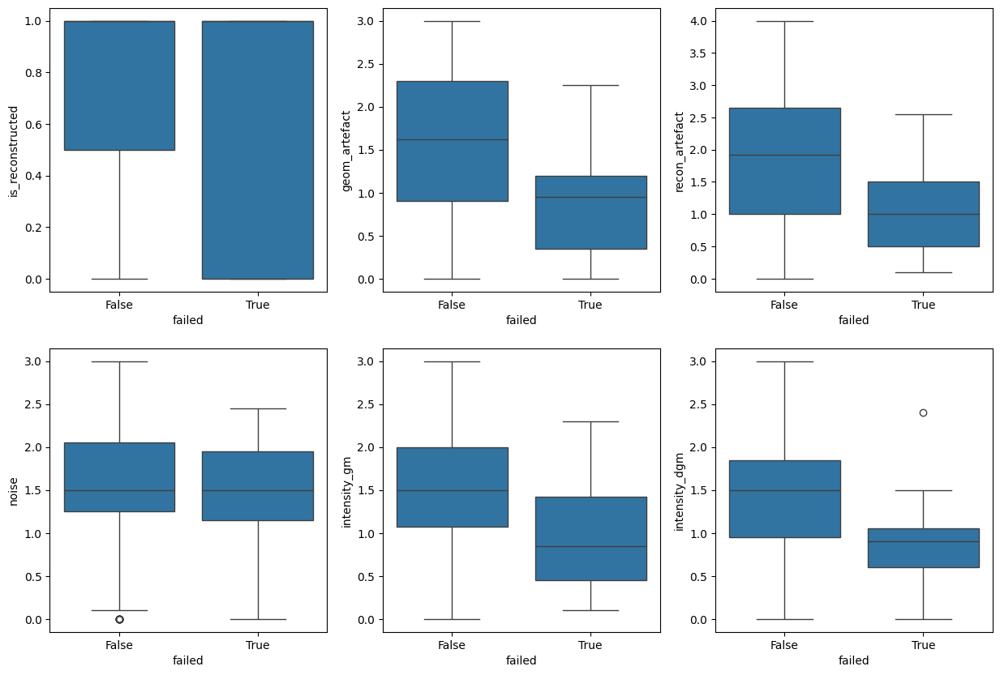

In [39]:
# Split by failures and do boxplot of SCORES

f, ax = plt.subplots(2,3, figsize=(15,10))
for i, score in enumerate(SCORES):
    sns.boxplot(data=df2, x="failed", y=score, ax=ax[i//3, i%3])

In [73]:
#df_failed = pd.read_csv("FN_FP.csv")
df_failed = df[df["failed"]]

In [74]:
# Percentage of df_failed with qc_global within 0.5 of 1
df_ = df_failed[abs(df_failed["qcglobal"] -1) > 0.5]
df_ = df_.sort_values(by="qcglobal", ascending=False)
df_[["sub", "desc", "qcglobal", "thresh_pred", "error_type", "error_type.1","patho","seg_failed"]]

KeyError: "['error_type.1', 'patho', 'seg_failed'] not in index"

In [79]:
#df_bias = df_failed[df_failed["error_type.1"]=="bias"]

df_failed = df[df["failed"]]

In [290]:
print(df3[(df3["is_correct_rf"]) & (~df3["is_correct_rf_bias"])].shape)
print(df3[(~df3["is_correct_rf"]) & (df3["is_correct_rf_bias"])].shape)
print(df3[(~df3["is_correct_rf"]) & (~df3["is_correct_rf_bias"])].shape)
print(df3[(df3["is_correct_rf"]) & (df3["is_correct_rf_bias"])].shape)

(17, 45)
(4, 45)
(90, 45)
(562, 45)


In [291]:
((df3["qcglobal"] >= 1) & (df3["thresh_pred_rf"] >= 0.7)) | ((df3["qcglobal"] < 1) & (df3["thresh_pred_rf"] < 0.7))

506    True
353    True
150    True
457    True
421    True
       ... 
672    True
587    True
344    True
215    True
651    True
Length: 673, dtype: bool

In [610]:
df_failed["error_type.1"].value_counts()
df_failed["error_agg"] = df_failed["error_type.1"].apply(lambda x: "bias" if "bias" == x else "low_contrast" if "low_contrast" == x else "patho" if "patho" == x else "other")
df_failed["error_agg"] = df_failed["error_agg"].astype("category")
df_failed["error_agg"] = df_failed["error_agg"].cat.reorder_categories(["bias","low_contrast","patho","other"])
# Rename as well
df_failed["Error types"] = df_failed["error_agg"].cat.rename_categories({"bias":"Bias", "low_contrast":"Low Contrast", "patho":"Pathological", "other":"Other"})

In [700]:
nbins=17
df_failed["error_abs"] = (df_failed["qcglobal"] - 1.0 )
df_failed["bin"] =  np.digitize(df_failed["qcglobal"], bins=np.linspace(0 ,3.4,nbins))/nbins*3.4

In [726]:
df_failed.shape

(95, 51)

In [731]:
(((df_failed["qcglobal"]-1.0)<0.5) & ((df_failed["qcglobal"]-1.0)>-0.5)).sum()

42

(0.0, 18.0)

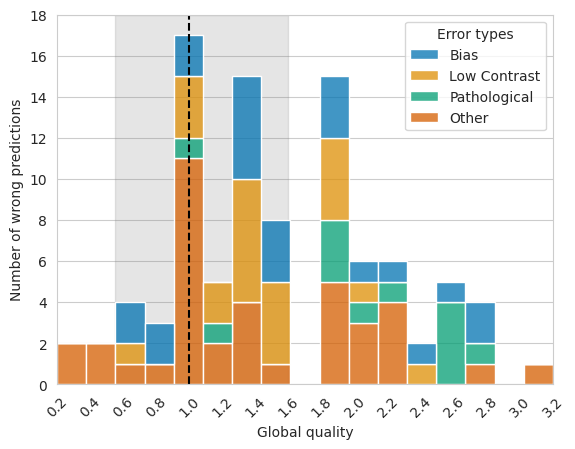

In [723]:

# Sort error agg by ["Patho","Low Contrast","Bias","Other"]
#Plot a shaded region between 0.5 and 1.5
plt.fill_between([0.55,1.6], 0, 18, color="gray", alpha=0.2)
sns.histplot(data=df_failed, x="bin", hue="Error types", multiple="stack",cumulative=False,bins=nbins, palette="colorblind")
plt.xlabel("Global quality")
plt.ylabel("Number of wrong predictions")
#remove xaxis grid

plt.gca().xaxis.grid(False)
# Put xtick for each bin
plt.xticks(np.linspace(0,3.4,nbins+1))
# rotate 45 degrees
plt.xticks(rotation=45)
plt.axvline(1, color="black", linestyle="--")
plt.xlim(0.2,3.2)
plt.ylim(0,18)

In [ ]:
df_failed.sort_values("error_abs", ascending=False)

,name,sub,ses,qc,res,rec,sr-id,desc,qcglobal,is_reconstructed,...,error_type,error_type.1,patho,seg_failed,comment,rerun_bias_corr,error_agg,error_abs,bin,Error types
94,sub-BWWUX,chuv171,1,True,1.1,mialsrtk,1.0,sub-chuv171_ses-1_rec-mialsrtk_run-1,3.20,1,...,FN,reo,1,1,NaN,NaN,other,2.20,2.00,Other
92,sub-MXENY,chuv124,1,True,0.8,niftymic,2.0,sub-chuv124_ses-1_rec-niftymic_run-2,2.95,0,...,FN,patho,1,1,NaN,NaN,patho,1.95,2.00,Pathological
93,sub-EXDVS,chuv187,1,True,1.1,niftymic,1.0,sub-chuv187_ses-1_rec-niftymic_run-1,2.95,1,...,FN,blurry,0,0,NaN,NaN,other,1.95,2.00,Other
91,sub-POOFU,chuv232,1,True,0p8,svrtk,NaN,sub-chuv232_ses-1.0_run-all_rec-svrtk,2.90,1,...,FN,bias,0,0,NaN,Corrected,bias,1.90,1.75,Bias
90,sub-ODSDE,chuv169,1,True,0p8,svrtk,NaN,sub-chuv169_ses-1.0_run-all_rec-svrtk,2.85,1,...,FN,bias,0,0,NaN,Corrected,bias,1.85,1.75,Bias
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22,sub-EZBPW,157,1,True,0.8,niftymic,NaN,sub-157_ses-01_run-qc_rec-niftymic,1.00,1,...,FN,low_contrast,0,0,NaN,NaN,low_contrast,0.00,0.25,Low Contrast
18,sub-BXWQS,99,1,True,0.8,nesvor,1.0,sub-99_ses-1_rec-nesvor_run-1,1.00,1,...,FN,low_contrast,0,0,NaN,NaN,low_contrast,0.00,0.25,Low Contrast
19,sub-FKBTG,chuv213,1,True,1.1,mialsrtk,1.0,sub-chuv213_ses-1_rec-mialsrtk_run-1,1.00,1,...,FN,reo,1,1,limit (1.0),NaN,other,0.00,0.25,Other
20,sub-BYYQR,296,1,True,0.5,niftymic,2.0,sub-296_ses-1_rec-niftymic_run-2,1.00,1,...,FN,low_contrast,0,0,limit (1.0),NaN,low_contrast,0.00,0.25,Low Contrast


In [66]:
df3 = df2[["name","model","thresh_pred"]].set_index(["model","name"]).unstack(level=0).droplevel(0,axis=1)
df3 = df3.merge(df2[df2["model"] == "rf"], left_index=True, right_on="name")
# Rename two first columns as thresh_pred_rf and thresh_pred_rf_bias
df3 = df3.rename(columns={"rf":"thresh_pred_rf", "rf_bias":"thresh_pred_rf_bias"})
df3 = df3.drop(columns=["thresh_pred","thresh_pred_list","model"])
df3 = df3.sort_values(by="qcglobal", ascending=True)
df3["is_correct_rf"] = ((df3["qcglobal"] >= 1) & (df3["thresh_pred_rf"] >= 0.7)) | ((df3["qcglobal"] < 1) & (df3["thresh_pred_rf"] < 0.7))
df3["is_correct_rf_bias"] = ((df3["qcglobal"] >= 1) & (df3["thresh_pred_rf_bias"] >= 0.7)) | ((df3["qcglobal"] < 1) & (df3["thresh_pred_rf_bias"] < 0.7))
df_ = df3[~(df3["is_correct_rf"]) & (df3["is_correct_rf_bias"])]

for i, row in df_.iterrows():
    sub = row["sub"]
    qcglobal = row["qcglobal"]
    thresh_pred = row["thresh_pred_rf"]
    thresh_pred2 = row["thresh_pred_rf_bias"]
    is_reco = row["is_reconstructed"]
    geom_artefact = row["geom_artefact"]
    recon_artefact = row["recon_artefact"]
    noise = row["noise"]
    intensity_gm = row["intensity_gm"]
    intensity_dgm = row["intensity_dgm"]
    print(row["im"])
    print(row["seg"])
    print(f"Sub {sub} -- qcglobal: {qcglobal} -- thresh_pred: {thresh_pred:.3f} -- thresh_pred2: {thresh_pred2:.3f}")
    print(f"Is reco: {is_reco} -- geom_artefact: {geom_artefact} -- recon_artefact: {recon_artefact}")
    print(f"Noise: {noise} -- intensity_gm: {intensity_gm} -- intensity_dgm: {intensity_dgm}")
    display(row["im"], row["seg"])

KeyError: 'thresh_pred_rf_bias'

In [388]:
sigmoid(1, a=0.5763, b=2)

0.7000214488805125

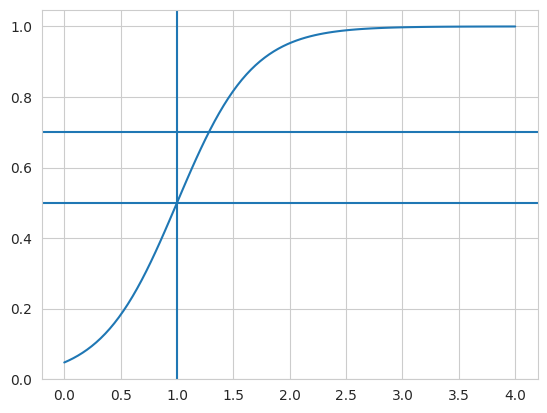

In [ ]:
x = np.linspace(0,4,100)
#y = sigmoid(x, a=0.5763, b=2)
#y = sigmoid(x, a=0.73, b=3)
y = partial(asym_sigmoid,a=1.0, b1=3, b2=3)
y = np.vectorize(y)(x)
plt.plot(x,y)
plt.axhline(0.7)
plt.axhline(0.5)
plt.axvline(1)

In [467]:
df2["qc01"] = df2["qcglobal"].apply(lambda x: partial(sigmoid,a=0.73, b=3)(x))
df2["diff"] = (df2["thresh_pred"]-df2["qc01"])
df2["mae"] = (df2["thresh_pred"]-df2["qc01"]).abs()
df2["qc_bin"] = np.digitize(df2["qc01"], bins=np.linspace(0,1,10))
df2["qc_bin_median"] = df2.groupby("qc_bin")["diff"].transform("median")
df2["qc_bin_95"] = df2.groupby("qc_bin")["diff"].transform(lambda x: np.percentile(x, 95))
df2["qc_bin_5"] = df2.groupby("qc_bin")["diff"].transform(lambda x: np.percentile(x, 5))

In [468]:
df_unique = df2[["qc01","mae","qc_bin","qc_bin_median","qc_bin_95","qc_bin_5"]]
# Unique qc_bin
df_unique = df_unique.drop_duplicates(subset=["qc_bin"])
# Sort by qc_bin
df_unique = df_unique.sort_values(by="qc_bin")

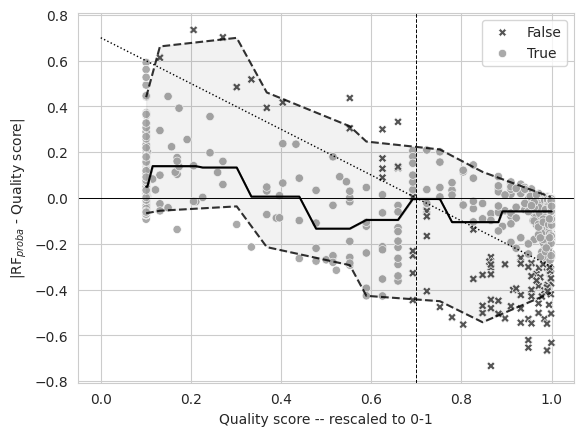

In [471]:

sns.scatterplot(data=df2[df2["model"]=="rf"], x="qc01", y="diff", hue="is_correct", style="is_correct", markers=["X","o"], palette="gray")
# Plot the bin-wise average MSE
sns.lineplot(data=df2, x="qc01", y="qc_bin_median", color="black", linewidth=1.5)
# Plot the 95th and 5th percentile and fill between them
plt.plot(df_unique["qc01"], df_unique["qc_bin_95"], "k--", alpha=0.8)
plt.plot(df_unique["qc01"], df_unique["qc_bin_5"], "k--", alpha=0.8)
plt.fill_between(df_unique["qc01"], df_unique["qc_bin_5"], df_unique["qc_bin_95"], color="black", alpha=0.05)
# Do a lineplot with slope -1 and 0 at x=0.7
plt.plot([0.,1.0],[0.7,-0.3], "k:", linewidth=1)
#plt.xlim(0.22,1.01)
# Axvline at 0.7
plt.axvline(0.7, color="black", linestyle="--", linewidth=0.7)
plt.axhline(0.0, color="black", linestyle="-", linewidth=0.7)
sns.set_style("whitegrid")
plt.xlabel("Quality score -- rescaled to 0-1")
plt.ylabel("|RF$_{proba}$ - Quality score|")
plt.show()

In [ ]:
# Given a value in 0.
# Map 0.7 or 0.5 to 1 and then compress everything in the range 0-4


In [ ]:
a = 2 log(3)≈2.19722, b = -log(2)≈-0.693147, c = -1/2 = -0.5

In [338]:
exp05 = lambda x: np.exp(2*np.log(3)*x-np.log(2)) -0.5
exp07 = lambda x: np.exp(4.513101*x-3.115782) -0.04434378997

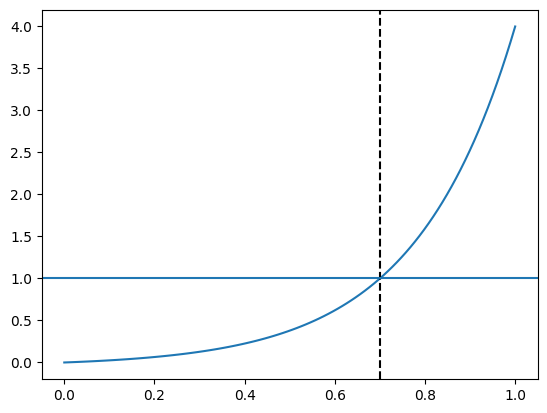

In [339]:
x= np.linspace(0,1,100)
y = exp07(x)
plt.plot(x,y) 
plt.axvline(0.7, color="black", linestyle="--")
plt.axhline(1)

In [341]:
df2["thresh_pred_04"]

0      3.096795
1      1.300291
2      1.109013
3      3.804123
4      3.256669
         ...   
668    0.056024
669    3.012878
670    1.580924
671    0.111151
672    3.601244
Name: thresh_pred_04, Length: 1346, dtype: float64

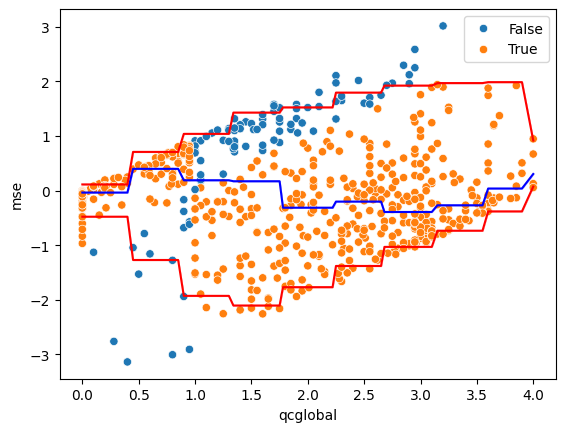

In [ ]:
df2["thresh_pred_04"] = df2["thresh_pred"].apply(exp07)
df2["mse"] = abs(df2["qcglobal"] - df2["thresh_pred_04"])
df2["is_correct"] = ((df2["qcglobal"] >= 1) & (df2["thresh_pred"] >= 0.7)) | ((df2["qcglobal"] < 1) & (df2["thresh_pred"] < 0.7))
sns.scatterplot(data=df2[df2["model"]=="rf"], x="qcglobal", y="mse", hue="is_correct")
# Plot the bin-wise average MSE
df2["qc_bin"] = np.digitize(df2["qcglobal"], bins=np.linspace(0,4,10))
df2["qc_bin_median"] = df2.groupby("qc_bin")["mse"].transform("median")
df2["qc_bin_95"] = df2.groupby("qc_bin")["mse"].transform(lambda x: np.percentile(x, 95))
df2["qc_bin_5"] = df2.groupby("qc_bin")["mse"].transform(lambda x: np.percentile(x, 5))
sns.lineplot(data=df2, x="qcglobal", y="qc_bin_median", color="blue")
sns.lineplot(data=df2, x="qcglobal", y="qc_bin_95", color="red")
sns.lineplot(data=df2, x="qcglobal", y="qc_bin_5", color="red")
plt.show()

0.049707993264242765
0.05109656394172625


<AxesSubplot: xlabel='qc01_bin', ylabel='mse_rf_bias'>

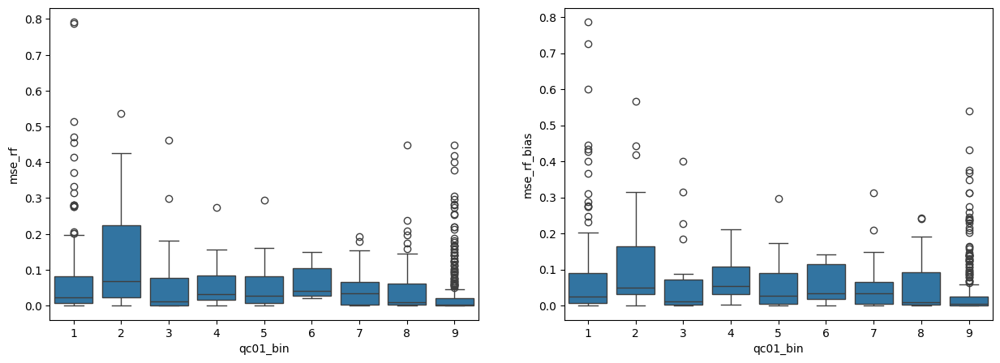

In [ ]:
df2[df2["model"]=="rf2"]

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-149/ses-01/anat/sub-149_ses-01_run-all_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-149/ses-01/anat/sub-149_ses-01_run-all_rec-SR_dseg.nii.gz
Sub 149 -- qcglobal: 1.35 -- thresh_pred: 0.154
Is reco: 1.0 -- geom_artefact: 1.85 -- recon_artefact: 1.2
Noise: 1.5 -- intensity_gm: 0.65 -- intensity_dgm: 0.95


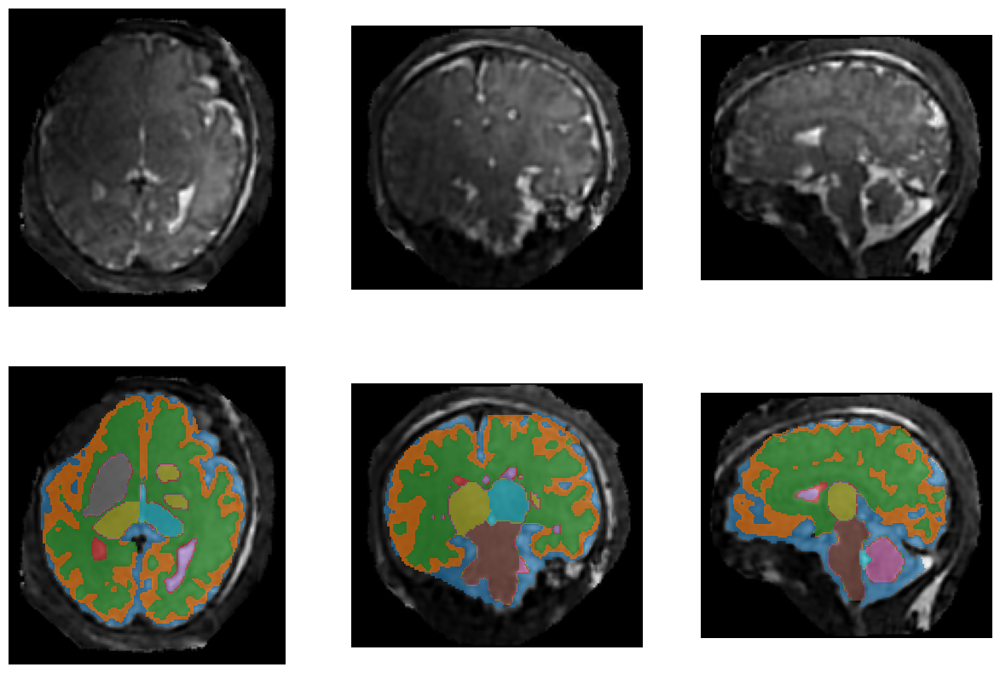

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-083/ses-01/anat/sub-083_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-083/ses-01/anat/sub-083_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 83 -- qcglobal: 1.75 -- thresh_pred: 0.22799999999999998
Is reco: 1.0 -- geom_artefact: 1.35 -- recon_artefact: 1.7
Noise: 2.0 -- intensity_gm: 1.35 -- intensity_dgm: 1.1


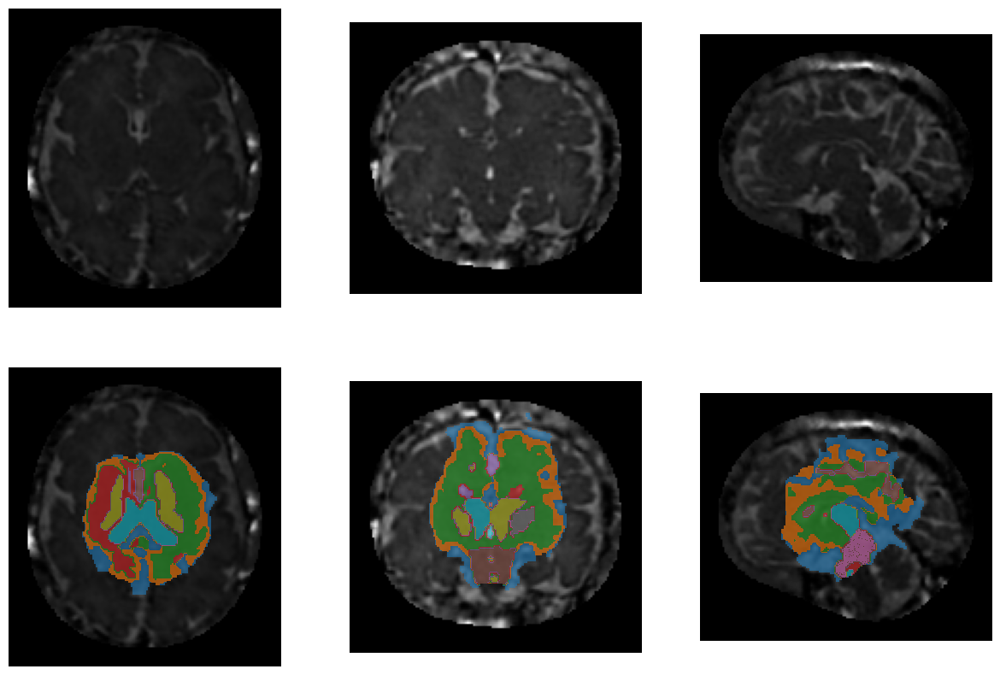

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv123/ses-01/anat/sub-chuv123_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv123/ses-01/anat/sub-chuv123_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv123 -- qcglobal: 1.05 -- thresh_pred: 0.255
Is reco: 0.0 -- geom_artefact: 2.6 -- recon_artefact: 1.0
Noise: 1.9 -- intensity_gm: 0.9 -- intensity_dgm: 1.5


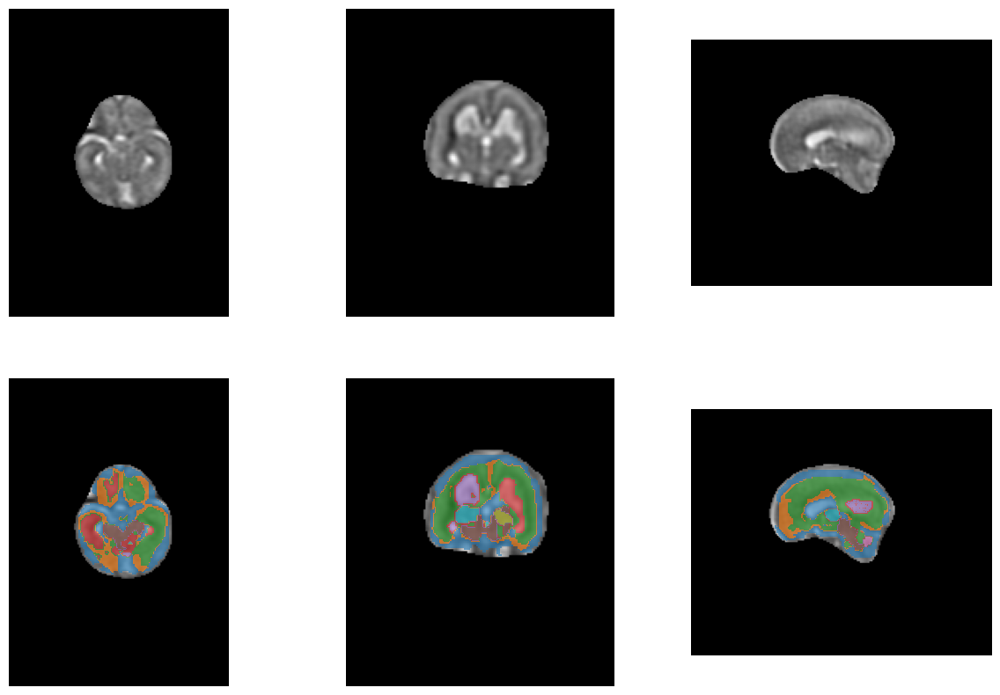

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_0p8/niftymic/sub-075/ses-01/anat/sub-075_ses-01_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-075/ses-01/anat/sub-075_ses-01_run-all_dseg.nii.gz
Sub 75 -- qcglobal: 1.75 -- thresh_pred: 0.29999999999999993
Is reco: 1.0 -- geom_artefact: 1.95 -- recon_artefact: 1.2
Noise: 1.5 -- intensity_gm: 0.9 -- intensity_dgm: 1.1


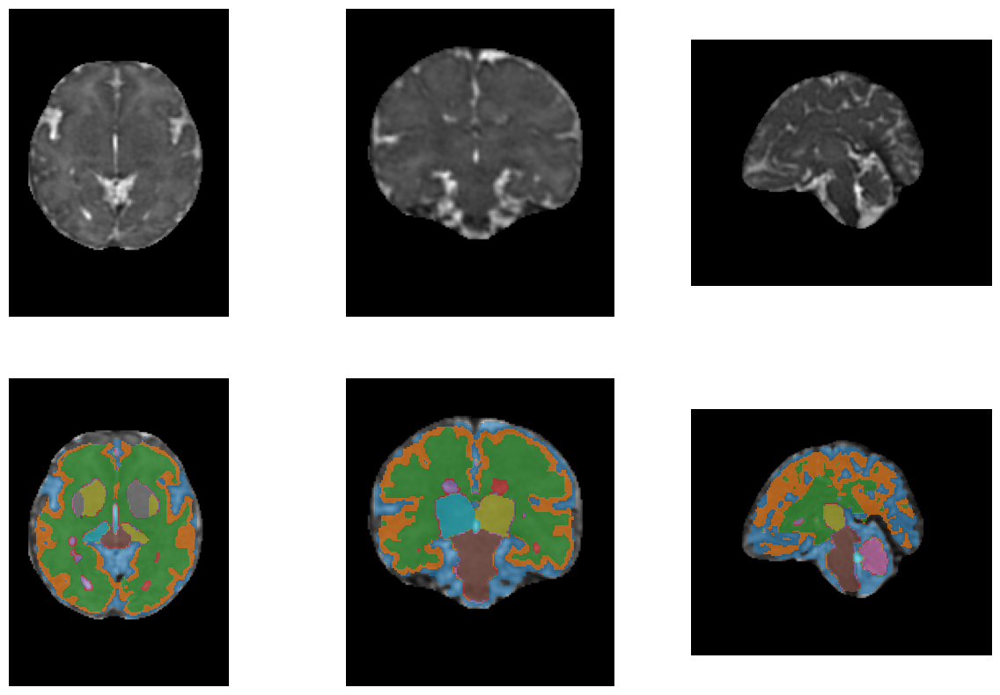

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-299/ses-01/anat/sub-299_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-299/ses-01/anat/sub-299_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 299 -- qcglobal: 1.6 -- thresh_pred: 0.307
Is reco: 1.0 -- geom_artefact: 1.0 -- recon_artefact: 1.35
Noise: 1.05 -- intensity_gm: 1.15 -- intensity_dgm: 1.05


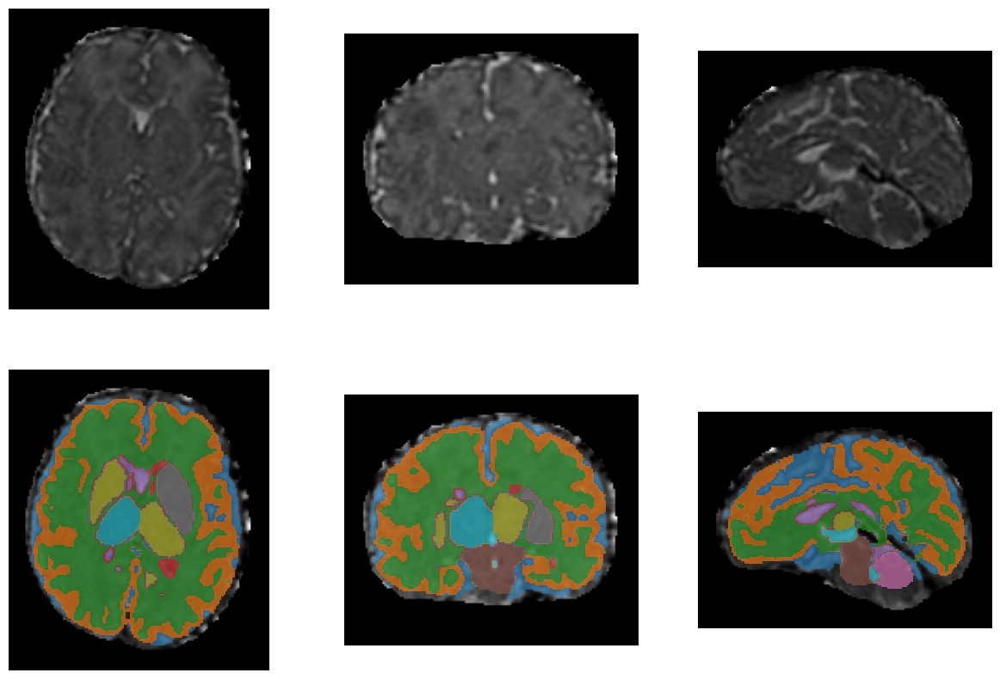

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv066/ses-01/anat/sub-chuv066_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv066/ses-01/anat/sub-chuv066_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv066 -- qcglobal: 2.25 -- thresh_pred: 0.33999999999999997
Is reco: 1.0 -- geom_artefact: 2.1 -- recon_artefact: 2.15
Noise: 2.1 -- intensity_gm: 0.95 -- intensity_dgm: 1.75


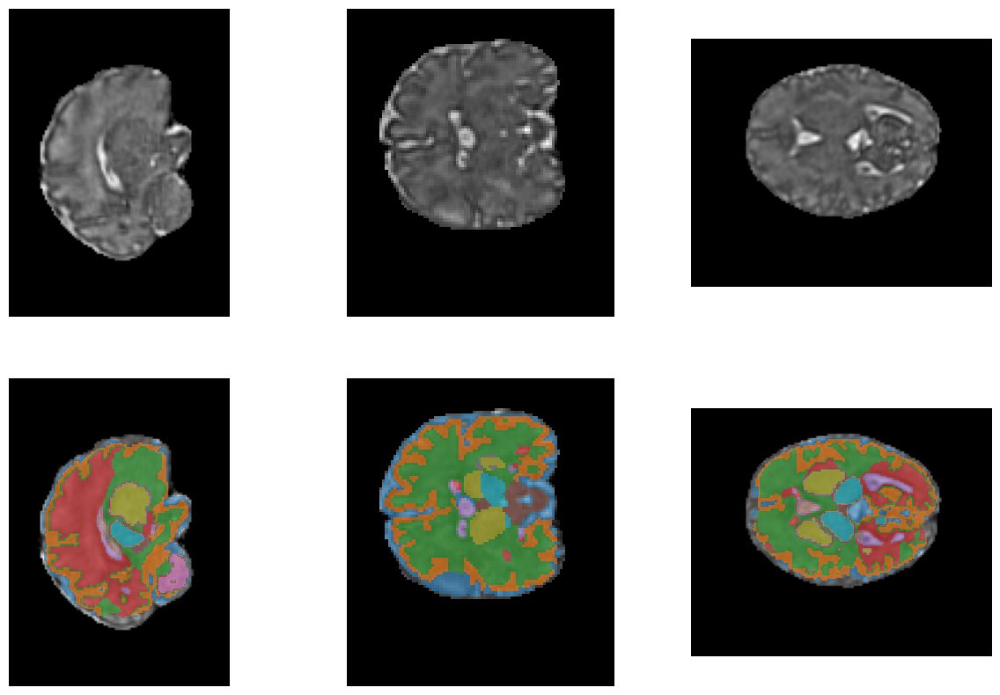

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-023/ses-01/anat/sub-023_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-023/ses-01/anat/sub-023_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub 23 -- qcglobal: 1.3 -- thresh_pred: 0.34199999999999997
Is reco: 1.0 -- geom_artefact: 0.2 -- recon_artefact: 2.25
Noise: 1.75 -- intensity_gm: 1.6 -- intensity_dgm: 1.0


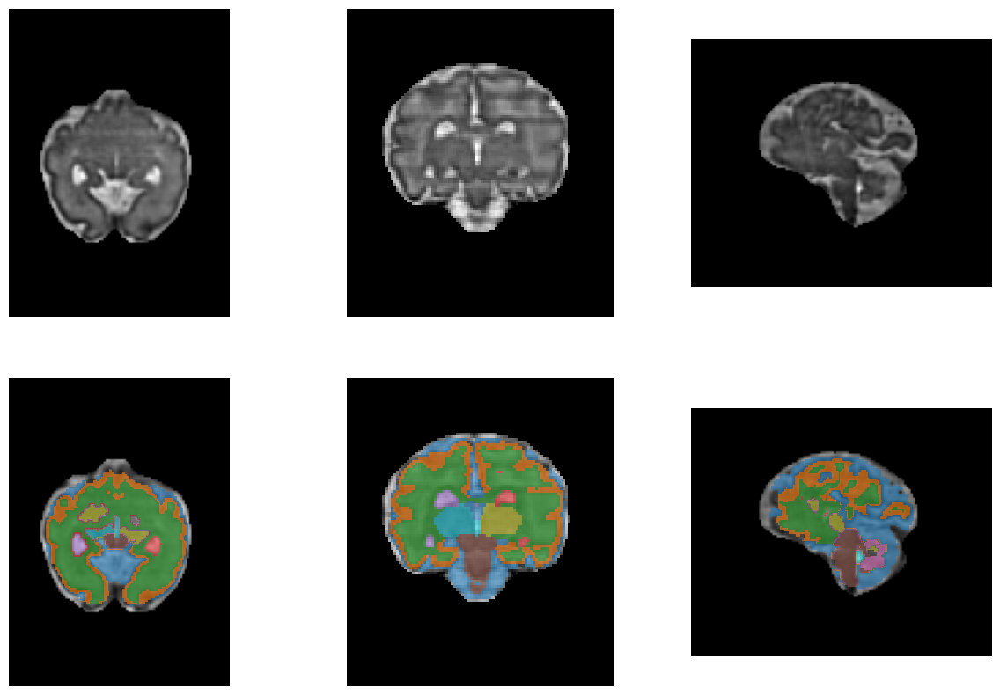

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-135/ses-01/anat/sub-135_ses-01_acq-haste_res-0p5_run-all0505_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-135/ses-01/anat/sub-135_ses-01_acq-haste_res-0p5_run-all0505_dseg.nii.gz
Sub 135 -- qcglobal: 2.03 -- thresh_pred: 0.346
Is reco: 1.0 -- geom_artefact: 1.89 -- recon_artefact: 1.69
Noise: 2.39 -- intensity_gm: 1.18 -- intensity_dgm: 1.54


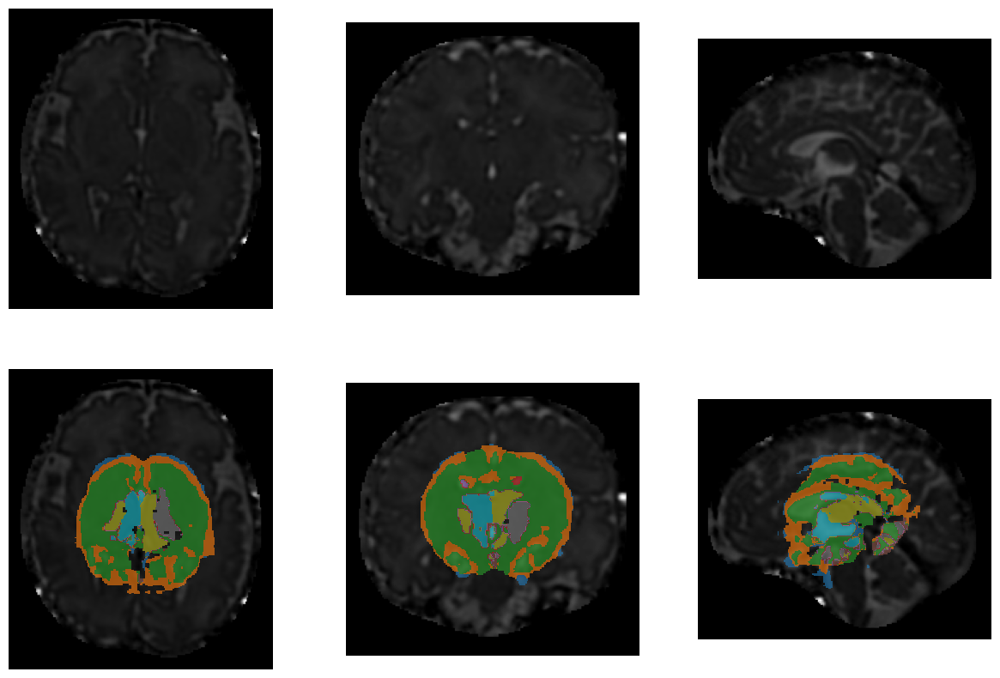

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_0p8/niftymic/sub-149/ses-01/anat/sub-149_ses-01_run-qc0508_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-149/ses-01/anat/sub-149_ses-01_run-qc0508_SR_dseg.nii.gz
Sub 149 -- qcglobal: 1.3 -- thresh_pred: 0.36
Is reco: 0.0 -- geom_artefact: 1.05 -- recon_artefact: 1.05
Noise: 1.4 -- intensity_gm: 0.85 -- intensity_dgm: 1.1


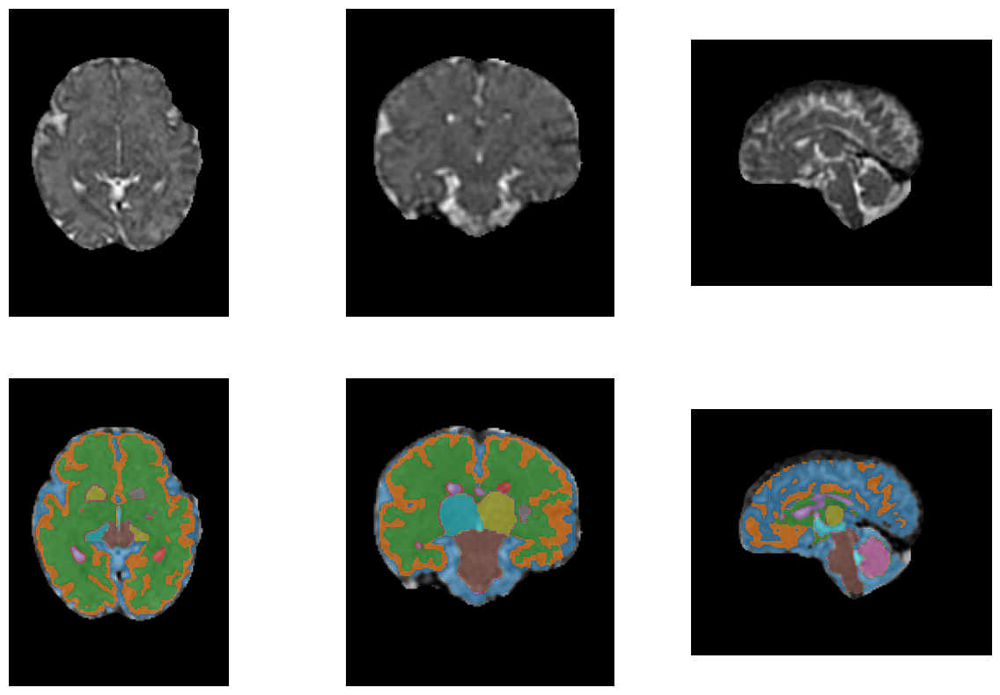

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-kispi2017/anat/sub-kispi2017__run-qc0505_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi2017/anat/sub-kispi2017__run-qc0505_rec-svrtk_dseg.nii.gz
Sub kispi2017 -- qcglobal: 1.75 -- thresh_pred: 0.36200000000000004
Is reco: 1.0 -- geom_artefact: 1.05 -- recon_artefact: 1.55
Noise: 2.05 -- intensity_gm: 0.85 -- intensity_dgm: 1.5


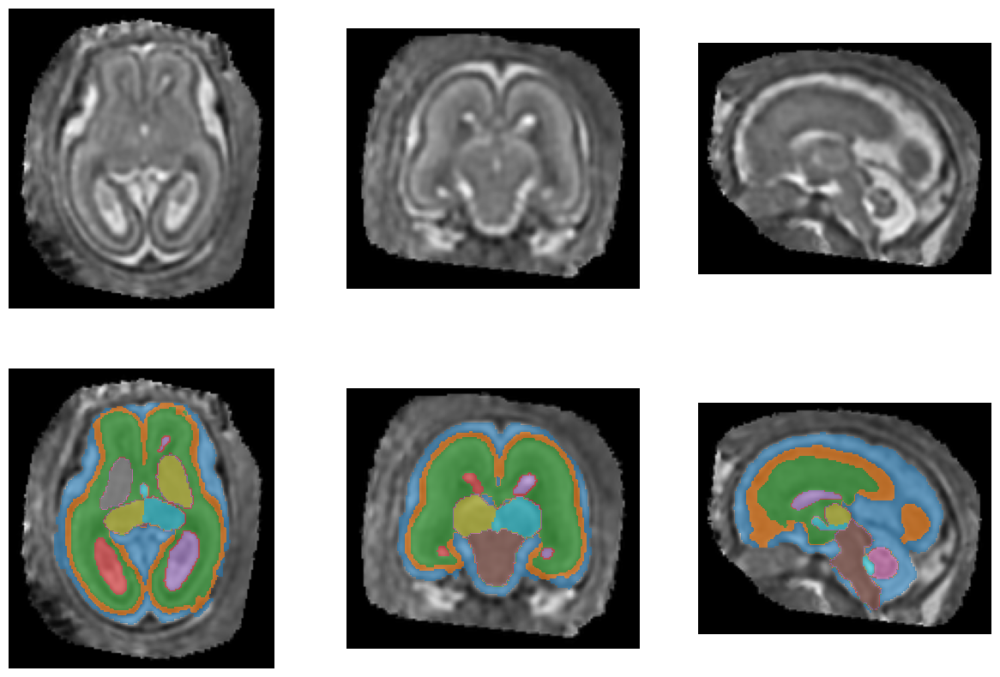

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv066/ses-01/anat/sub-chuv066_ses-01_run-1_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv066/ses-01/anat/sub-chuv066_ses-01_run-1_rec-niftymic_dseg.nii.gz
Sub chuv066 -- qcglobal: 1.15 -- thresh_pred: 0.368
Is reco: 1.0 -- geom_artefact: 1.7 -- recon_artefact: 1.4
Noise: 1.45 -- intensity_gm: 0.85 -- intensity_dgm: 0.7


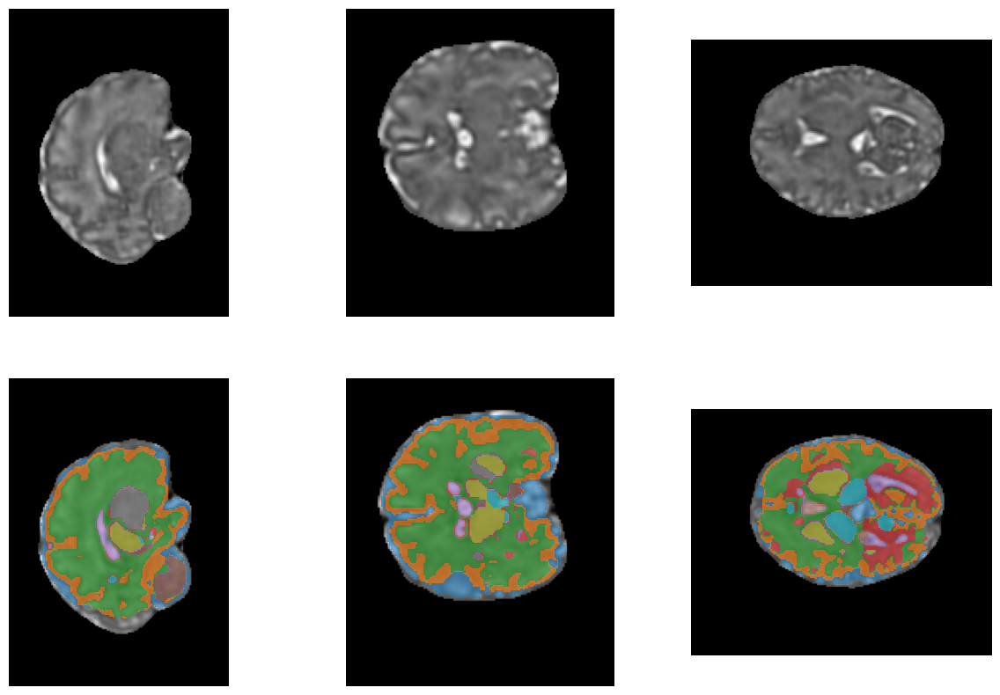

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-140/ses-01/anat/sub-140_ses-01_run-qc0505_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-140/ses-01/anat/sub-140_ses-01_run-qc0505_SR_dseg.nii.gz
Sub 140 -- qcglobal: 2.13 -- thresh_pred: 0.371
Is reco: 1.0 -- geom_artefact: 2.06 -- recon_artefact: 1.7
Noise: 2.33 -- intensity_gm: 1.14 -- intensity_dgm: 1.76


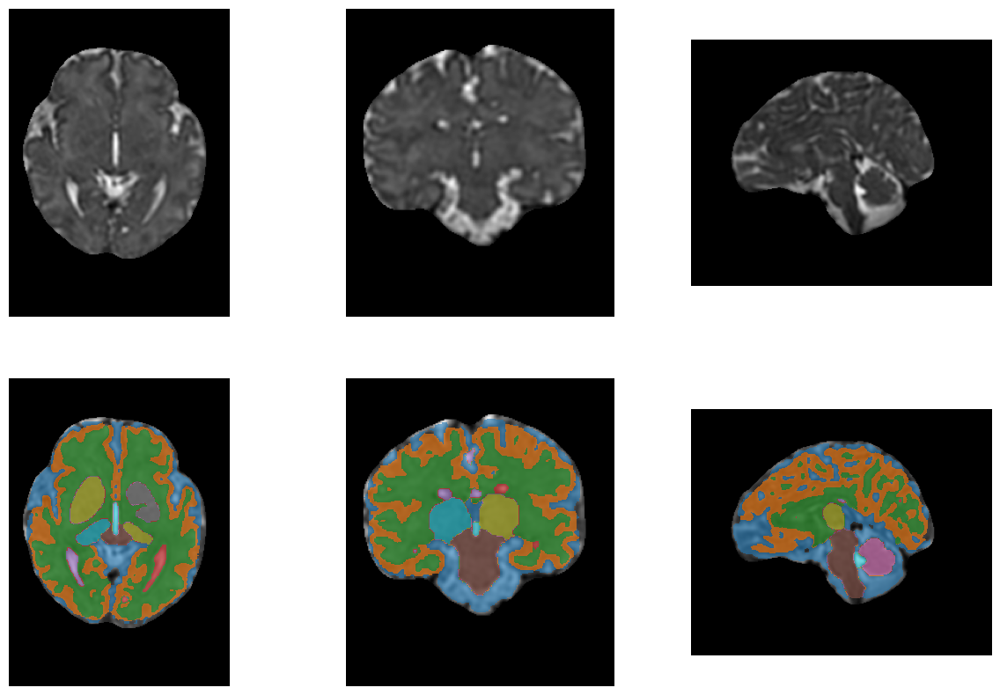

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/mialsrtk/pymialsrtk-2.1.0/sub-chuv171/ses-01/anat/sub-chuv171_ses-01_rec-SR_id-1_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv171/ses-01/anat/sub-chuv171_ses-01_rec-SR_id-1_dseg.nii.gz
Sub chuv171 -- qcglobal: 3.2 -- thresh_pred: 0.372
Is reco: 1.0 -- geom_artefact: 2.6 -- recon_artefact: 3.55
Noise: 2.15 -- intensity_gm: 1.5 -- intensity_dgm: 1.5


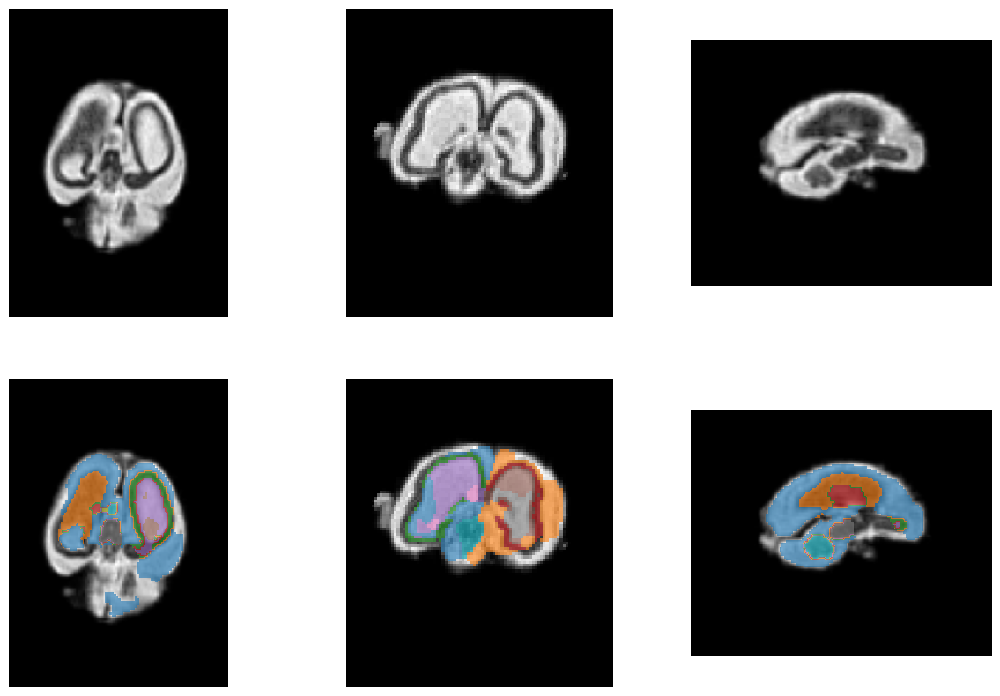

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-105/ses-01/anat/sub-105_ses-01_run-qc0505_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-105/ses-01/anat/sub-105_ses-01_run-qc0505_SR_dseg.nii.gz
Sub 105 -- qcglobal: 1.7 -- thresh_pred: 0.395
Is reco: 0.0 -- geom_artefact: 2.55 -- recon_artefact: 1.45
Noise: 2.05 -- intensity_gm: 1.0 -- intensity_dgm: 1.3


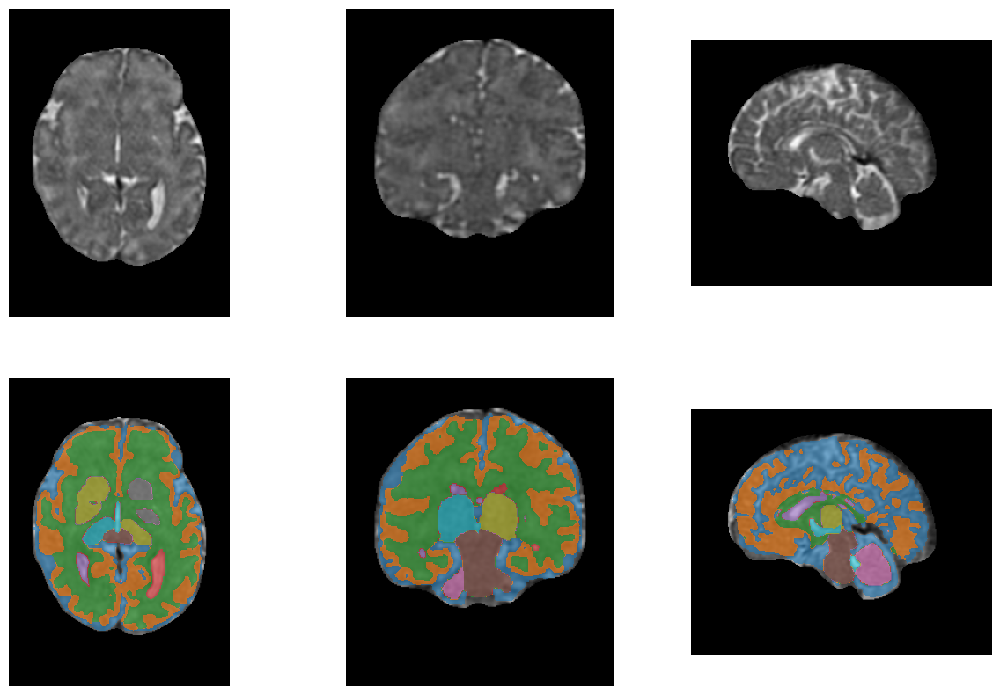

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-075/ses-01/anat/sub-075_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-075/ses-01/anat/sub-075_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 75 -- qcglobal: 1.4 -- thresh_pred: 0.4050000000000001
Is reco: 1.0 -- geom_artefact: 1.95 -- recon_artefact: 1.4
Noise: 1.45 -- intensity_gm: 0.65 -- intensity_dgm: 0.6


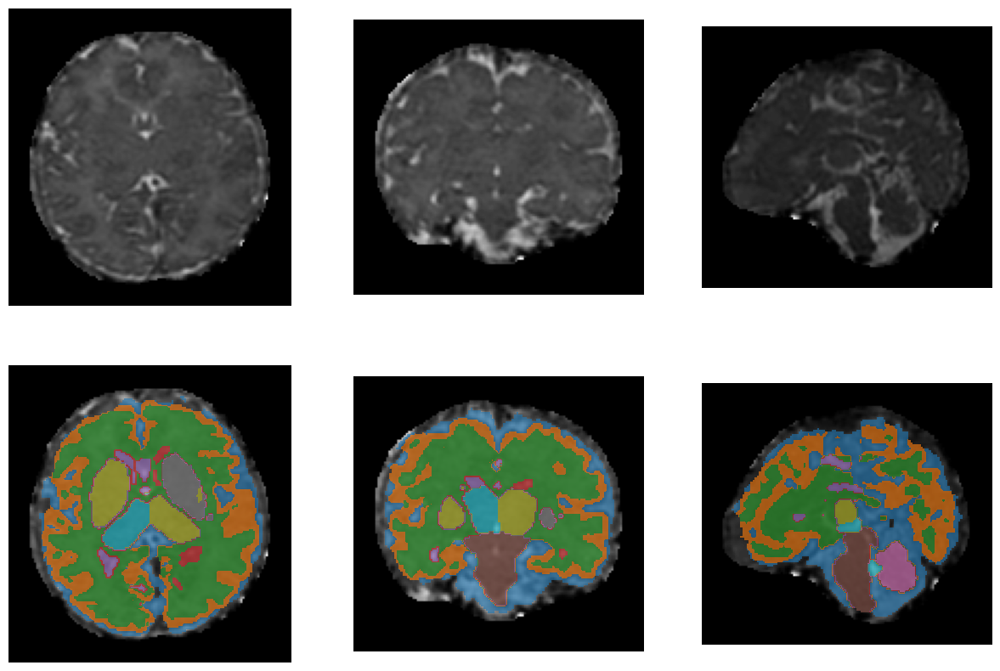

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv128/ses-01/anat/sub-chuv128_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv128/ses-01/anat/sub-chuv128_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv128 -- qcglobal: 1.9 -- thresh_pred: 0.42200000000000004
Is reco: 1.0 -- geom_artefact: 1.35 -- recon_artefact: 1.8
Noise: 2.25 -- intensity_gm: 0.65 -- intensity_dgm: 1.95


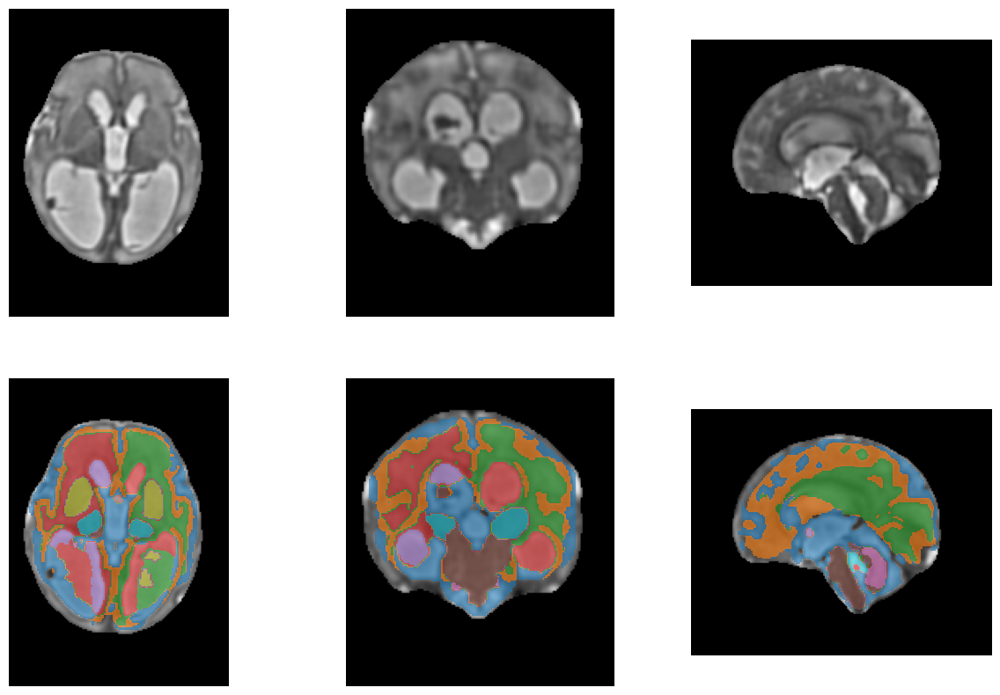

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv107/ses-01/anat/sub-chuv107_ses-01_run-1_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv107/ses-01/anat/sub-chuv107_ses-01_run-1_rec-svrtk_dseg.nii.gz
Sub chuv107 -- qcglobal: 1.45 -- thresh_pred: 0.429
Is reco: 1.0 -- geom_artefact: 1.3 -- recon_artefact: 0.9
Noise: 1.95 -- intensity_gm: 0.45 -- intensity_dgm: 1.05


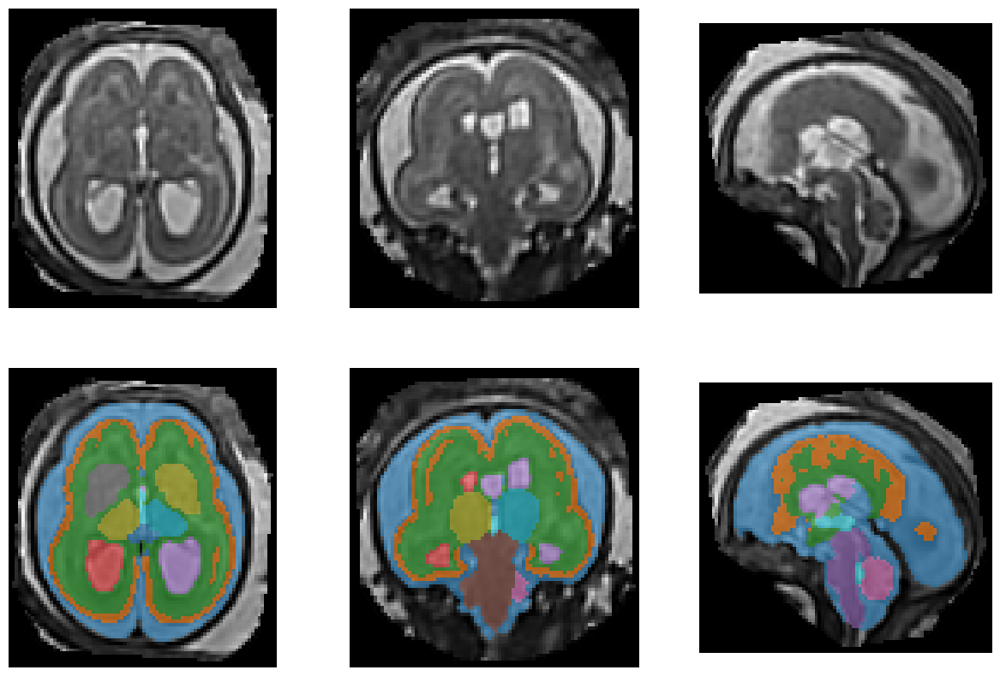

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-chuv120/ses-01/anat/sub-chuv120_ses-01_res-1p1_run-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv120/ses-01/anat/sub-chuv120_ses-01_res-1p1_run-2_dseg.nii.gz
Sub chuv120 -- qcglobal: 3.0 -- thresh_pred: 0.4290000000000001
Is reco: 1.0 -- geom_artefact: 2.1 -- recon_artefact: 2.95
Noise: 1.9 -- intensity_gm: 2.05 -- intensity_dgm: 2.15


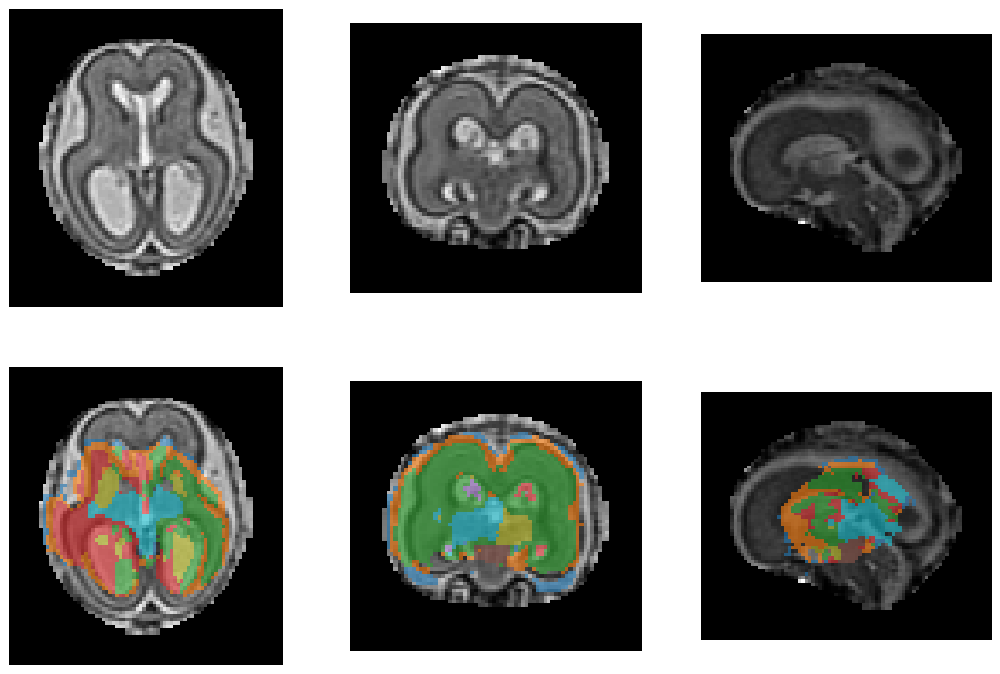

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv247/ses-01/anat/sub-chuv247_ses-01_run-2_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv247/ses-01/anat/sub-chuv247_ses-01_run-2_rec-svrtk_dseg.nii.gz
Sub chuv247 -- qcglobal: 1.75 -- thresh_pred: 0.43900000000000006
Is reco: 1.0 -- geom_artefact: 0.9 -- recon_artefact: 1.8
Noise: 1.05 -- intensity_gm: 1.3 -- intensity_dgm: 0.8


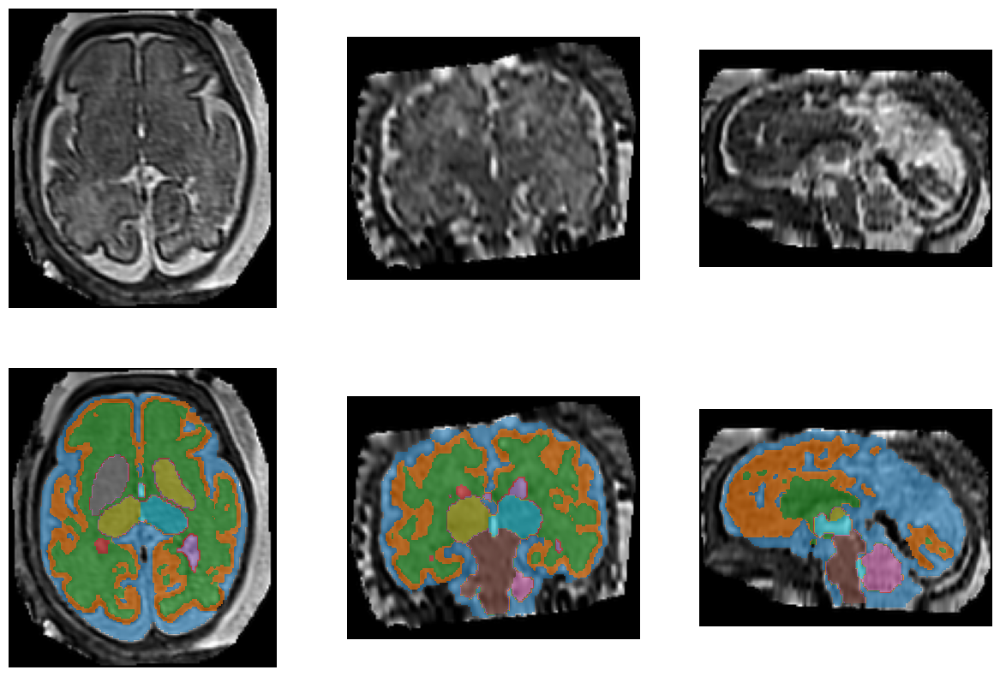

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv124/ses-01/anat/sub-chuv124_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv124/ses-01/anat/sub-chuv124_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv124 -- qcglobal: 2.95 -- thresh_pred: 0.44000000000000006
Is reco: 0.0 -- geom_artefact: 2.55 -- recon_artefact: 1.1
Noise: 2.5 -- intensity_gm: 2.1 -- intensity_dgm: 2.2


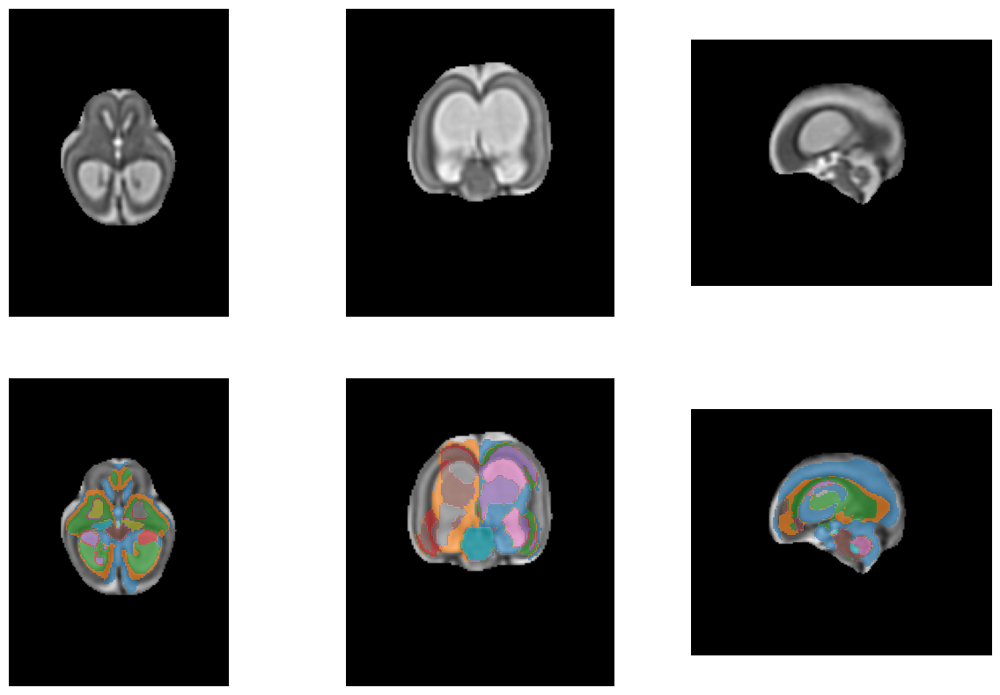

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-295/ses-01/anat/sub-295_ses-01_acq-haste_res-0p8_run-qc0508_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-295/ses-01/anat/sub-295_ses-01_acq-haste_res-0p8_run-qc0508_dseg.nii.gz
Sub 295 -- qcglobal: 1.25 -- thresh_pred: 0.445
Is reco: 1.0 -- geom_artefact: 1.75 -- recon_artefact: 1.5
Noise: 1.3 -- intensity_gm: 0.7 -- intensity_dgm: 0.65


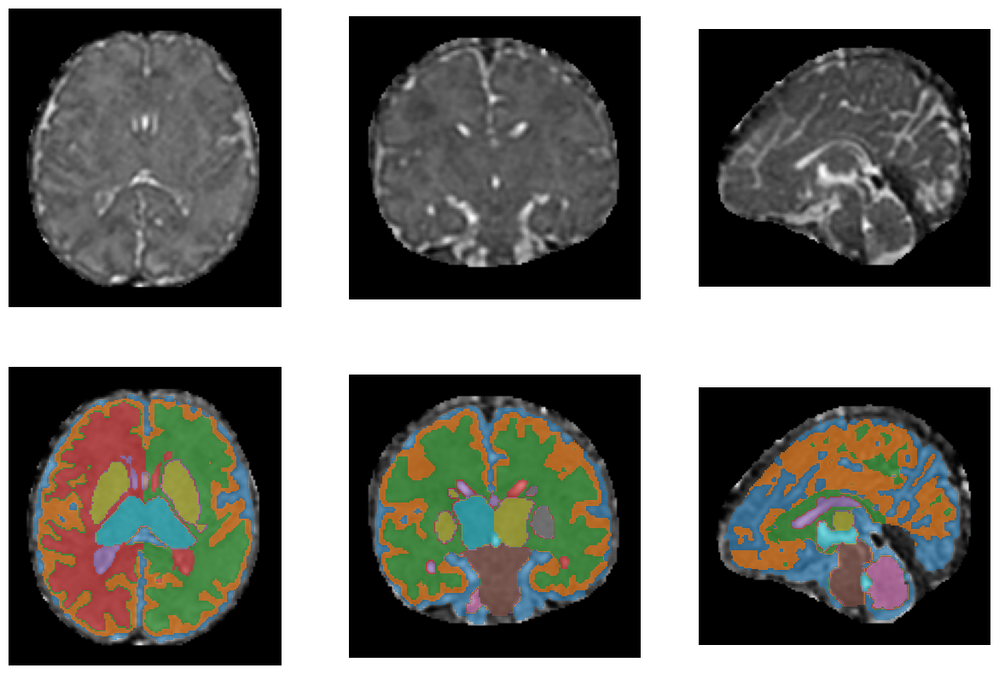

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv109/ses-01/anat/sub-chuv109_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv109/ses-01/anat/sub-chuv109_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv109 -- qcglobal: 2.1 -- thresh_pred: 0.44700000000000006
Is reco: 0.0 -- geom_artefact: 2.55 -- recon_artefact: 1.45
Noise: 2.15 -- intensity_gm: 0.9 -- intensity_dgm: 1.8


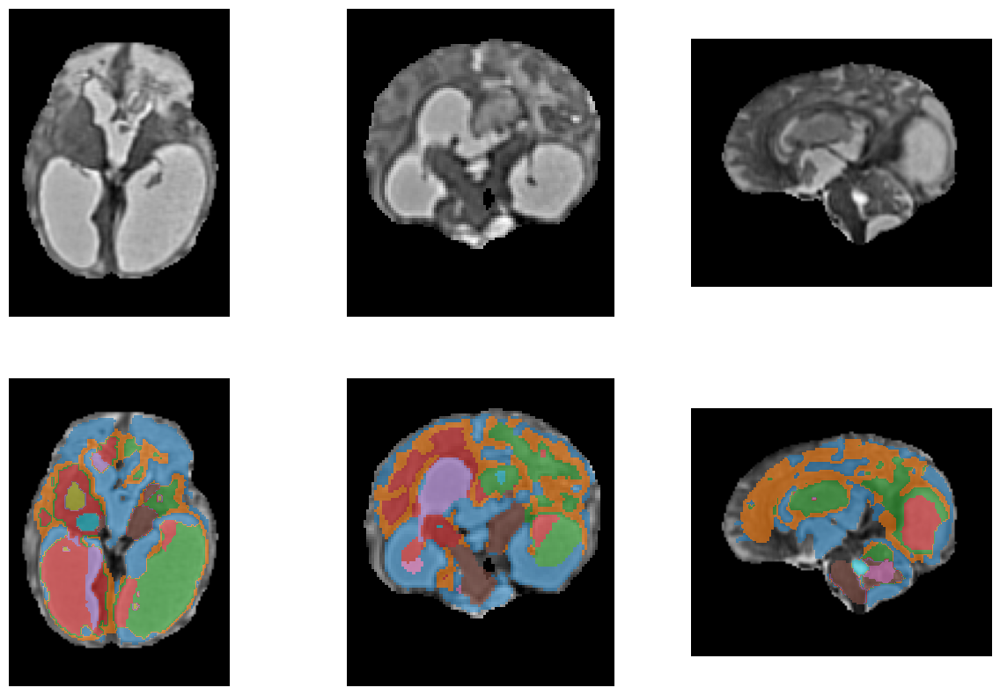

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/mialsrtk/pymialsrtk-2.1.0/sub-chuv206/ses-01/anat/sub-chuv206_ses-01_rec-SR_id-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv206/ses-01/anat/sub-chuv206_ses-01_rec-SR_id-2_dseg.nii.gz
Sub chuv206 -- qcglobal: 1.35 -- thresh_pred: 0.45600000000000007
Is reco: 1.0 -- geom_artefact: 2.2 -- recon_artefact: 1.5
Noise: 0.75 -- intensity_gm: 1.45 -- intensity_dgm: 0.85


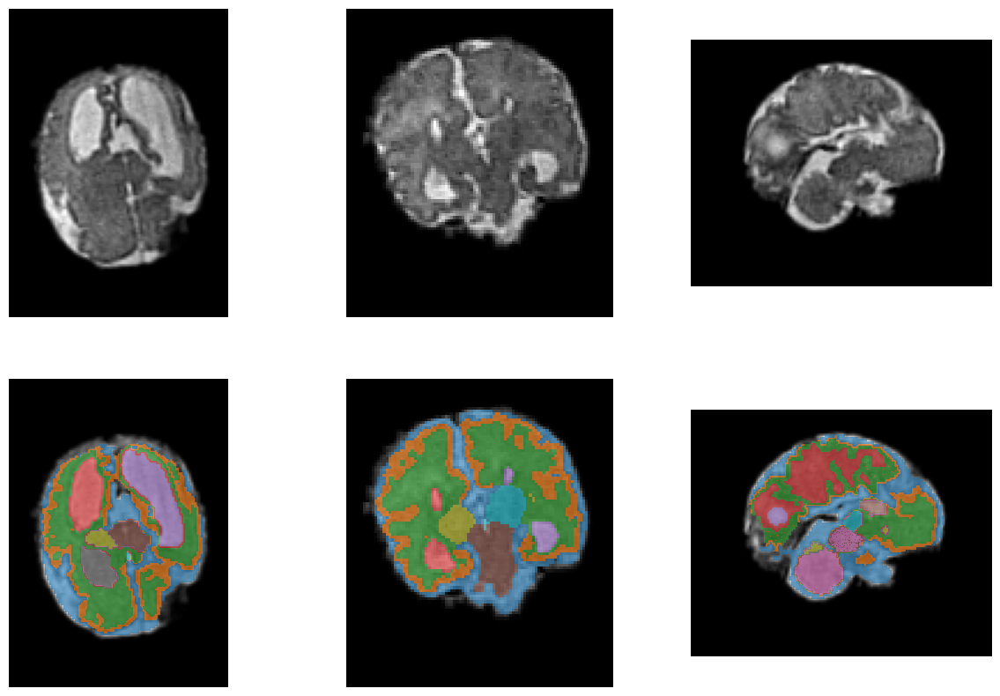

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_0p8/niftymic/sub-102/ses-01/anat/sub-102_ses-01_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-102/ses-01/anat/sub-102_ses-01_dseg.nii.gz
Sub 102 -- qcglobal: 1.1 -- thresh_pred: 0.46299999999999997
Is reco: 1.0 -- geom_artefact: 0.8 -- recon_artefact: 1.95
Noise: 0.9 -- intensity_gm: 0.95 -- intensity_dgm: 1.6


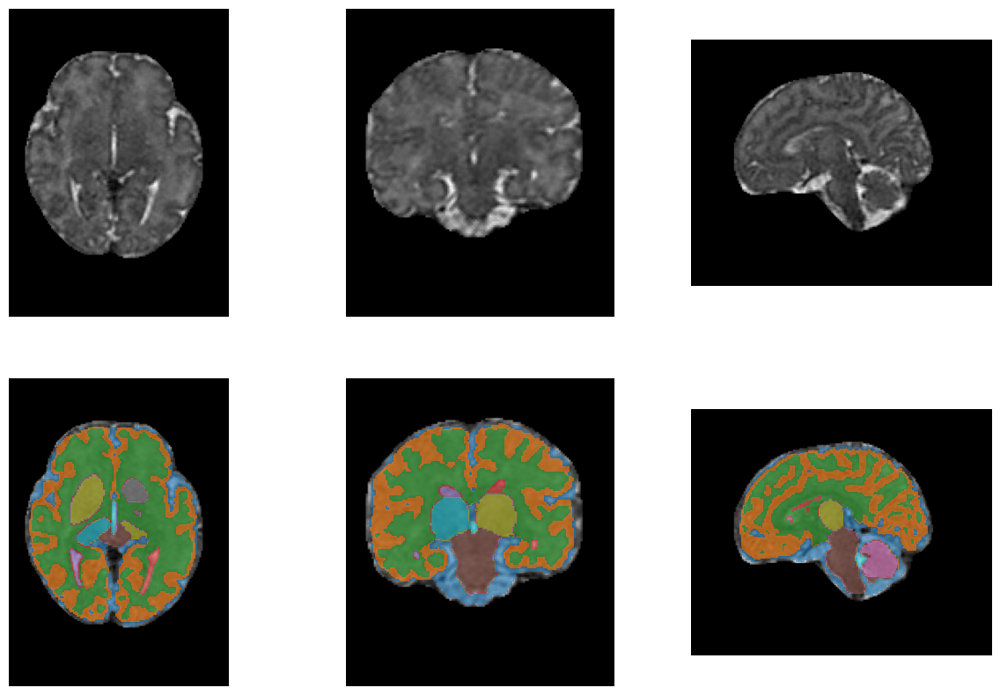

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8_v2/nesvor/sub-chuv060/ses-01/anat/sub-chuv060_ses-01_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv060/ses-01/anat/sub-chuv060_ses-01_res-0p8_run-all_dseg.nii.gz
Sub chuv060 -- qcglobal: 1.95 -- thresh_pred: 0.46699999999999997
Is reco: 1.0 -- geom_artefact: 1.25 -- recon_artefact: 1.6
Noise: 1.9 -- intensity_gm: 1.1 -- intensity_dgm: 0.75


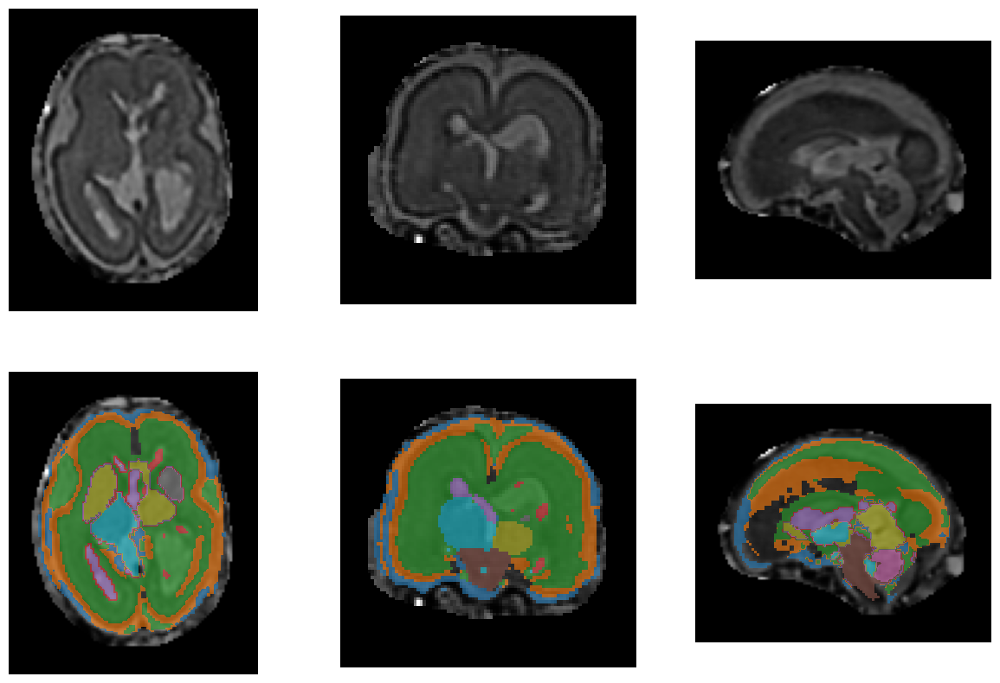

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv186/ses-01/anat/sub-chuv186_ses-01_run-1_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv186/ses-01/anat/sub-chuv186_ses-01_run-1_rec-niftymic_dseg.nii.gz
Sub chuv186 -- qcglobal: 1.7 -- thresh_pred: 0.47400000000000003
Is reco: 1.0 -- geom_artefact: 1.4 -- recon_artefact: 1.05
Noise: 2.1 -- intensity_gm: 0.9 -- intensity_dgm: 0.55


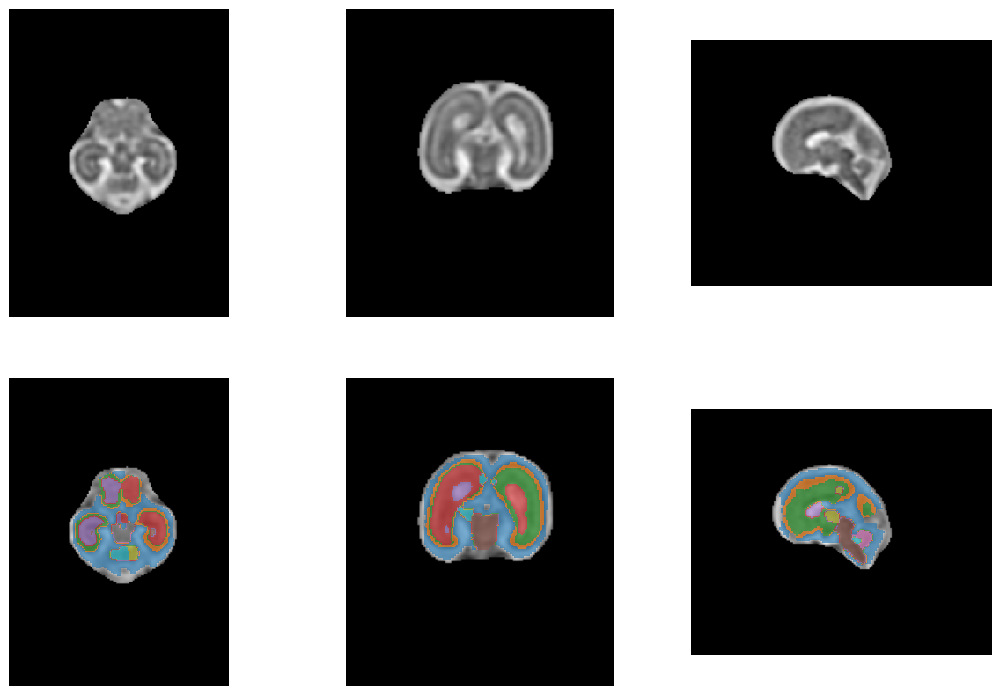

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv176/ses-01/anat/sub-chuv176_ses-01_run-1_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv176/ses-01/anat/sub-chuv176_ses-01_run-1_rec-niftymic_dseg.nii.gz
Sub chuv176 -- qcglobal: 1.9 -- thresh_pred: 0.47400000000000003
Is reco: 1.0 -- geom_artefact: 1.95 -- recon_artefact: 2.5
Noise: 1.6 -- intensity_gm: 0.95 -- intensity_dgm: 1.05


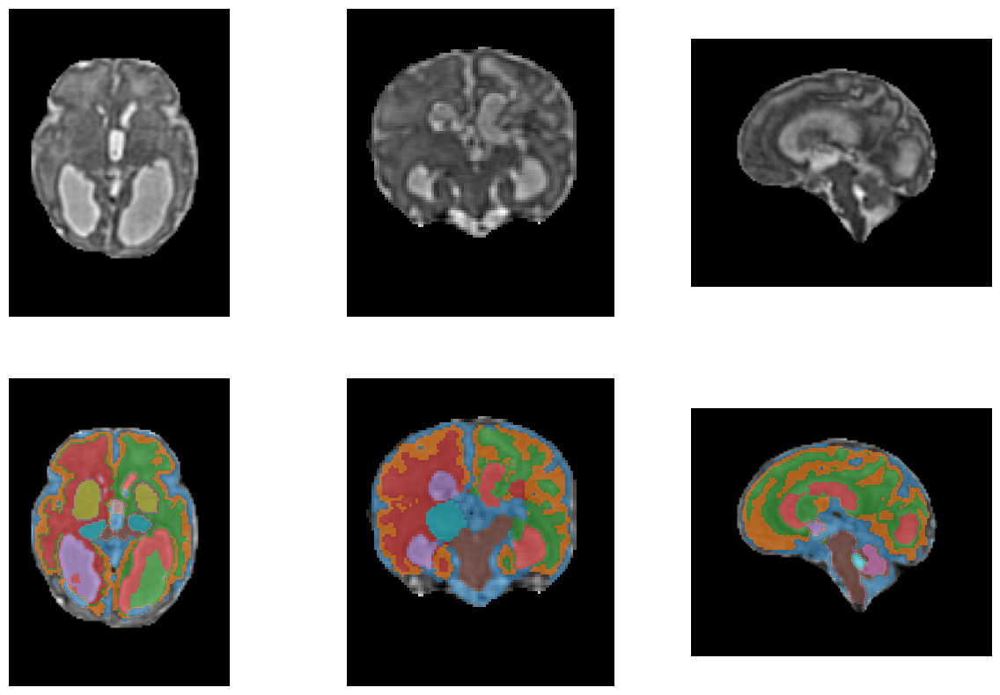

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-kispi037/anat/sub-kispi037_res-0p8_run-1_rec-nesvor_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi037/anat/sub-kispi037_res-0p8_run-1_rec-nesvor_dseg.nii.gz
Sub kispi037 -- qcglobal: 1.1 -- thresh_pred: 0.475
Is reco: 1.0 -- geom_artefact: 0.55 -- recon_artefact: 1.5
Noise: 1.3 -- intensity_gm: 1.6 -- intensity_dgm: 0.75


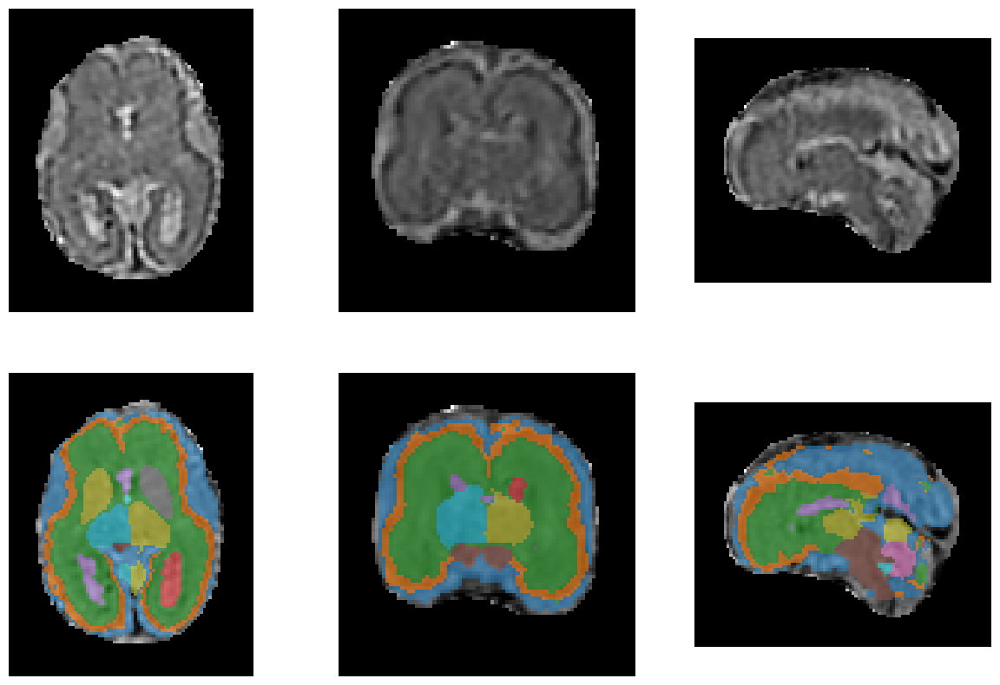

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-kispi2011/ses-None/anat/sub-kispi2011_ses-None_acq-haste_res-0p8_run-qc0508_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi2011/anat/sub-kispi2011_ses-None_acq-haste_res-0p8_run-qc0508_dseg.nii.gz
Sub kispi2011 -- qcglobal: 1.1 -- thresh_pred: 0.483
Is reco: 1.0 -- geom_artefact: 1.95 -- recon_artefact: 3.1
Noise: 0.85 -- intensity_gm: 0.85 -- intensity_dgm: 0.9


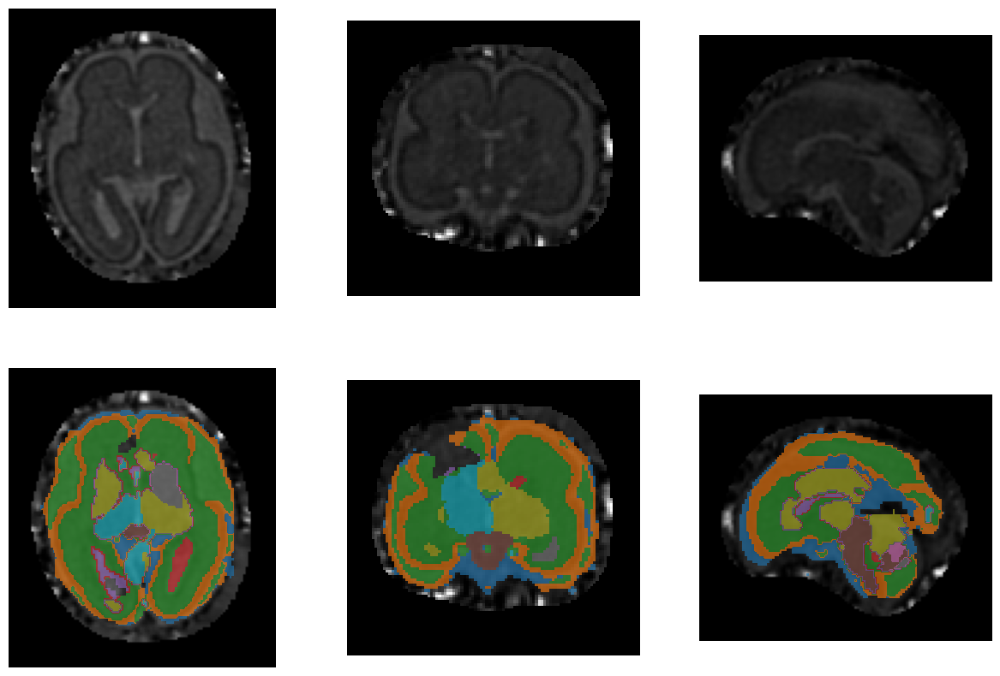

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv178/ses-01/anat/sub-chuv178_ses-01_run-2_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv178/ses-01/anat/sub-chuv178_ses-01_run-2_rec-svrtk_dseg.nii.gz
Sub chuv178 -- qcglobal: 1.5 -- thresh_pred: 0.483
Is reco: 1.0 -- geom_artefact: 1.65 -- recon_artefact: 1.2
Noise: 1.85 -- intensity_gm: 1.45 -- intensity_dgm: 0.6


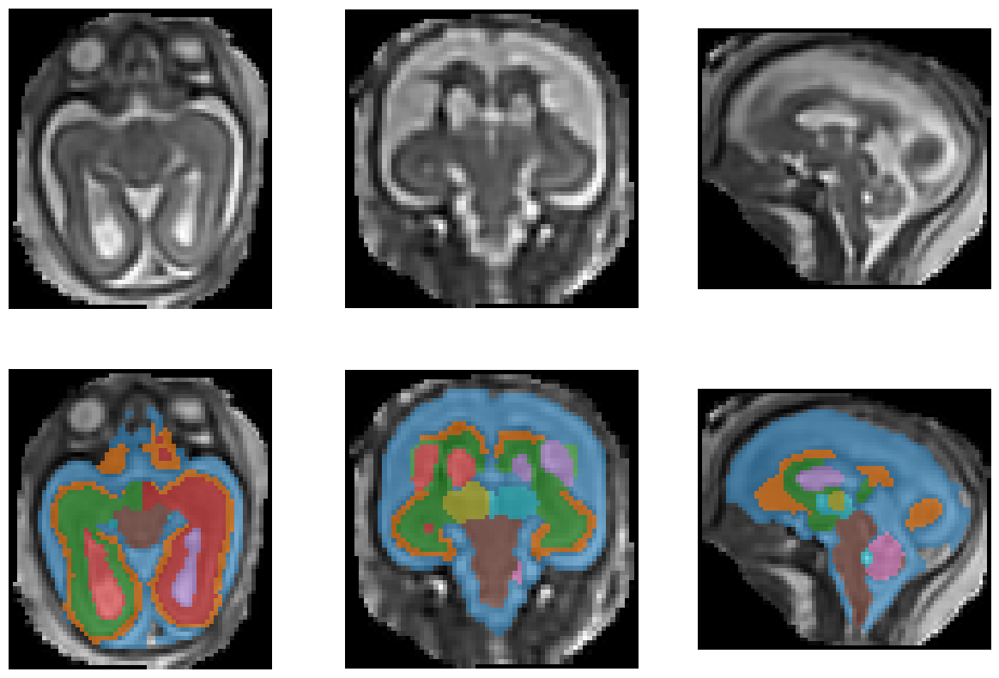

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_0p8/niftymic/sub-082/ses-01/anat/sub-082_ses-01_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-082/ses-01/anat/sub-082_ses-01_dseg.nii.gz
Sub 82 -- qcglobal: 1.6 -- thresh_pred: 0.493
Is reco: 1.0 -- geom_artefact: 1.0 -- recon_artefact: 1.45
Noise: 1.2 -- intensity_gm: 1.2 -- intensity_dgm: 1.2


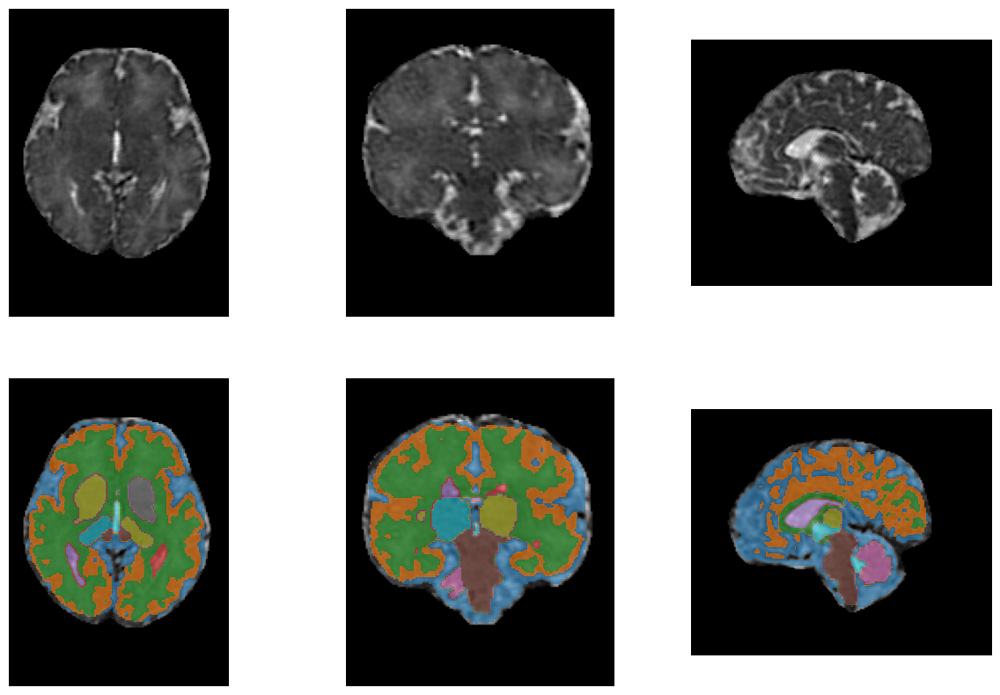

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-143/ses-01/anat/sub-143_ses-01_run-qc0505_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-143/ses-01/anat/sub-143_ses-01_run-qc0505_rec-SR_dseg.nii.gz
Sub 143 -- qcglobal: 1.9 -- thresh_pred: 0.49700000000000005
Is reco: 1.0 -- geom_artefact: 2.15 -- recon_artefact: 1.2
Noise: 1.6 -- intensity_gm: 1.05 -- intensity_dgm: 1.85


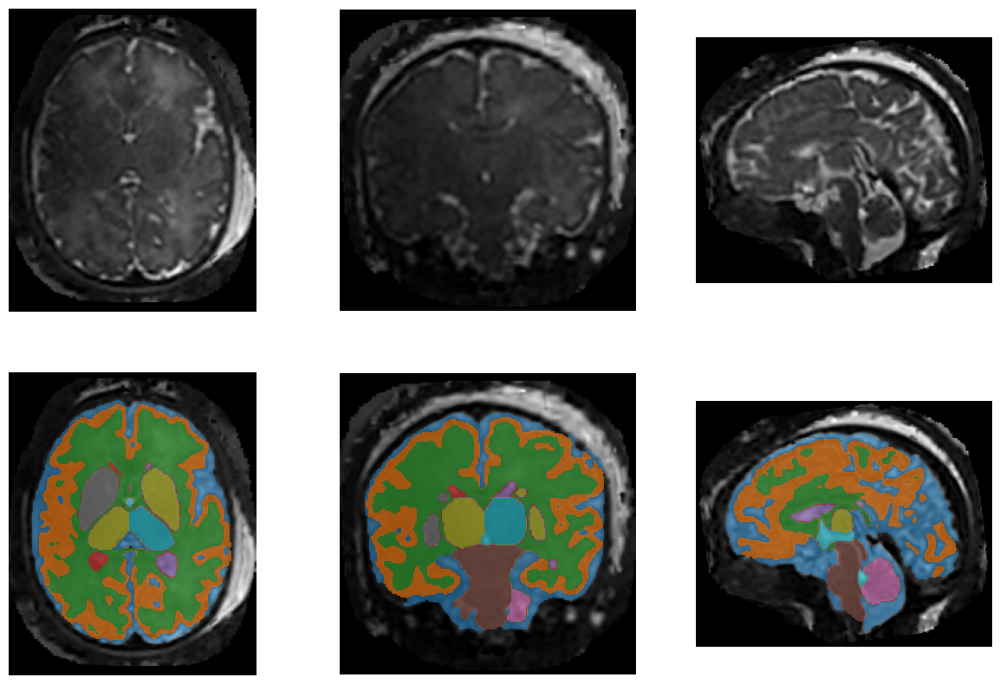

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor_v2/sub-042/ses-01/anat/sub-042_ses-01_res-0p8_run-1_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/segmentations_new_nesvor/sub-042/ses-01/anat/sub-042_ses-01_res-0p8_run-1_dseg.nii.gz
Sub 42 -- qcglobal: 3.0 -- thresh_pred: 0.513
Is reco: 1.0 -- geom_artefact: 3.0 -- recon_artefact: 3.4
Noise: 1.9 -- intensity_gm: 2.45 -- intensity_dgm: 2.05


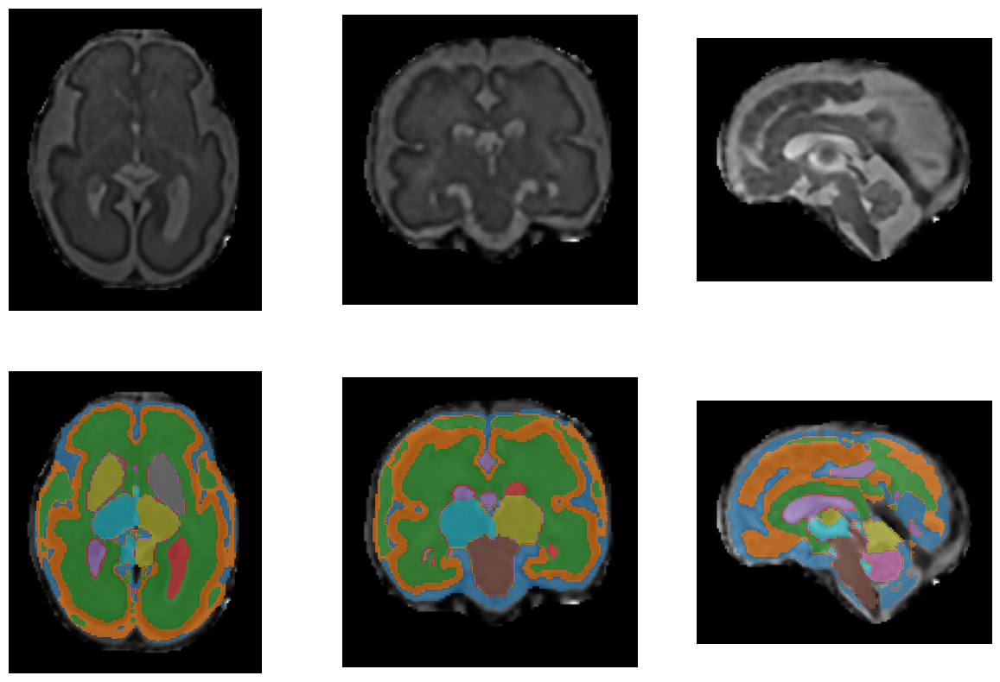

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-chuv117/ses-01/anat/sub-chuv117_ses-01_res-0p8_run-1_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv117/ses-01/anat/sub-chuv117_ses-01_res-0p8_run-1_dseg.nii.gz
Sub chuv117 -- qcglobal: 1.2 -- thresh_pred: 0.517
Is reco: 1.0 -- geom_artefact: 1.3 -- recon_artefact: 0.4
Noise: 1.05 -- intensity_gm: 0.45 -- intensity_dgm: 1.15


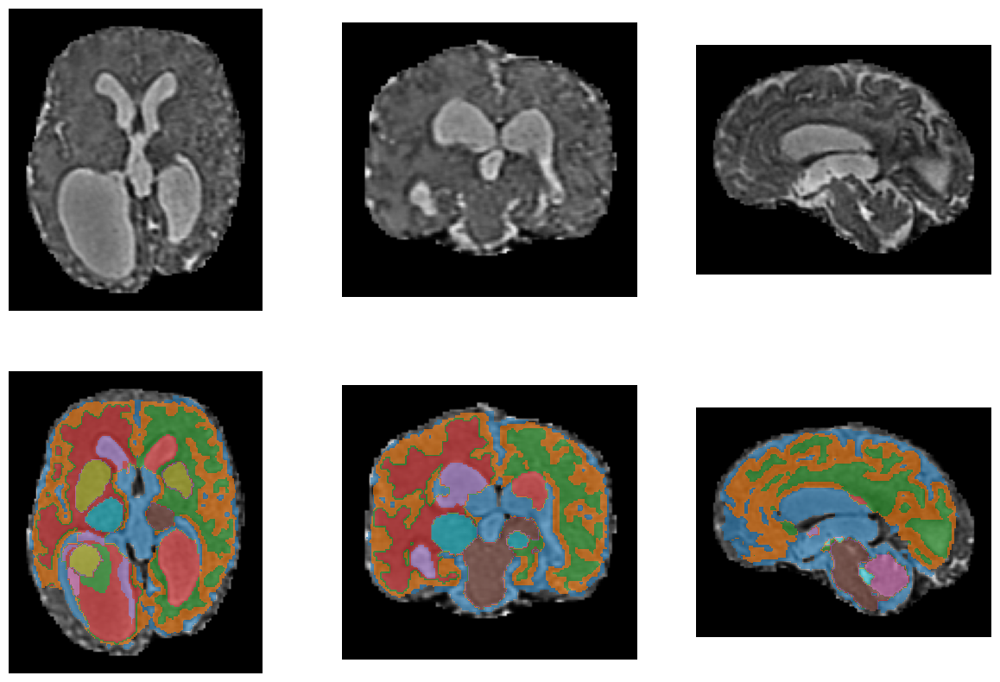

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv173/ses-01/anat/sub-chuv173_ses-01_run-1_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv173/ses-01/anat/sub-chuv173_ses-01_run-1_rec-niftymic_dseg.nii.gz
Sub chuv173 -- qcglobal: 2.65 -- thresh_pred: 0.529
Is reco: 1.0 -- geom_artefact: 2.55 -- recon_artefact: 2.6
Noise: 2.3 -- intensity_gm: 1.9 -- intensity_dgm: 1.7


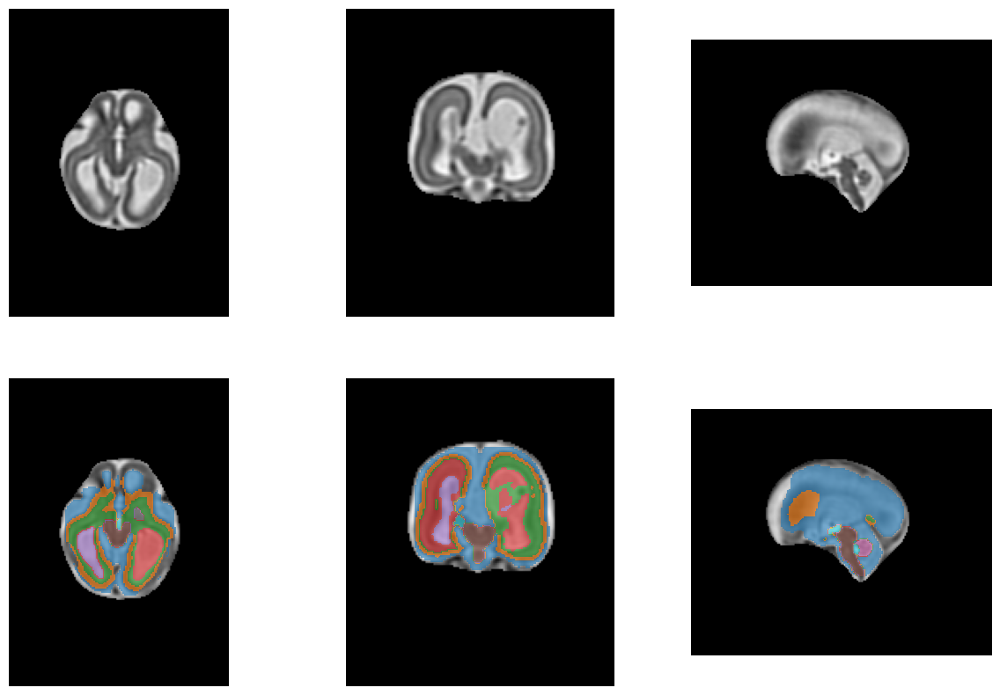

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv082/ses-01/anat/sub-chuv082_ses-01_run-2_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv082/ses-01/anat/sub-chuv082_ses-01_run-2_rec-svrtk_dseg.nii.gz
Sub chuv082 -- qcglobal: 1.55 -- thresh_pred: 0.533
Is reco: 1.0 -- geom_artefact: 1.35 -- recon_artefact: 1.3
Noise: 1.1 -- intensity_gm: 1.15 -- intensity_dgm: 0.9


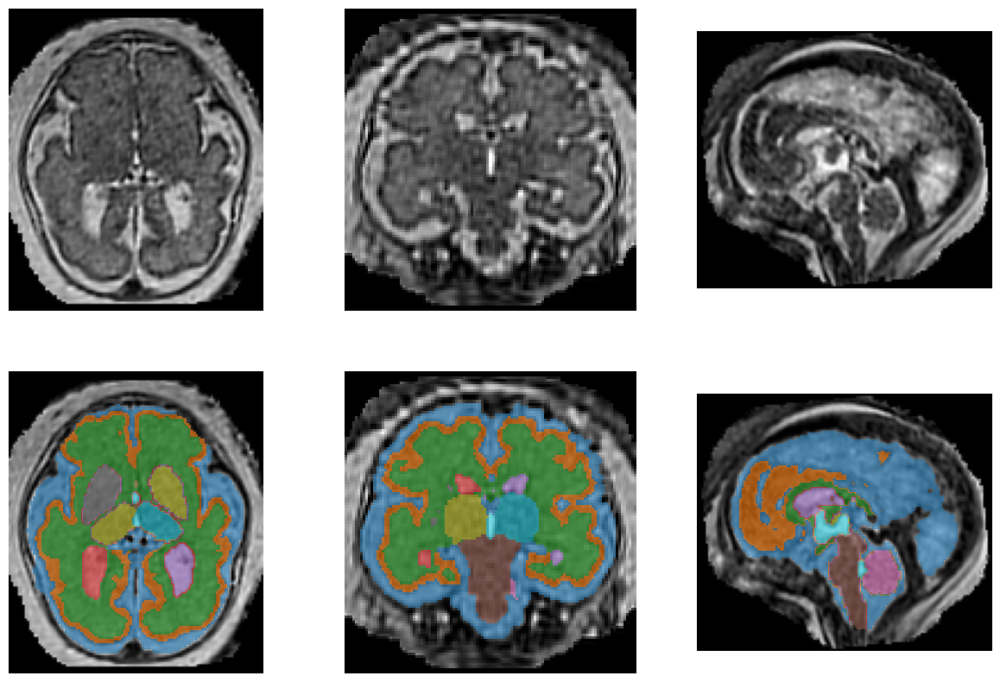

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-142/ses-01/anat/sub-142_ses-01_run-qc0505_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-142/ses-01/anat/sub-142_ses-01_run-qc0505_rec-SR_dseg.nii.gz
Sub 142 -- qcglobal: 1.4 -- thresh_pred: 0.533
Is reco: 1.0 -- geom_artefact: 1.0 -- recon_artefact: 1.1
Noise: 1.75 -- intensity_gm: 1.15 -- intensity_dgm: 1.15


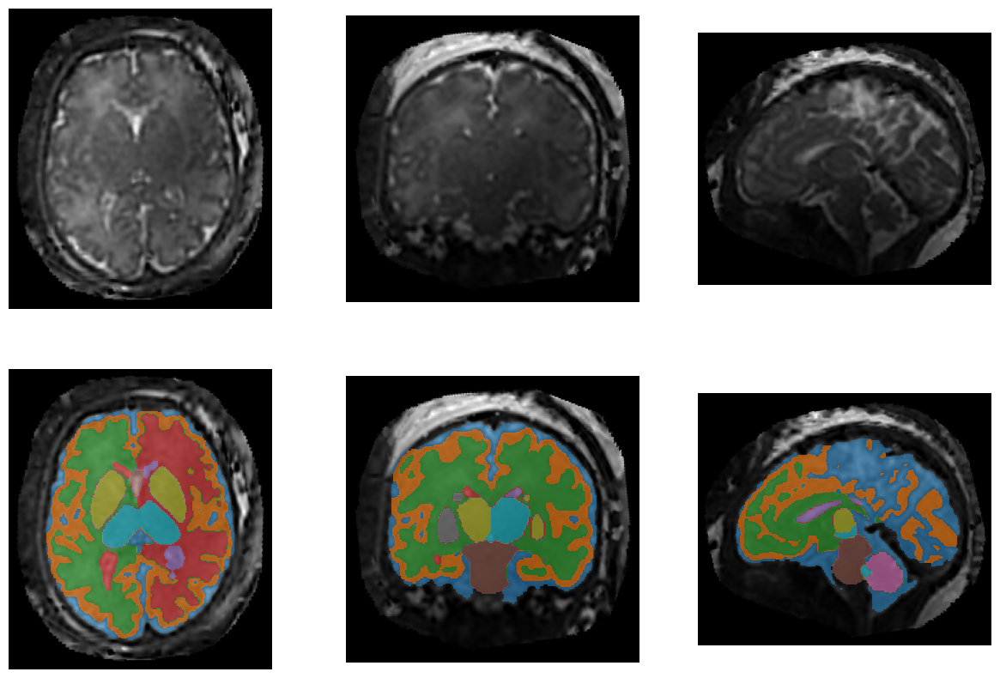

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native_v2/nesvor/sub-kispi2017/anat/sub-kispi2017_res-0p5_run-all_rec-nesvor_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi2017/anat/sub-kispi2017_res-0p5_run-all_rec-nesvor_dseg.nii.gz
Sub kispi2017 -- qcglobal: 1.6 -- thresh_pred: 0.5389999999999999
Is reco: 1.0 -- geom_artefact: 1.15 -- recon_artefact: 0.95
Noise: 2.05 -- intensity_gm: 1.5 -- intensity_dgm: 1.2


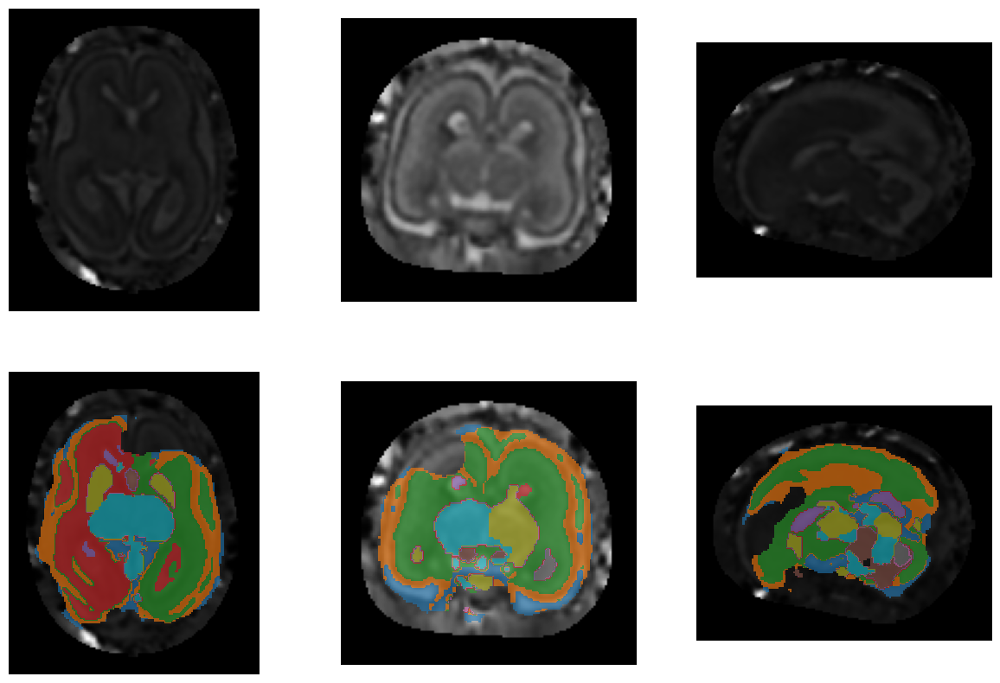

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-022/ses-01/anat/sub-022_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-022/ses-01/anat/sub-022_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub 22 -- qcglobal: 1.1 -- thresh_pred: 0.5419999999999999
Is reco: 1.0 -- geom_artefact: 0.6 -- recon_artefact: 1.9
Noise: 1.35 -- intensity_gm: 1.25 -- intensity_dgm: 1.05


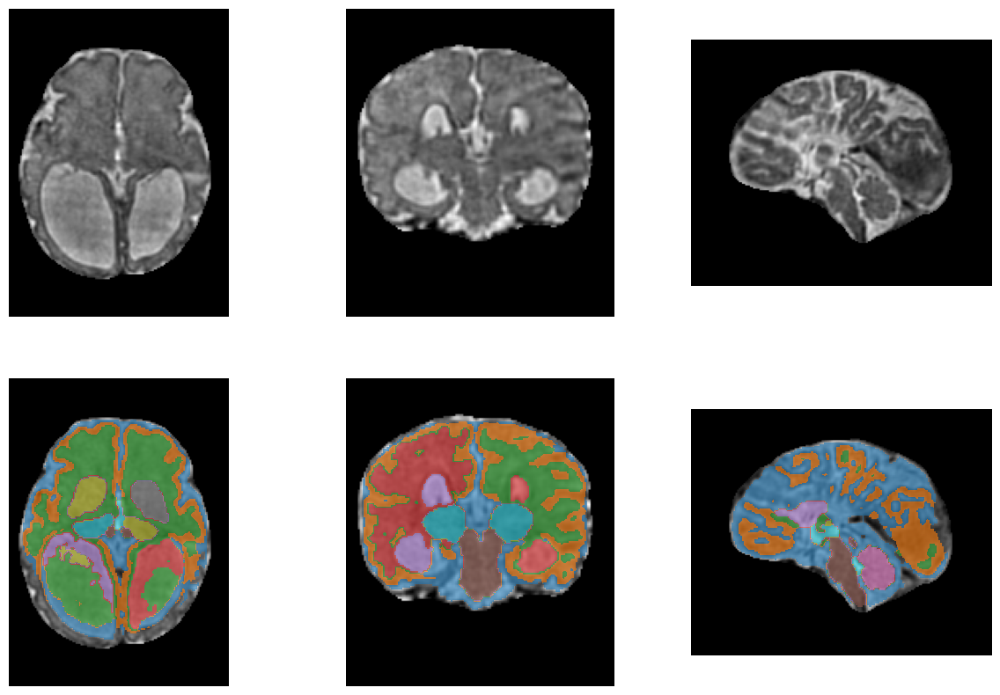

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv103/ses-01/anat/sub-chuv103_ses-01_run-1_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv103/ses-01/anat/sub-chuv103_ses-01_run-1_rec-svrtk_dseg.nii.gz
Sub chuv103 -- qcglobal: 1.6 -- thresh_pred: 0.556
Is reco: 1.0 -- geom_artefact: 0.95 -- recon_artefact: 1.55
Noise: 1.15 -- intensity_gm: 1.3 -- intensity_dgm: 1.0


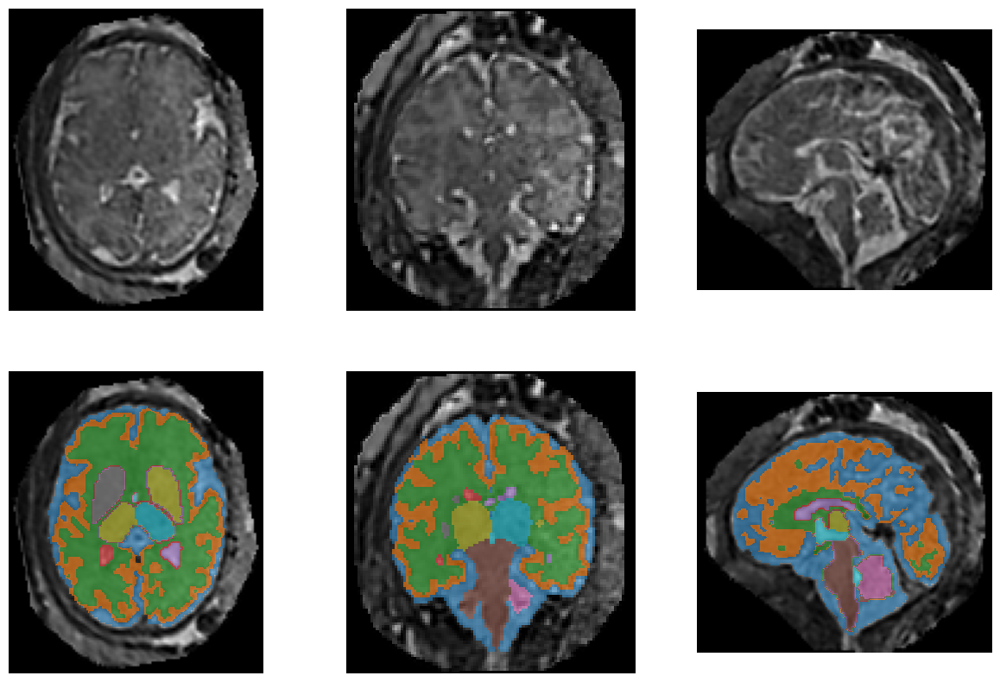

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-294/ses-01/anat/sub-294_ses-01_res-0p8_run-1_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-294/ses-01/anat/sub-294_ses-01_res-0p8_run-1_dseg.nii.gz
Sub 294 -- qcglobal: 1.45 -- thresh_pred: 0.563
Is reco: 1.0 -- geom_artefact: 1.65 -- recon_artefact: 1.2
Noise: 1.0 -- intensity_gm: 1.1 -- intensity_dgm: 1.25


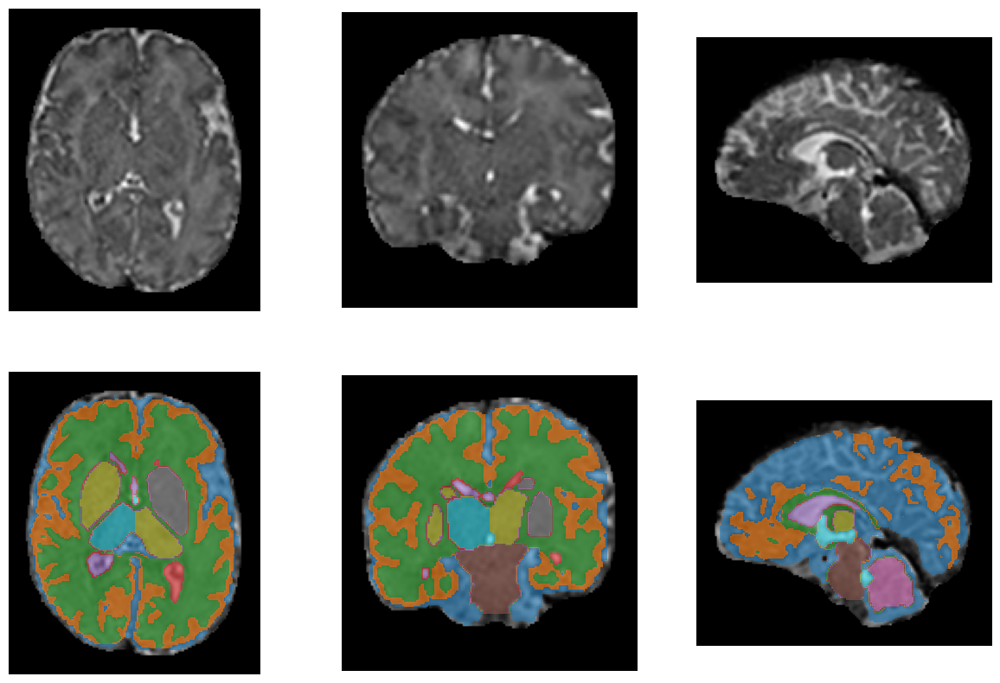

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-092/ses-01/anat/sub-092_ses-01_acq-haste_res-0p8_run-qc0508_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-092/ses-01/anat/sub-092_ses-01_acq-haste_res-0p8_run-qc0508_dseg.nii.gz
Sub 92 -- qcglobal: 2.31 -- thresh_pred: 0.564
Is reco: 1.0 -- geom_artefact: 1.9 -- recon_artefact: 1.59
Noise: 1.78 -- intensity_gm: 1.35 -- intensity_dgm: 1.33


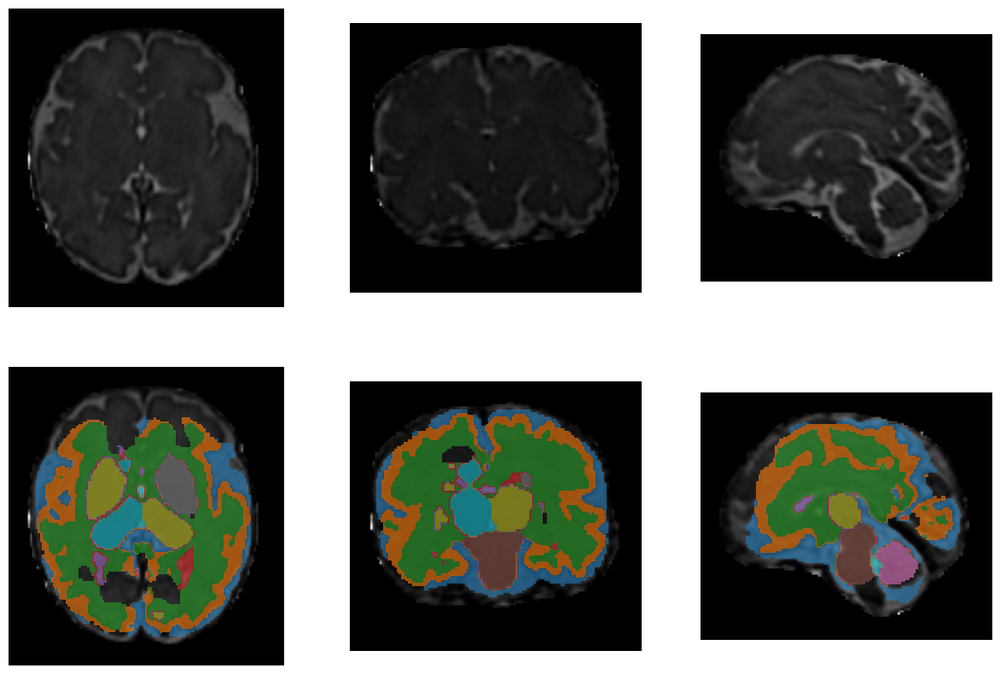

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_0p8/niftymic/sub-chuv058/ses-01/anat/sub-chuv058_ses-01_run-qc1108_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv058/ses-01/anat/sub-chuv058_ses-01_run-qc1108_SR_dseg.nii.gz
Sub chuv058 -- qcglobal: 2.25 -- thresh_pred: 0.5650000000000002
Is reco: 1.0 -- geom_artefact: 1.2 -- recon_artefact: 2.5
Noise: 1.75 -- intensity_gm: 1.65 -- intensity_dgm: 1.4


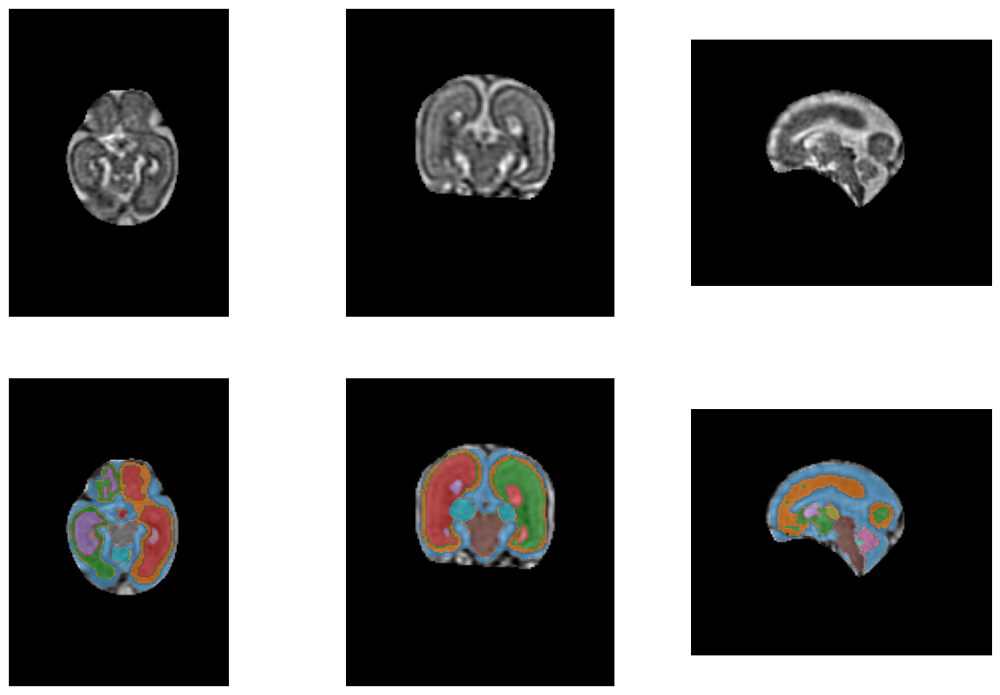

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-140/ses-01/anat/sub-140_ses-01_run-all0505_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-140/ses-01/anat/sub-140_ses-01_run-all0505_rec-SR_dseg.nii.gz
Sub 140 -- qcglobal: 1.52 -- thresh_pred: 0.571
Is reco: 1.0 -- geom_artefact: 2.22 -- recon_artefact: 1.28
Noise: 2.34 -- intensity_gm: 1.08 -- intensity_dgm: 1.38


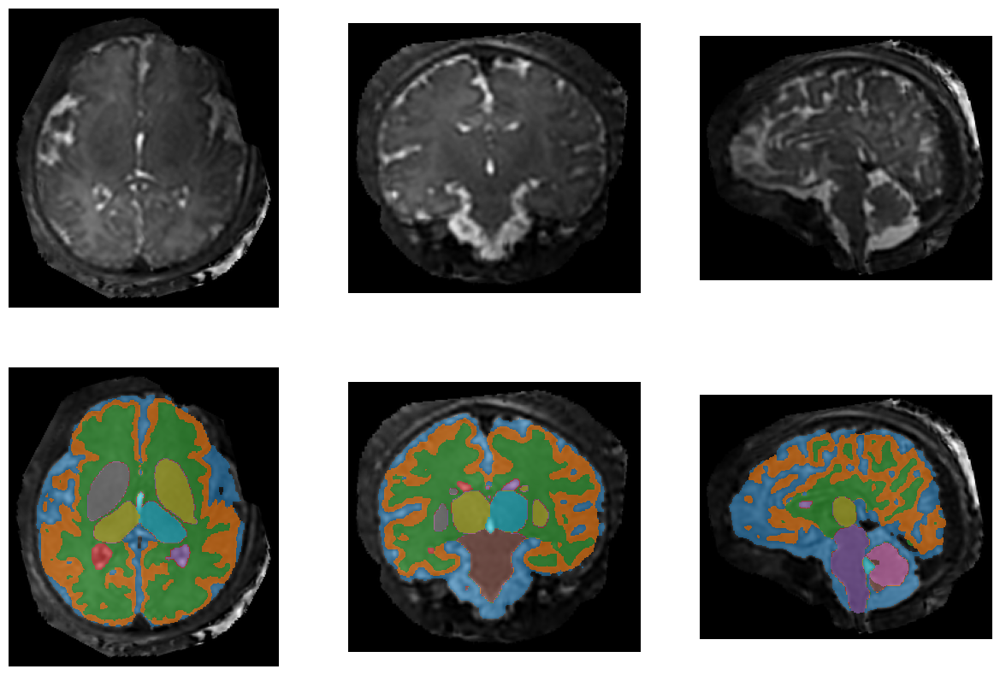

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-kispi036/anat/sub-kispi036_res-0p5_run-3_rec-nesvor_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi036/anat/sub-kispi036_res-0p5_run-3_rec-nesvor_dseg.nii.gz
Sub kispi036 -- qcglobal: 1.55 -- thresh_pred: 0.572
Is reco: 1.0 -- geom_artefact: 0.95 -- recon_artefact: 0.95
Noise: 0.9 -- intensity_gm: 1.85 -- intensity_dgm: 1.05


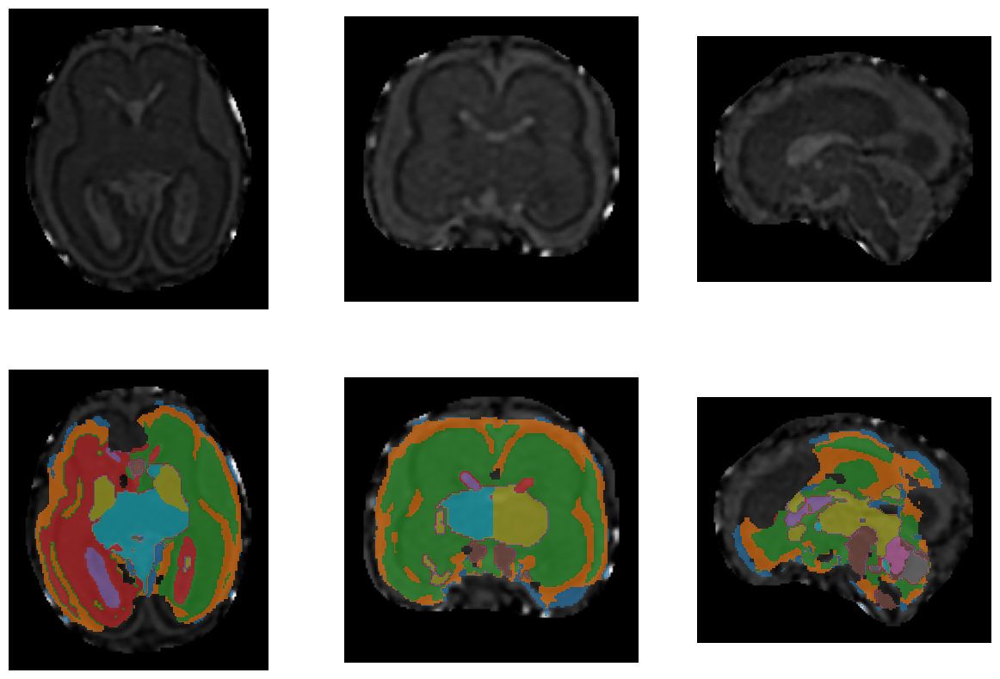

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-298/ses-01/anat/sub-298_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-298/ses-01/anat/sub-298_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub 298 -- qcglobal: 1.3 -- thresh_pred: 0.5760000000000001
Is reco: 0.0 -- geom_artefact: 2.5 -- recon_artefact: 1.05
Noise: 2.25 -- intensity_gm: 0.45 -- intensity_dgm: 1.5


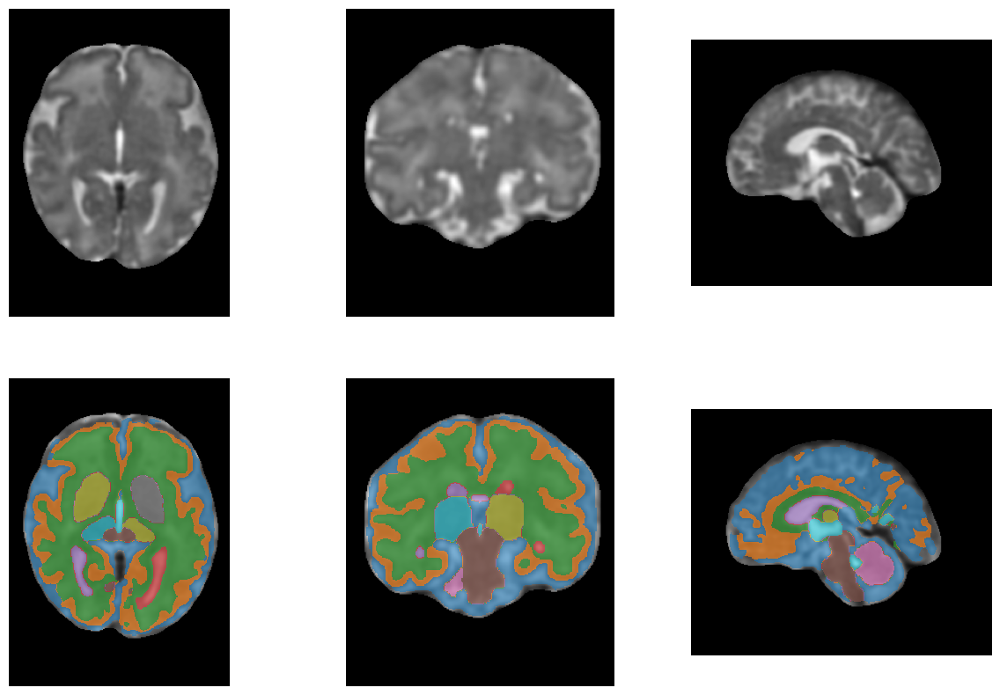

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv187/ses-01/anat/sub-chuv187_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv187/ses-01/anat/sub-chuv187_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv187 -- qcglobal: 1.35 -- thresh_pred: 0.5780000000000001
Is reco: 1.0 -- geom_artefact: 1.6 -- recon_artefact: 1.4
Noise: 2.5 -- intensity_gm: 1.15 -- intensity_dgm: 0.6


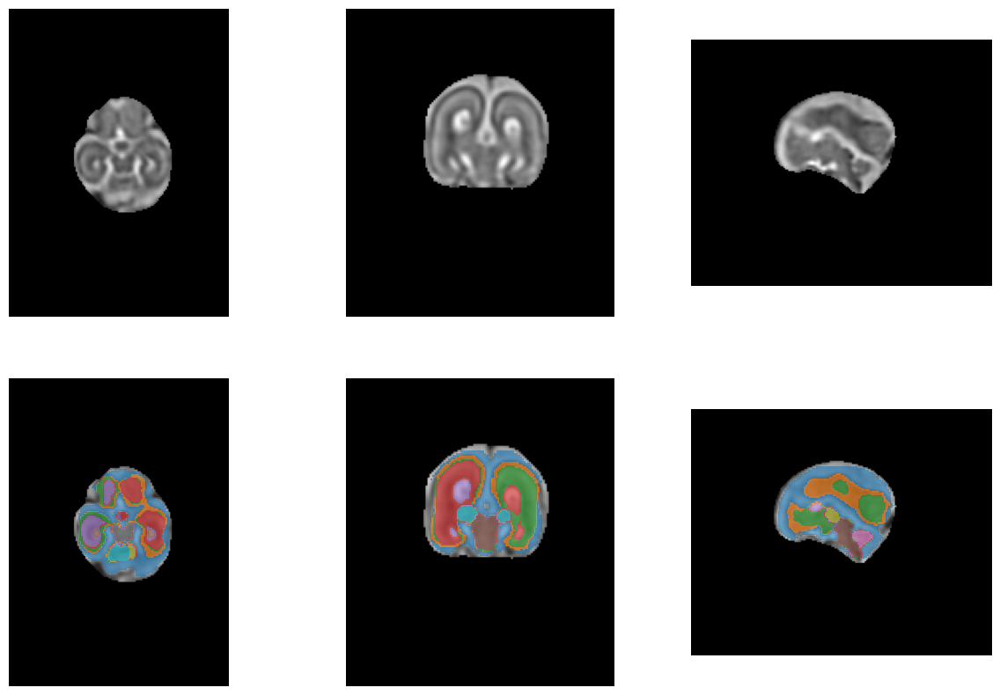

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-chuv192/ses-01/anat/sub-chuv192_ses-01_res-0p8_run-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv192/ses-01/anat/sub-chuv192_ses-01_res-0p8_run-2_dseg.nii.gz
Sub chuv192 -- qcglobal: 2.1 -- thresh_pred: 0.581
Is reco: 0.0 -- geom_artefact: 2.55 -- recon_artefact: 3.55
Noise: 2.0 -- intensity_gm: 0.9 -- intensity_dgm: 1.35


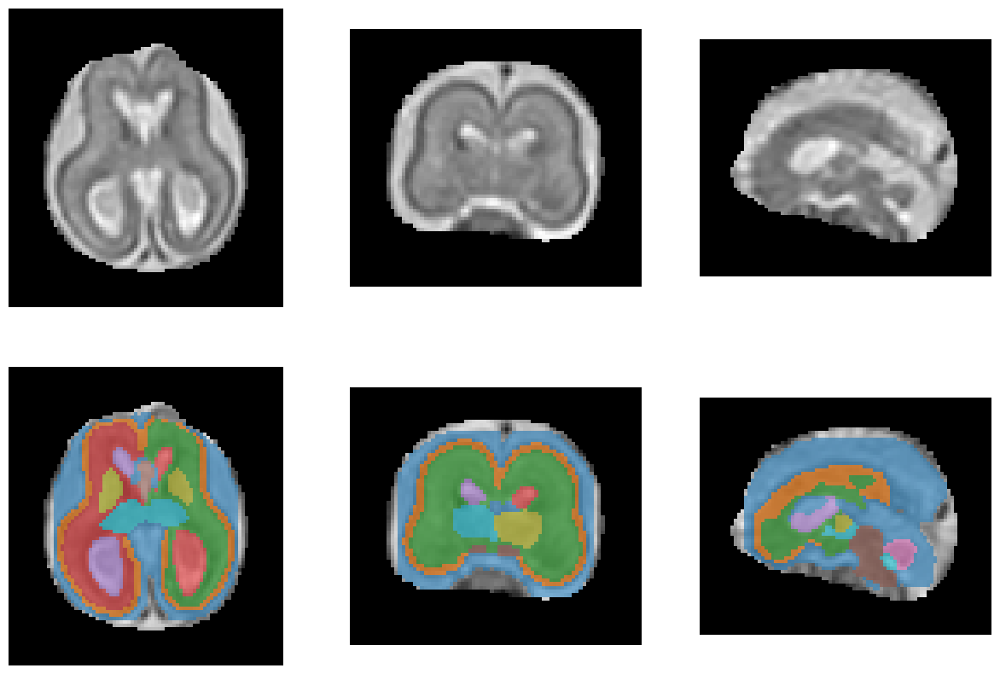

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-152/ses-01/anat/sub-152_ses-01_run-qc0508_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-152/ses-01/anat/sub-152_ses-01_run-qc0508_rec-SR_dseg.nii.gz
Sub 152 -- qcglobal: 1.7 -- thresh_pred: 0.585
Is reco: 1.0 -- geom_artefact: 2.7 -- recon_artefact: 2.55
Noise: 1.7 -- intensity_gm: 0.95 -- intensity_dgm: 1.4


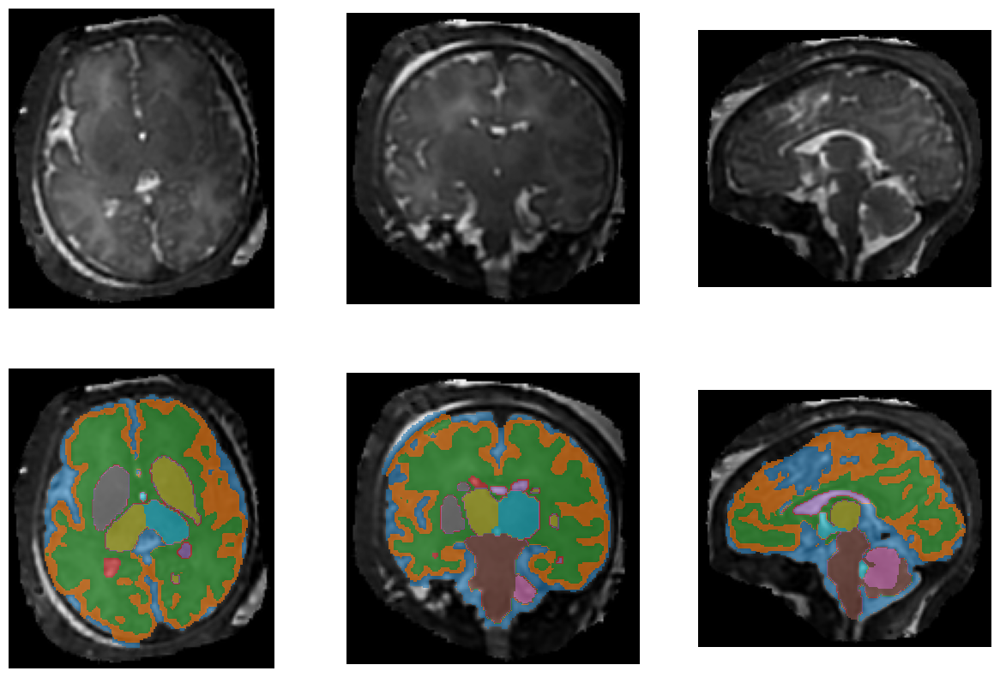

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-140/ses-01/anat/sub-140_ses-01_run-all0505_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-140/ses-01/anat/sub-140_ses-01_run-all0505_SR_dseg.nii.gz
Sub 140 -- qcglobal: 2.28 -- thresh_pred: 0.589
Is reco: 1.0 -- geom_artefact: 2.26 -- recon_artefact: 1.68
Noise: 2.25 -- intensity_gm: 1.26 -- intensity_dgm: 1.74


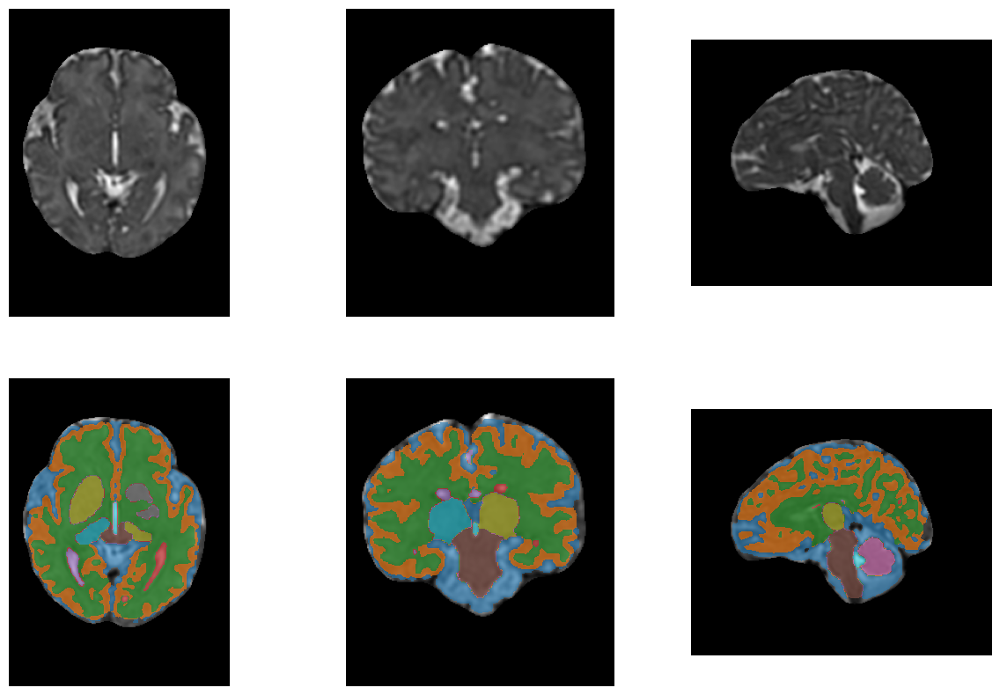

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-157/ses-01/anat/sub-157_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-157/ses-01/anat/sub-157_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 157 -- qcglobal: 1.35 -- thresh_pred: 0.596
Is reco: 1.0 -- geom_artefact: 1.5 -- recon_artefact: 1.0
Noise: 1.25 -- intensity_gm: 0.95 -- intensity_dgm: 1.35


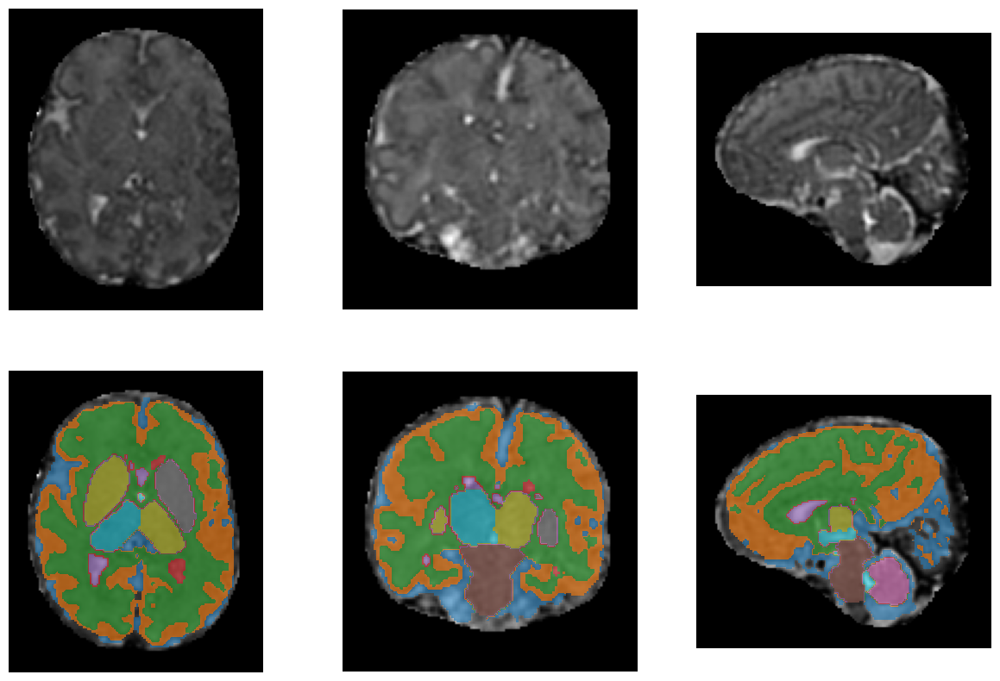

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-141/ses-01/anat/sub-141_ses-01_run-all0505_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-141/ses-01/anat/sub-141_ses-01_run-all0505_SR_dseg.nii.gz
Sub 141 -- qcglobal: 1.6 -- thresh_pred: 0.5980000000000001
Is reco: 1.0 -- geom_artefact: 1.2 -- recon_artefact: 1.15
Noise: 1.95 -- intensity_gm: 0.85 -- intensity_dgm: 1.3


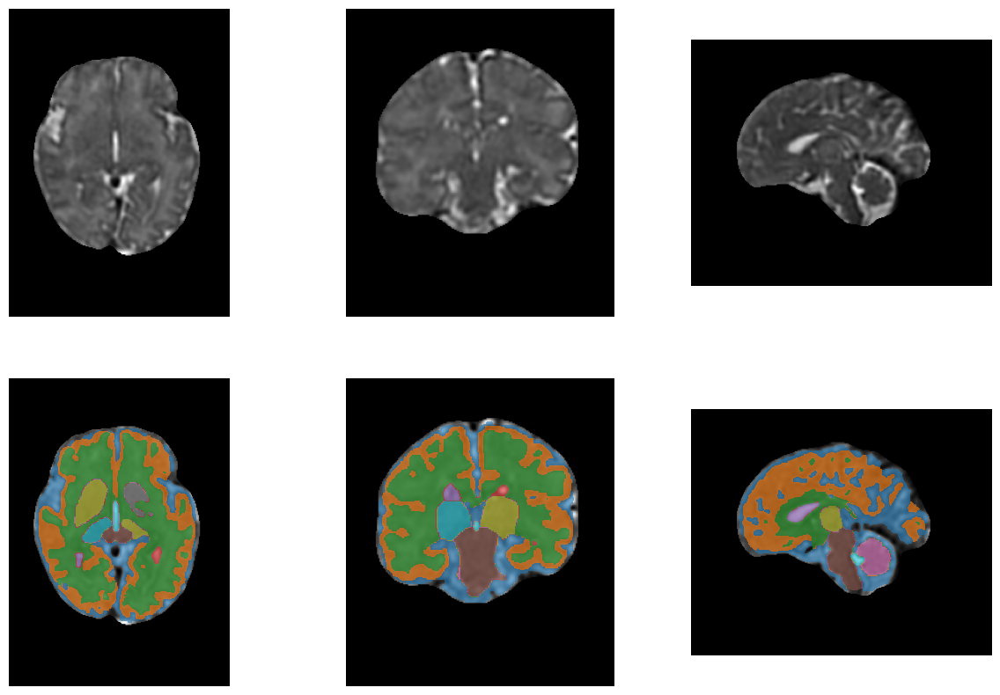

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-135/ses-01/anat/sub-135_ses-01_acq-haste_res-0p5_run-qc0505_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-135/ses-01/anat/sub-135_ses-01_acq-haste_res-0p5_run-qc0505_dseg.nii.gz
Sub 135 -- qcglobal: 2.08 -- thresh_pred: 0.6
Is reco: 1.0 -- geom_artefact: 1.93 -- recon_artefact: 1.48
Noise: 2.19 -- intensity_gm: 1.12 -- intensity_dgm: 1.67


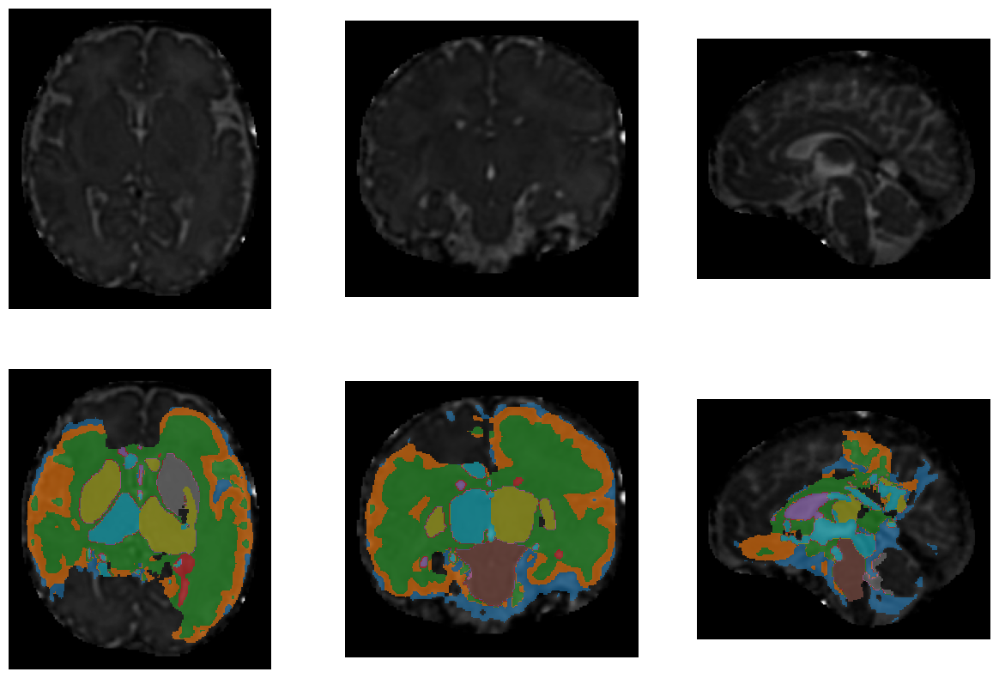

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-kispi2017/ses-None/anat/sub-kispi2017_ses-None_acq-haste_res-0p5_run-qc0505_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi2017/anat/sub-kispi2017_ses-None_acq-haste_res-0p5_run-qc0505_dseg.nii.gz
Sub kispi2017 -- qcglobal: 1.25 -- thresh_pred: 0.602
Is reco: 1.0 -- geom_artefact: 1.1 -- recon_artefact: 1.55
Noise: 0.9 -- intensity_gm: 1.0 -- intensity_dgm: 0.55


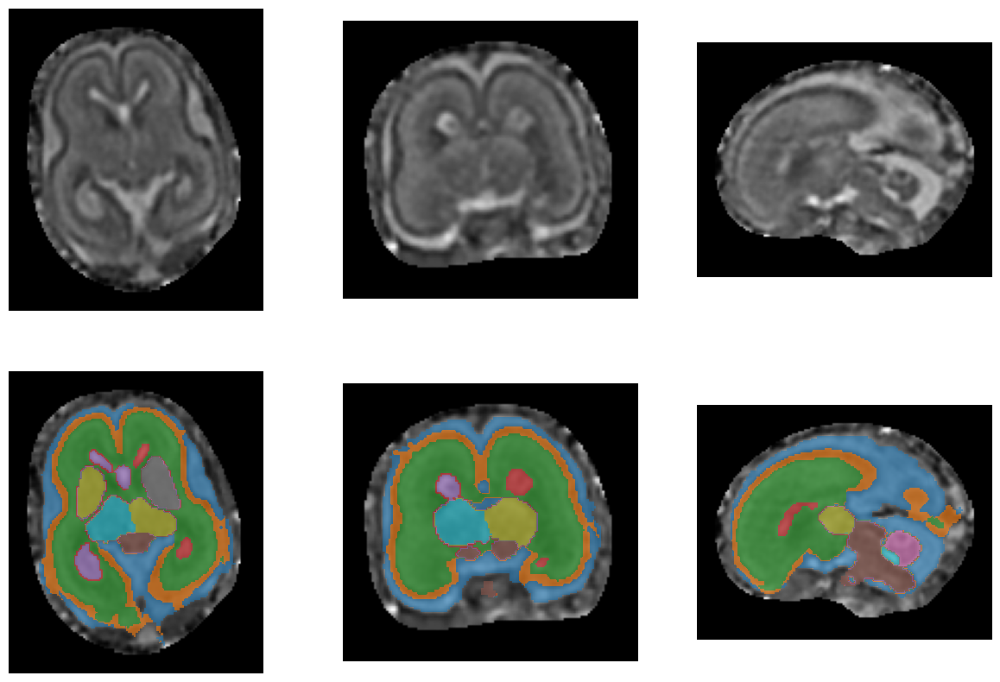

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-076/ses-01/anat/sub-076_ses-01_res-0p8_run-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-076/ses-01/anat/sub-076_ses-01_res-0p8_run-2_dseg.nii.gz
Sub 76 -- qcglobal: 1.05 -- thresh_pred: 0.6020000000000001
Is reco: 1.0 -- geom_artefact: 1.1 -- recon_artefact: 1.05
Noise: 1.05 -- intensity_gm: 0.8 -- intensity_dgm: 0.8


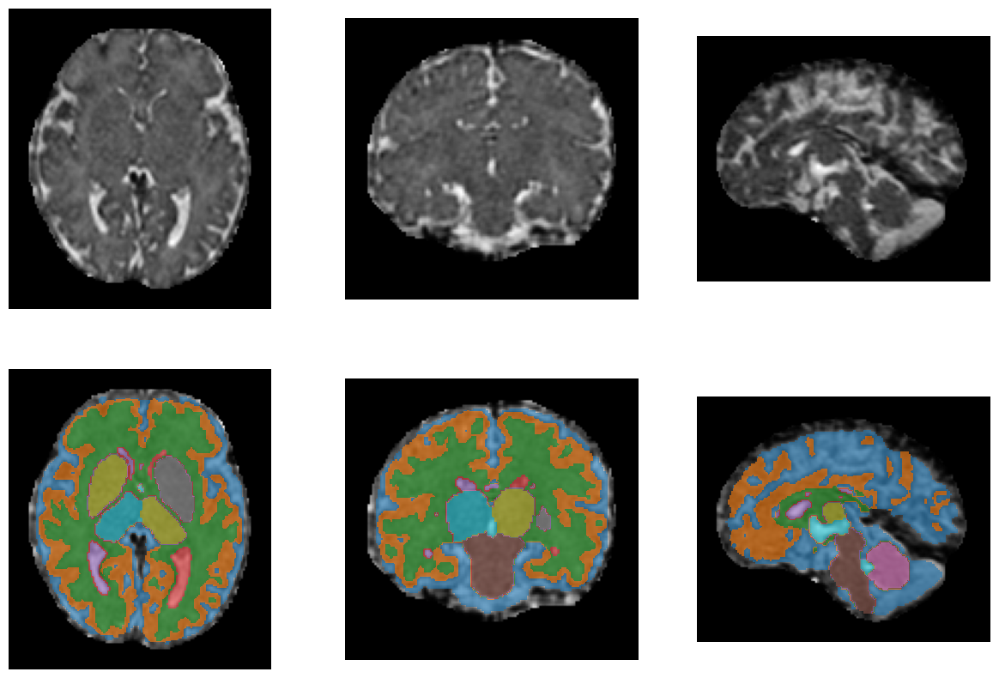

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv187/ses-01/anat/sub-chuv187_ses-01_run-1_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv187/ses-01/anat/sub-chuv187_ses-01_run-1_rec-niftymic_dseg.nii.gz
Sub chuv187 -- qcglobal: 2.95 -- thresh_pred: 0.604
Is reco: 1.0 -- geom_artefact: 2.0 -- recon_artefact: 3.6
Noise: 2.55 -- intensity_gm: 1.15 -- intensity_dgm: 2.05


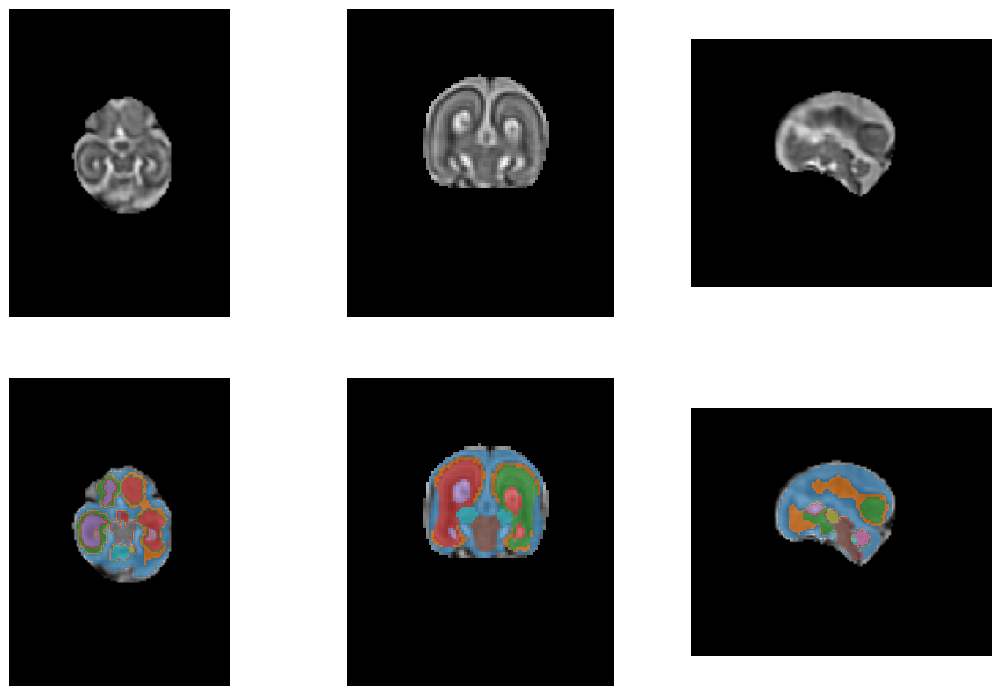

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-076/ses-01/anat/sub-076_ses-01_run-1_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-076/ses-01/anat/sub-076_ses-01_run-1_rec-svrtk_dseg.nii.gz
Sub 76 -- qcglobal: 1.5 -- thresh_pred: 0.6050000000000001
Is reco: 1.0 -- geom_artefact: 1.7 -- recon_artefact: 1.25
Noise: 1.4 -- intensity_gm: 0.9 -- intensity_dgm: 0.95


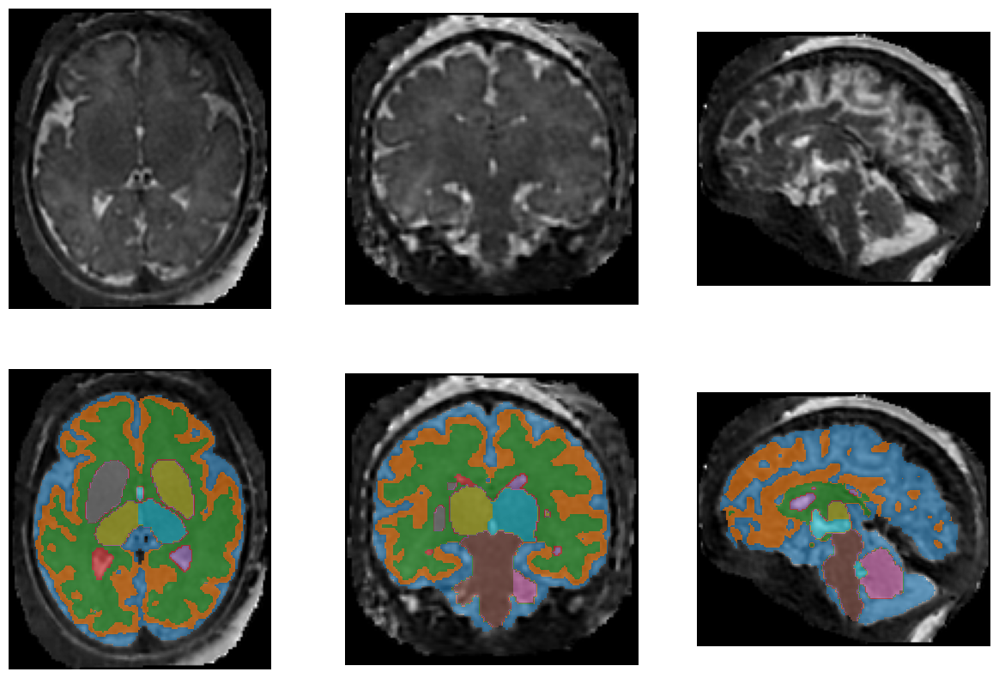

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv207/ses-01/anat/sub-chuv207_ses-01_run-2_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv207/ses-01/anat/sub-chuv207_ses-01_run-2_rec-svrtk_dseg.nii.gz
Sub chuv207 -- qcglobal: 1.55 -- thresh_pred: 0.607
Is reco: 1.0 -- geom_artefact: 1.0 -- recon_artefact: 1.5
Noise: 1.1 -- intensity_gm: 1.45 -- intensity_dgm: 0.9


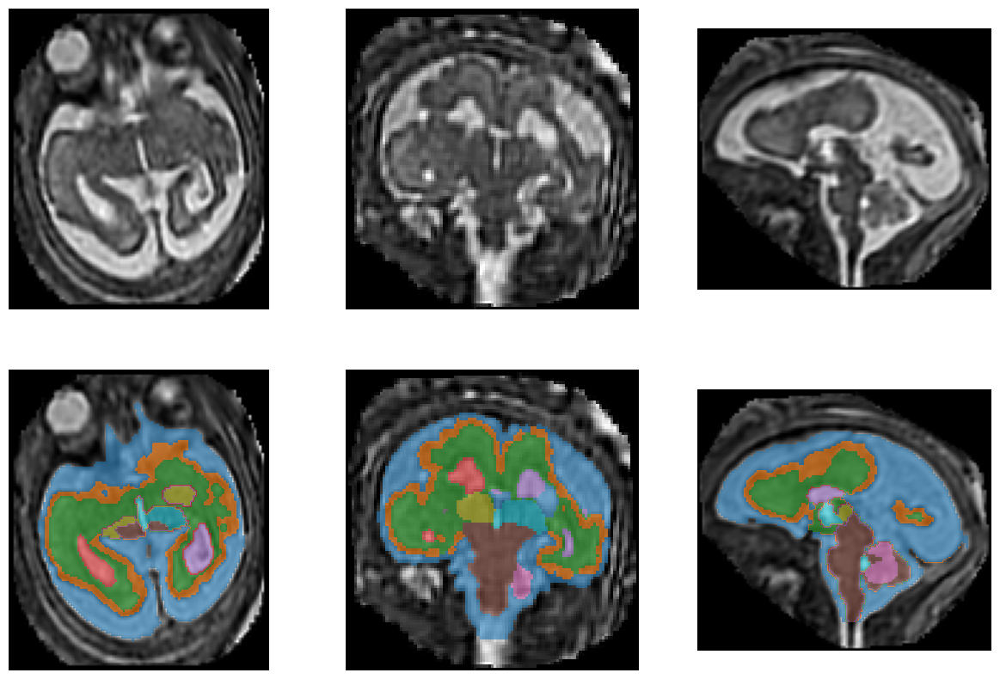

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-chuv173/ses-01/anat/sub-chuv173_ses-01_res-1p1_run-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv173/ses-01/anat/sub-chuv173_ses-01_res-1p1_run-2_dseg.nii.gz
Sub chuv173 -- qcglobal: 2.3 -- thresh_pred: 0.611
Is reco: 1.0 -- geom_artefact: 2.25 -- recon_artefact: 2.65
Noise: 1.15 -- intensity_gm: 1.75 -- intensity_dgm: 1.0


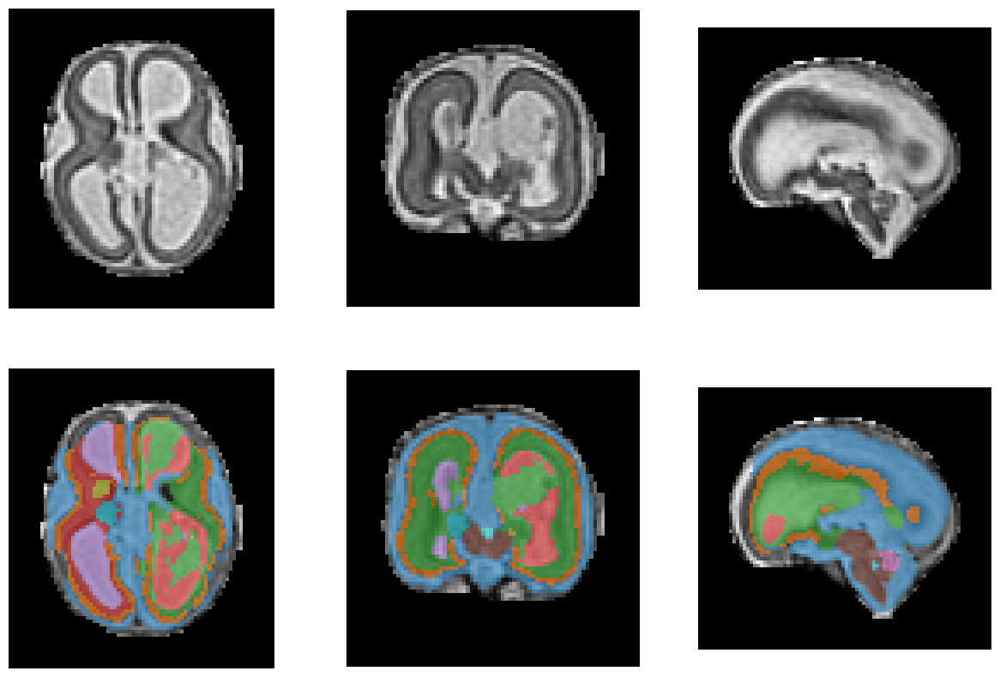

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-142/ses-01/anat/sub-142_ses-01_run-qc0505_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-142/ses-01/anat/sub-142_ses-01_run-qc0505_SR_dseg.nii.gz
Sub 142 -- qcglobal: 1.85 -- thresh_pred: 0.613
Is reco: 1.0 -- geom_artefact: 1.35 -- recon_artefact: 1.15
Noise: 1.55 -- intensity_gm: 1.1 -- intensity_dgm: 1.75


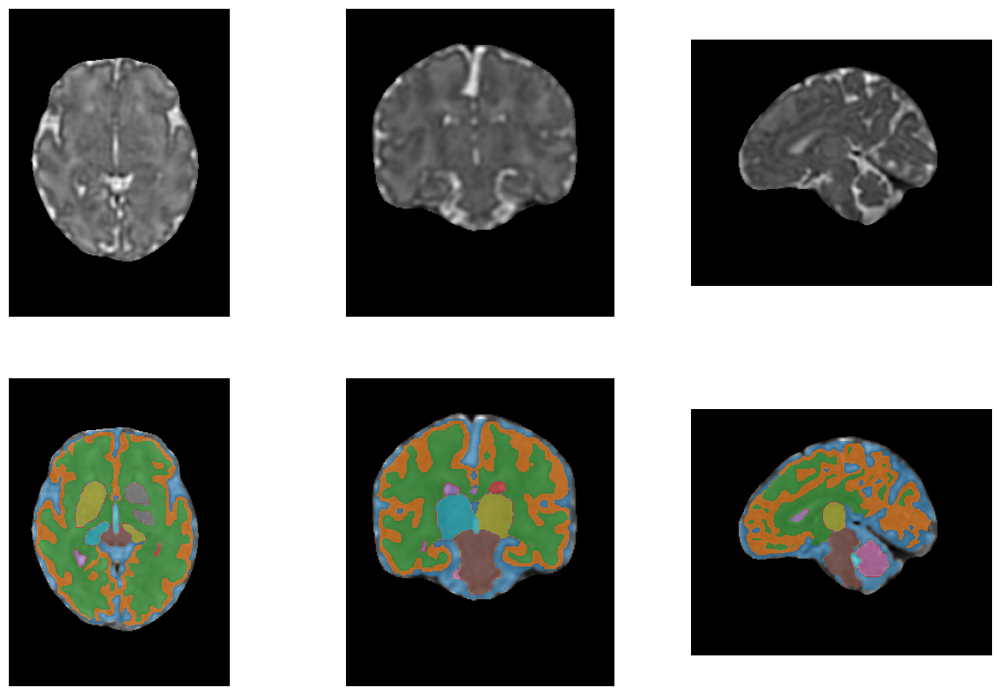

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv111/ses-01/anat/sub-chuv111_ses-01_run-1_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv111/ses-01/anat/sub-chuv111_ses-01_run-1_rec-svrtk_dseg.nii.gz
Sub chuv111 -- qcglobal: 2.25 -- thresh_pred: 0.618
Is reco: 1.0 -- geom_artefact: 2.05 -- recon_artefact: 1.3
Noise: 1.8 -- intensity_gm: 1.2 -- intensity_dgm: 1.4


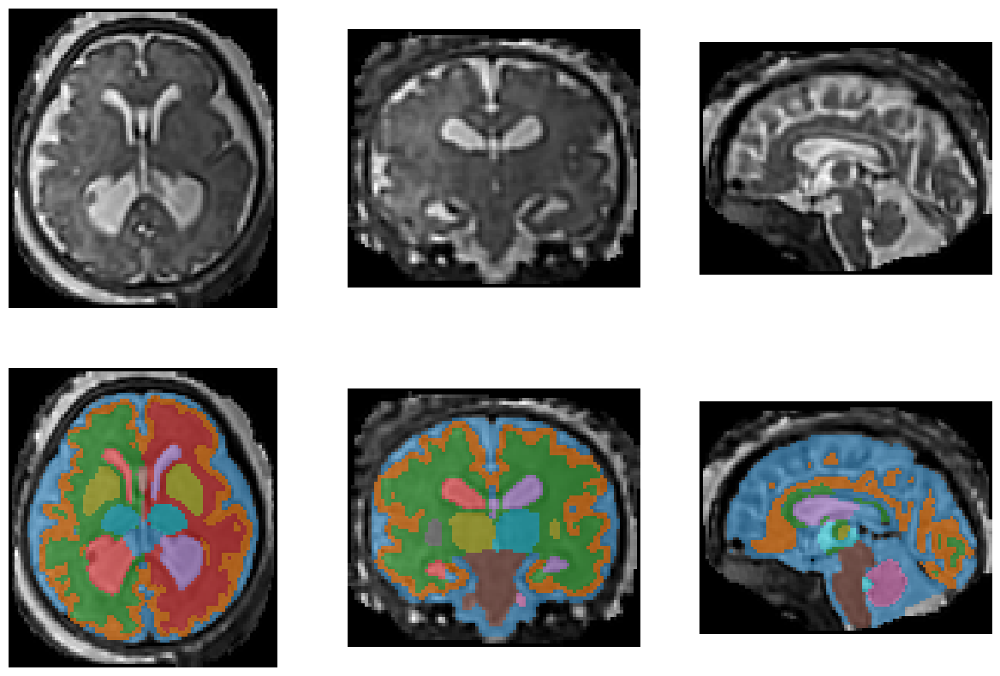

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-chuv226/ses-01/anat/sub-chuv226_ses-01_run-2_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv226/ses-01/anat/sub-chuv226_ses-01_run-2_rec-niftymic_dseg.nii.gz
Sub chuv226 -- qcglobal: 2.25 -- thresh_pred: 0.6209999999999999
Is reco: 1.0 -- geom_artefact: 2.25 -- recon_artefact: 2.45
Noise: 2.05 -- intensity_gm: 1.1 -- intensity_dgm: 1.25


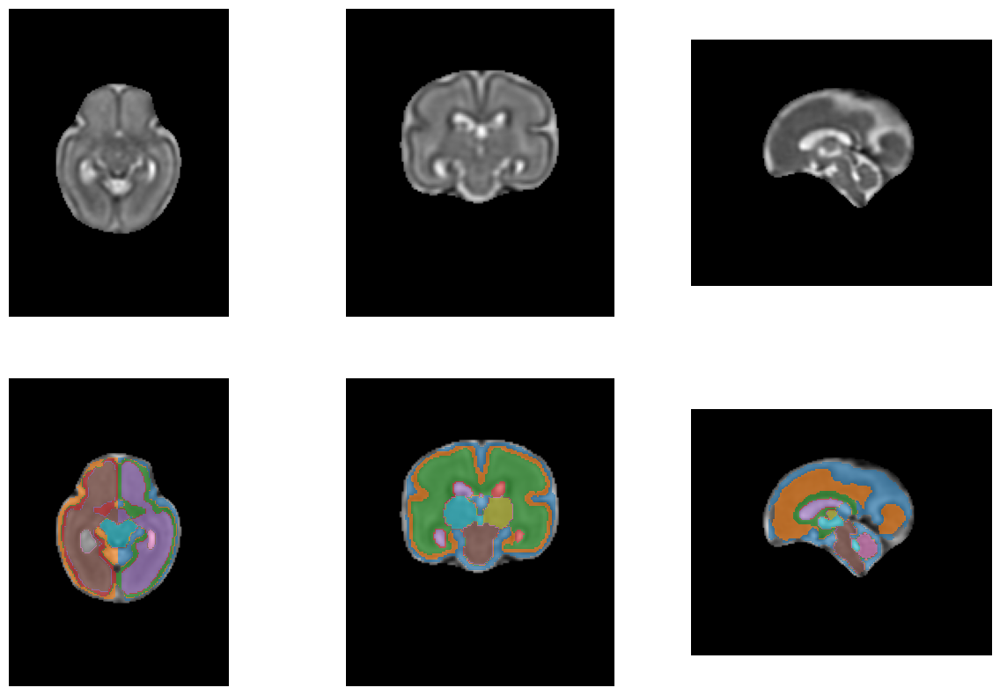

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-chuv061/ses-01/anat/sub-chuv061_ses-01_run-all0505_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv061/ses-01/anat/sub-chuv061_ses-01_run-all0505_rec-SR_dseg.nii.gz
Sub chuv061 -- qcglobal: 2.94 -- thresh_pred: 0.623
Is reco: 1.0 -- geom_artefact: 2.16 -- recon_artefact: 3.02
Noise: 2.53 -- intensity_gm: 2.18 -- intensity_dgm: 2.17


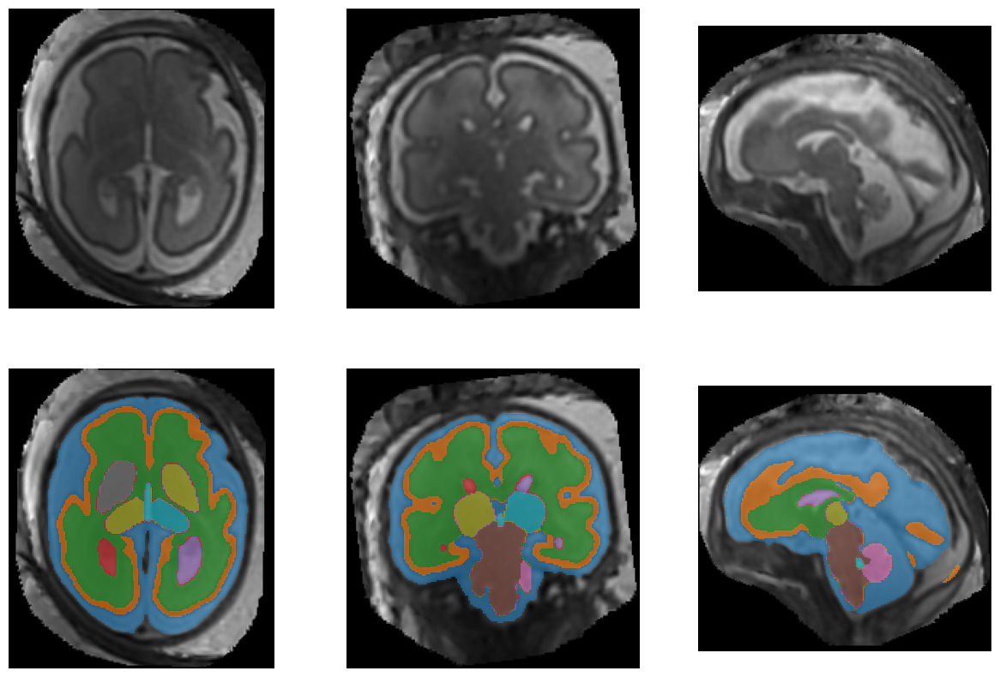

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-149/ses-01/anat/sub-149_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-149/ses-01/anat/sub-149_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 149 -- qcglobal: 1.15 -- thresh_pred: 0.633
Is reco: 1.0 -- geom_artefact: 2.15 -- recon_artefact: 1.15
Noise: 1.1 -- intensity_gm: 0.3 -- intensity_dgm: 1.0


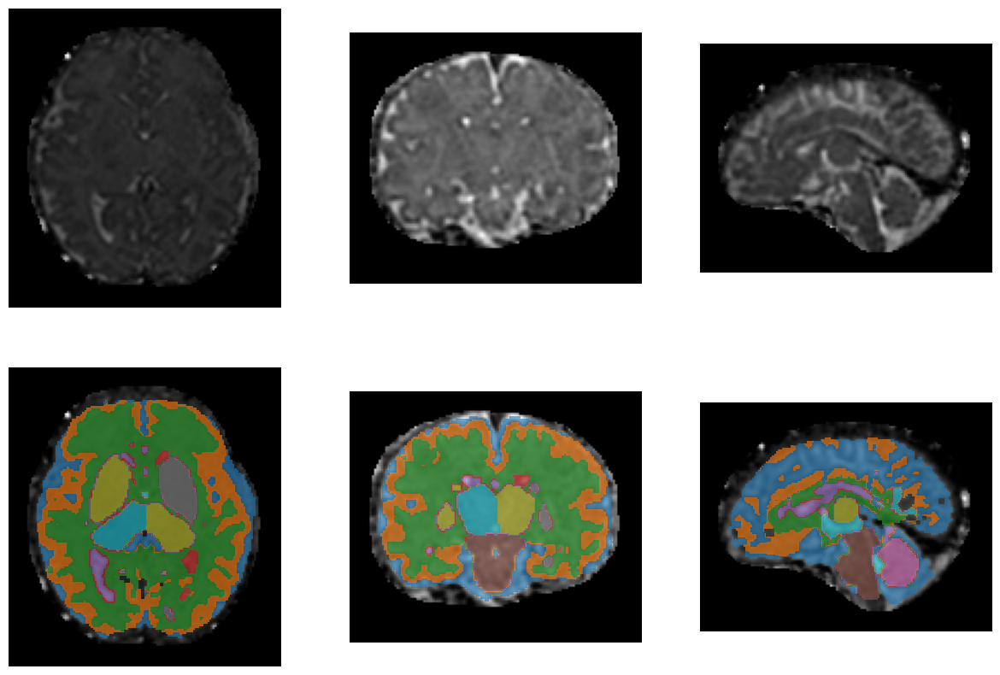

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-chuv063/ses-01/anat/sub-chuv063_ses-01_acq-haste_res-1p1_run-qc1111_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv063/ses-01/anat/sub-chuv063_ses-01_acq-haste_res-1p1_run-qc1111_dseg.nii.gz
Sub chuv063 -- qcglobal: 2.05 -- thresh_pred: 0.6330000000000001
Is reco: 1.0 -- geom_artefact: 2.35 -- recon_artefact: 1.55
Noise: 1.5 -- intensity_gm: 1.75 -- intensity_dgm: 1.0


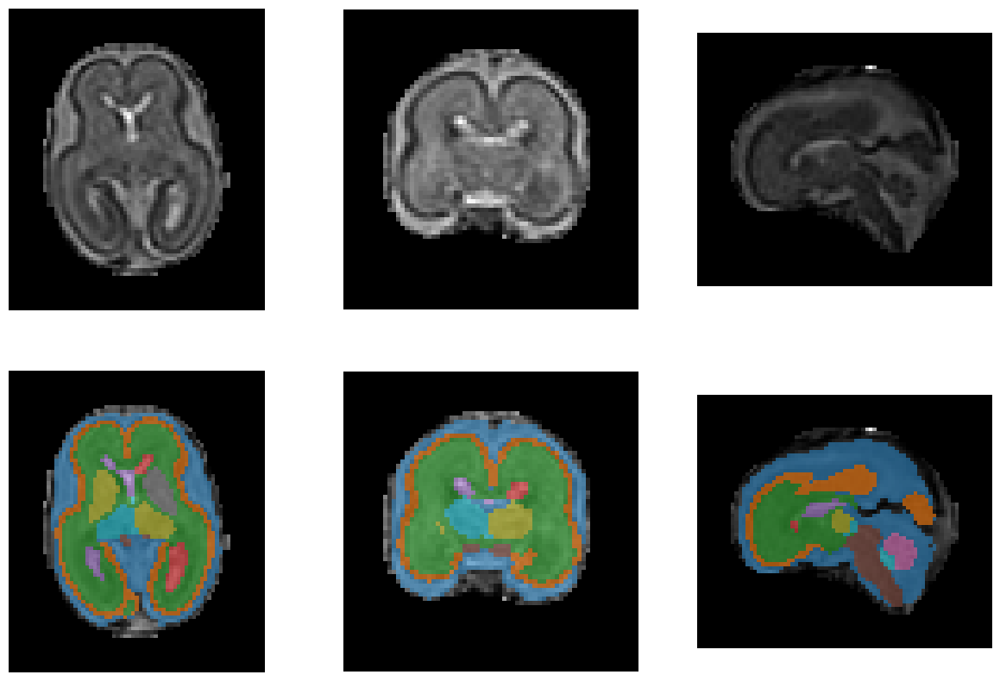

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-chuv145/ses-01/anat/sub-chuv145_ses-01_res-1p1_run-1_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv145/ses-01/anat/sub-chuv145_ses-01_res-1p1_run-1_dseg.nii.gz
Sub chuv145 -- qcglobal: 2.55 -- thresh_pred: 0.635
Is reco: 1.0 -- geom_artefact: 2.15 -- recon_artefact: 1.9
Noise: 1.35 -- intensity_gm: 1.05 -- intensity_dgm: 1.85


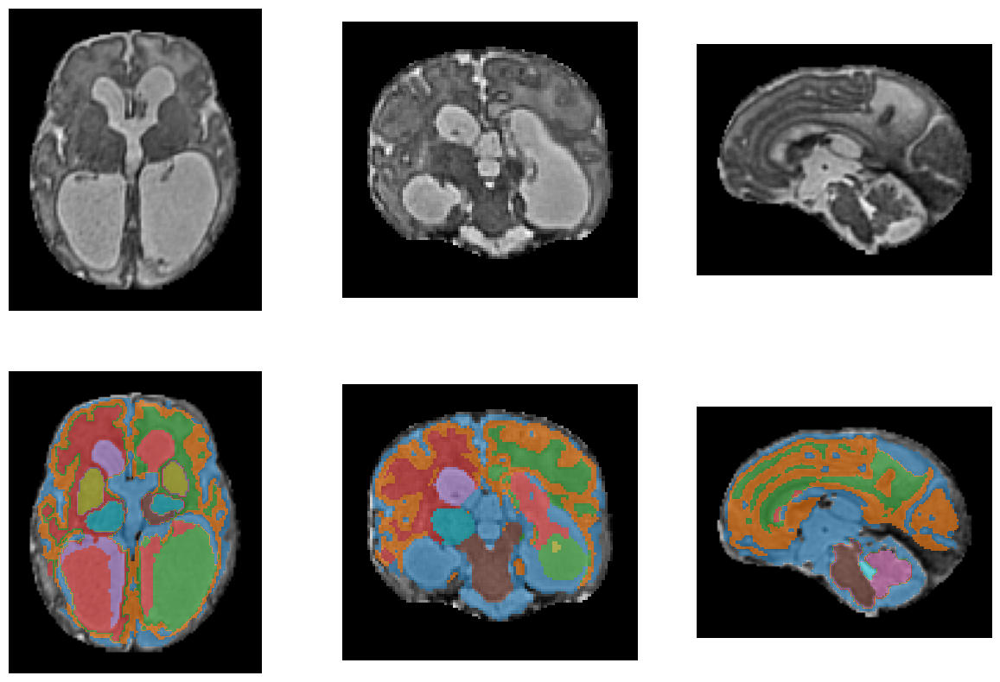

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-136/ses-01/anat/sub-136_ses-01_res-0p5_run-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-136/ses-01/anat/sub-136_ses-01_res-0p5_run-2_dseg.nii.gz
Sub 136 -- qcglobal: 1.05 -- thresh_pred: 0.638
Is reco: 1.0 -- geom_artefact: 1.3 -- recon_artefact: 0.4
Noise: 1.95 -- intensity_gm: 0.0 -- intensity_dgm: 1.0


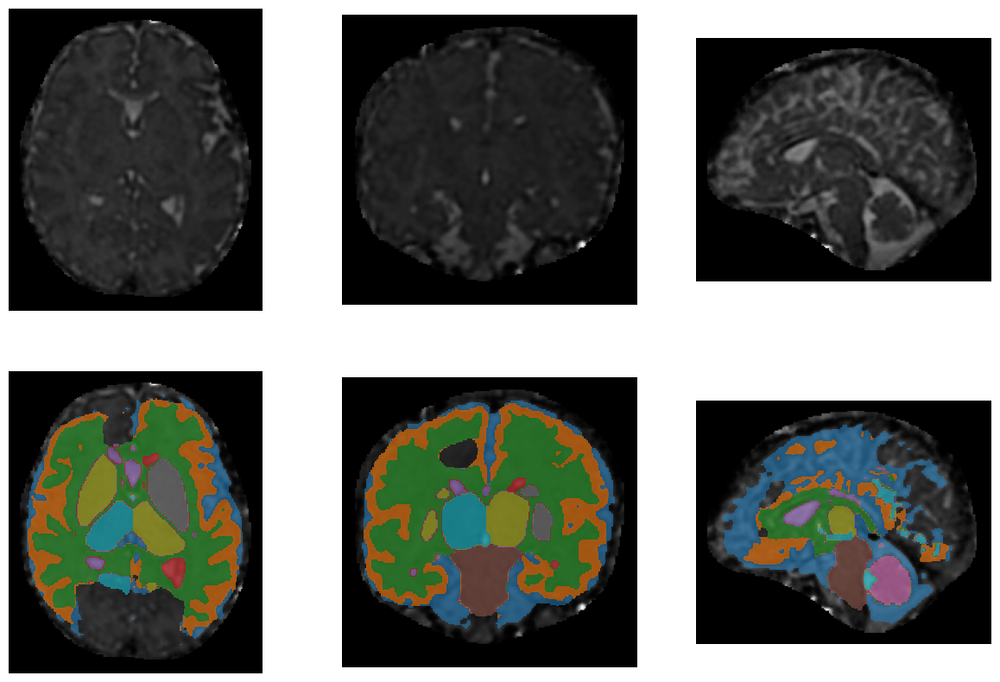

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-150/ses-01/anat/sub-150_ses-01_acq-haste_res-0p5_run-qc0505_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-150/ses-01/anat/sub-150_ses-01_acq-haste_res-0p5_run-qc0505_dseg.nii.gz
Sub 150 -- qcglobal: 1.35 -- thresh_pred: 0.6399999999999999
Is reco: 1.0 -- geom_artefact: 1.1 -- recon_artefact: 1.45
Noise: 1.65 -- intensity_gm: 0.75 -- intensity_dgm: 1.15


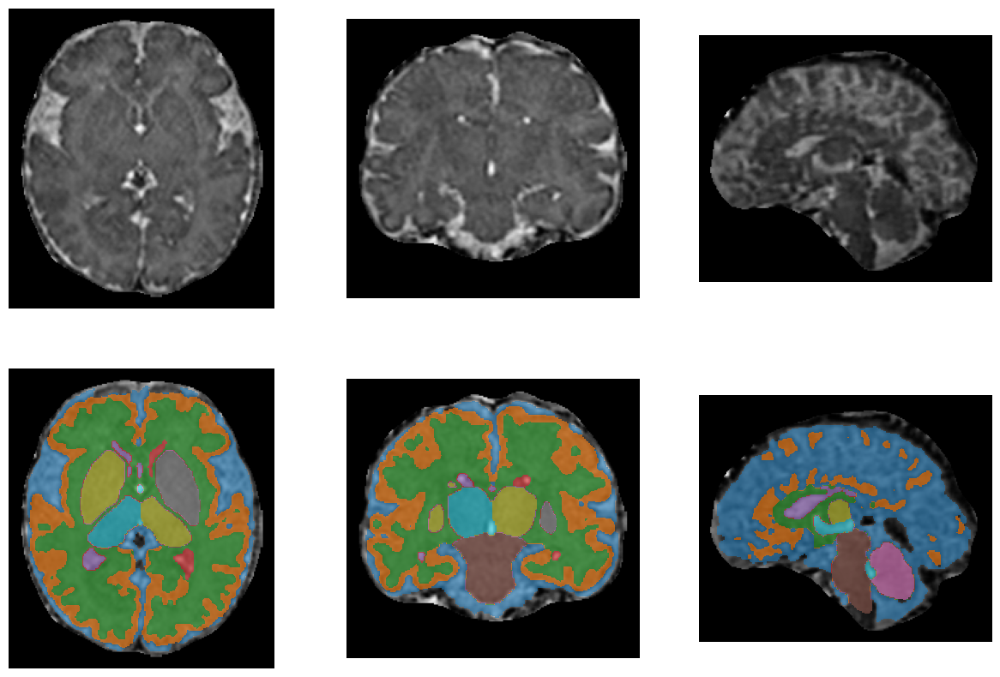

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-chuv154/ses-01/anat/sub-chuv154_ses-01_res-1p1_run-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv154/ses-01/anat/sub-chuv154_ses-01_res-1p1_run-2_dseg.nii.gz
Sub chuv154 -- qcglobal: 1.5 -- thresh_pred: 0.648
Is reco: 1.0 -- geom_artefact: 1.9 -- recon_artefact: 1.3
Noise: 1.8 -- intensity_gm: 0.85 -- intensity_dgm: 1.0


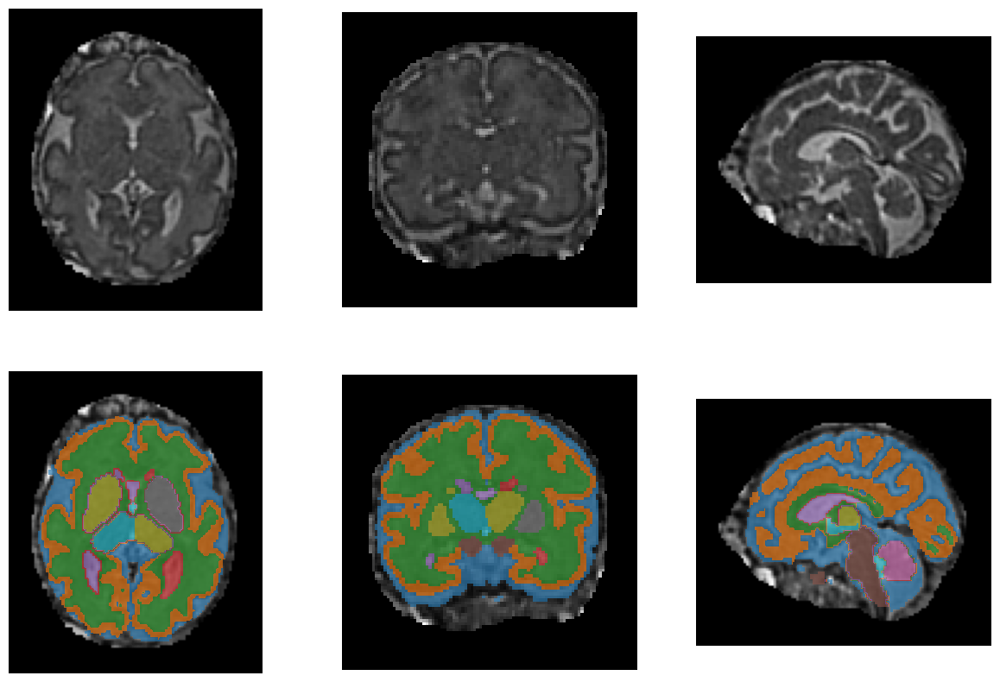

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-026/ses-01/anat/sub-026_ses-01_run-1_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-026/ses-01/anat/sub-026_ses-01_run-1_rec-svrtk_dseg.nii.gz
Sub 26 -- qcglobal: 2.55 -- thresh_pred: 0.655
Is reco: 1.0 -- geom_artefact: 1.95 -- recon_artefact: 1.4
Noise: 2.0 -- intensity_gm: 1.95 -- intensity_dgm: 2.05


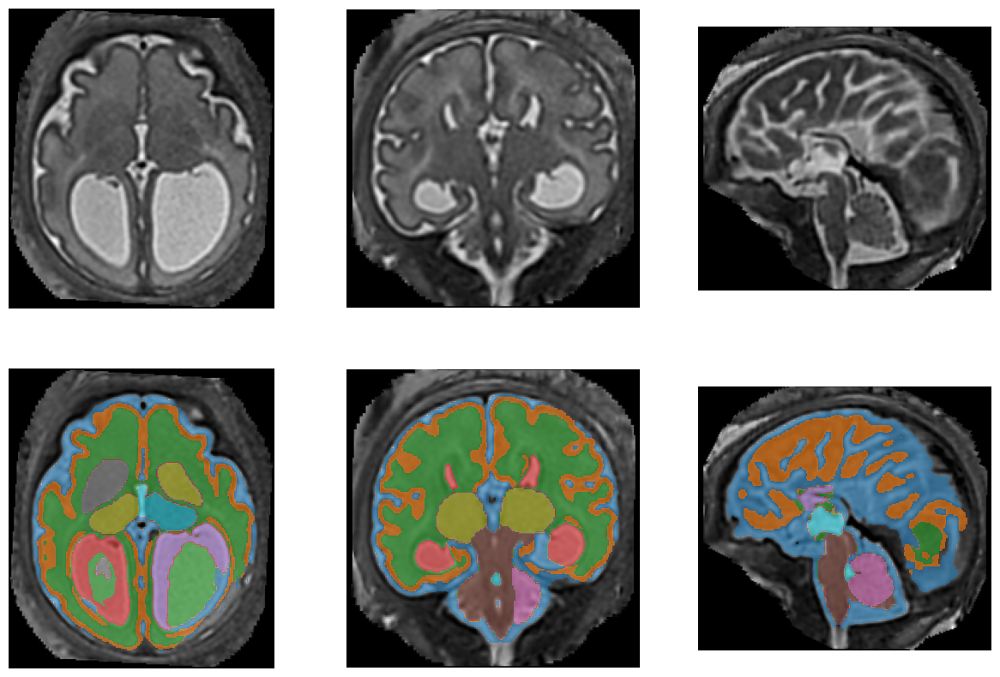

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/nesvor/nesvor/sub-kispi045/anat/sub-kispi045_res-0p8_run-2_rec-nesvor_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi045/anat/sub-kispi045_res-0p8_run-2_rec-nesvor_dseg.nii.gz
Sub kispi045 -- qcglobal: 2.95 -- thresh_pred: 0.6579999999999999
Is reco: 1.0 -- geom_artefact: 2.5 -- recon_artefact: 2.95
Noise: 2.65 -- intensity_gm: 1.75 -- intensity_dgm: 1.25


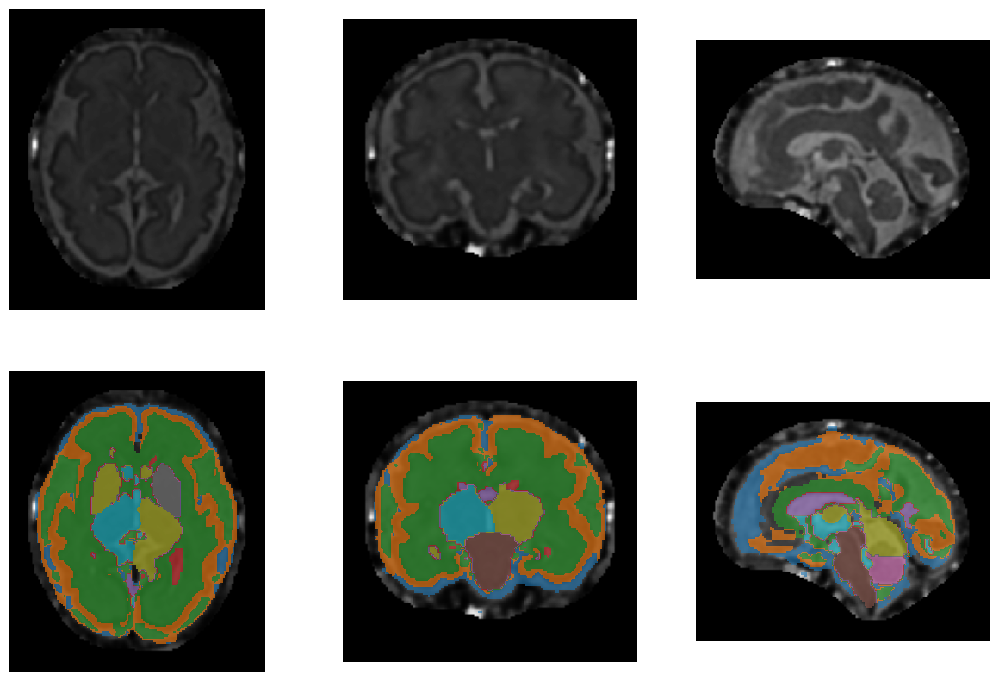

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv089/ses-01/anat/sub-chuv089_ses-01_run-1_rec-svrtk_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv089/ses-01/anat/sub-chuv089_ses-01_run-1_rec-svrtk_dseg.nii.gz
Sub chuv089 -- qcglobal: 2.45 -- thresh_pred: 0.6589999999999999
Is reco: 1.0 -- geom_artefact: 1.65 -- recon_artefact: 1.55
Noise: 1.75 -- intensity_gm: 1.6 -- intensity_dgm: 1.6


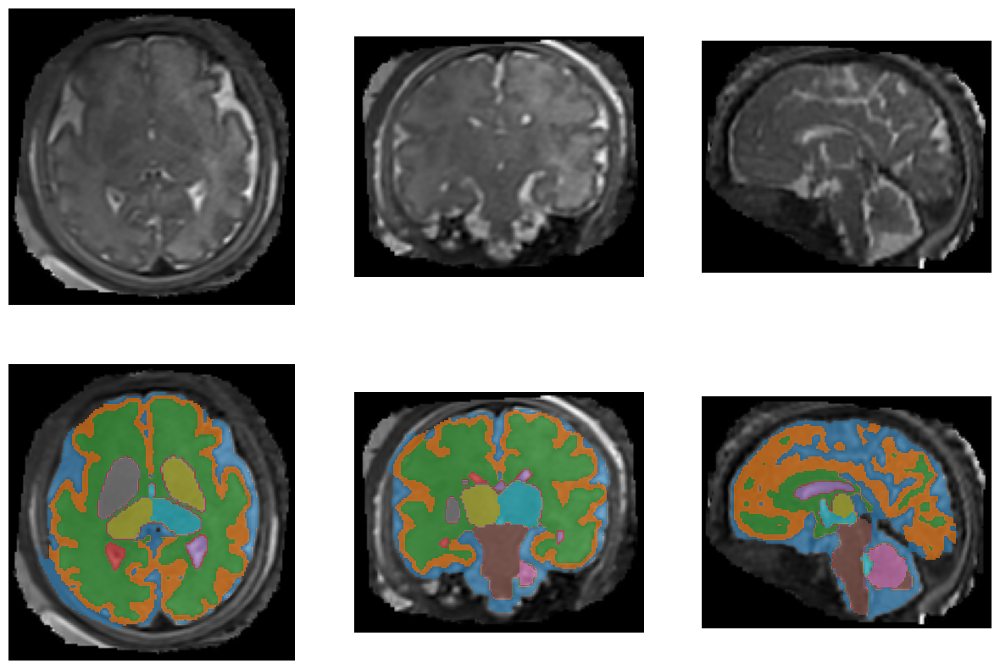

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-124/ses-01/anat/sub-124_ses-01_run-all0505_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-124/ses-01/anat/sub-124_ses-01_run-all0505_SR_dseg.nii.gz
Sub 124 -- qcglobal: 2.5 -- thresh_pred: 0.659
Is reco: 1.0 -- geom_artefact: 1.35 -- recon_artefact: 1.1
Noise: 1.95 -- intensity_gm: 1.15 -- intensity_dgm: 1.85


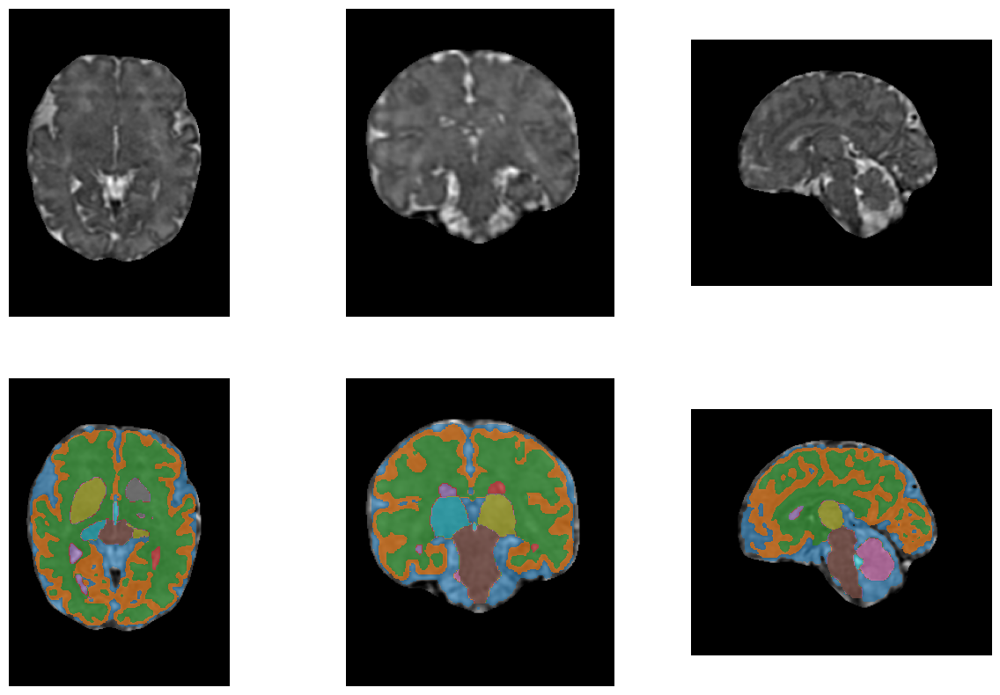

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-135/ses-01/anat/sub-135_ses-01_run-qc0505_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-135/ses-01/anat/sub-135_ses-01_run-qc0505_rec-SR_dseg.nii.gz
Sub 135 -- qcglobal: 1.34 -- thresh_pred: 0.6599999999999999
Is reco: 1.0 -- geom_artefact: 1.37 -- recon_artefact: 1.15
Noise: 2.13 -- intensity_gm: 1.13 -- intensity_dgm: 1.8


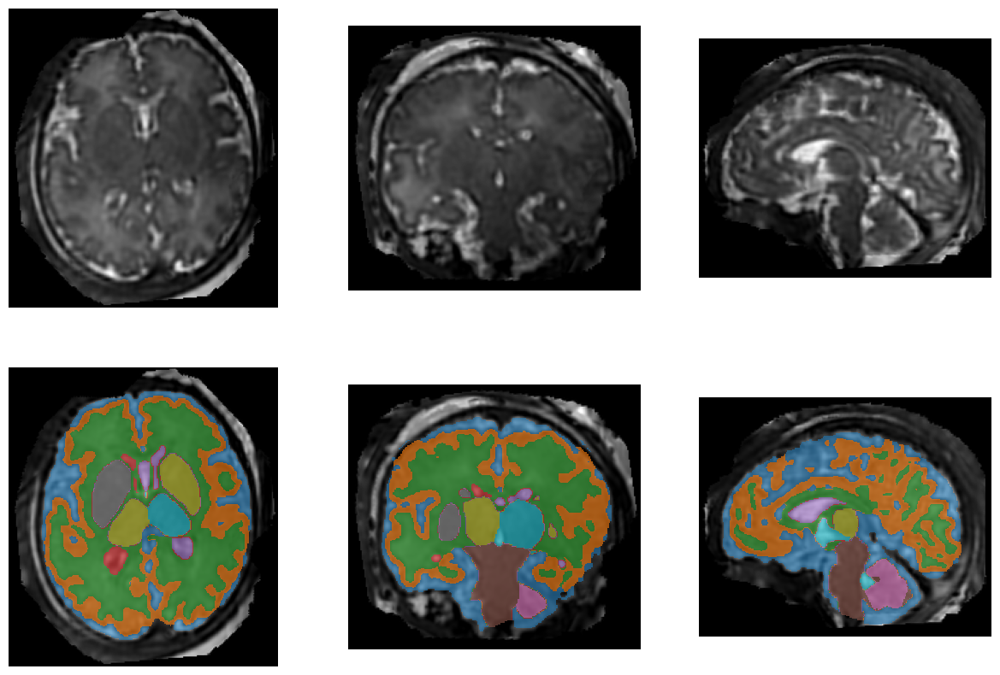

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-004/ses-01/anat/sub-004_ses-01_run-qc0505_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-004/ses-01/anat/sub-004_ses-01_run-qc0505_rec-SR_dseg.nii.gz
Sub 4 -- qcglobal: 1.05 -- thresh_pred: 0.6599999999999999
Is reco: 1.0 -- geom_artefact: 0.85 -- recon_artefact: 1.75
Noise: 2.4 -- intensity_gm: 0.85 -- intensity_dgm: 1.05


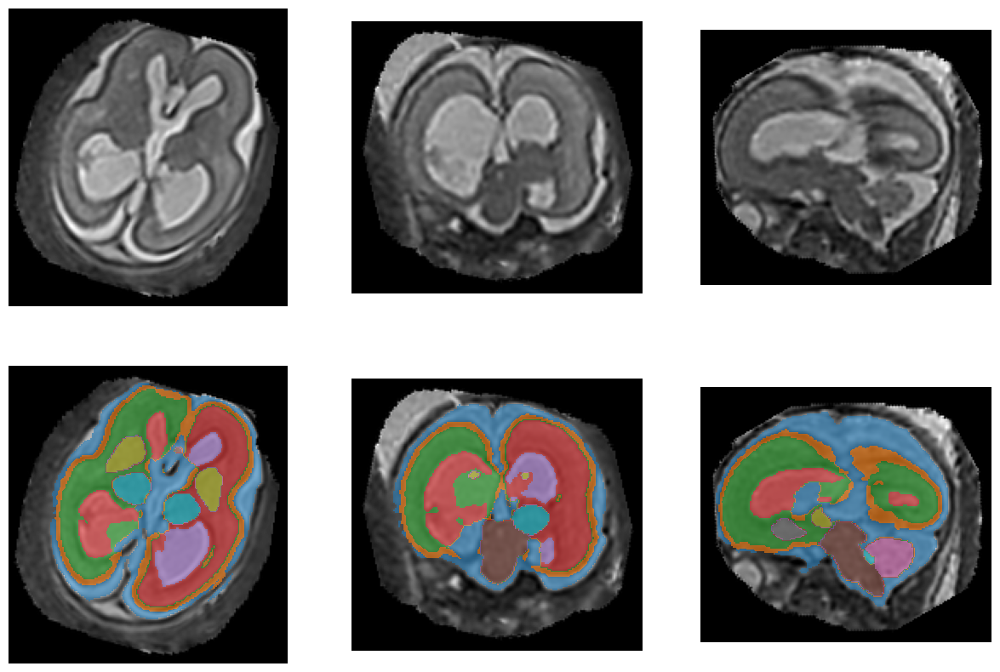

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/niftymic_native/niftymic/sub-chuv063/ses-01/anat/sub-chuv063_ses-01_run-all1111_SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv063/ses-01/anat/sub-chuv063_ses-01_run-all1111_SR_dseg.nii.gz
Sub chuv063 -- qcglobal: 1.75 -- thresh_pred: 0.6649999999999999
Is reco: 1.0 -- geom_artefact: 2.3 -- recon_artefact: 1.1
Noise: 1.0 -- intensity_gm: 1.25 -- intensity_dgm: 0.9


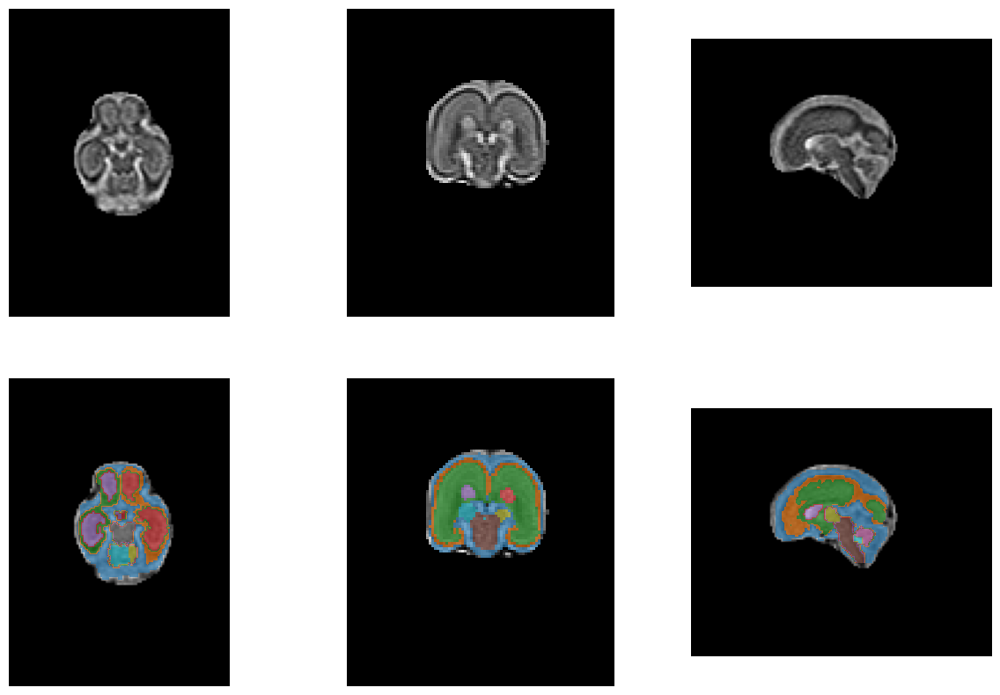

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-147/ses-01/anat/sub-147_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-147/ses-01/anat/sub-147_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 147 -- qcglobal: 1.8 -- thresh_pred: 0.674
Is reco: 1.0 -- geom_artefact: 1.75 -- recon_artefact: 1.05
Noise: 1.8 -- intensity_gm: 0.9 -- intensity_dgm: 1.15


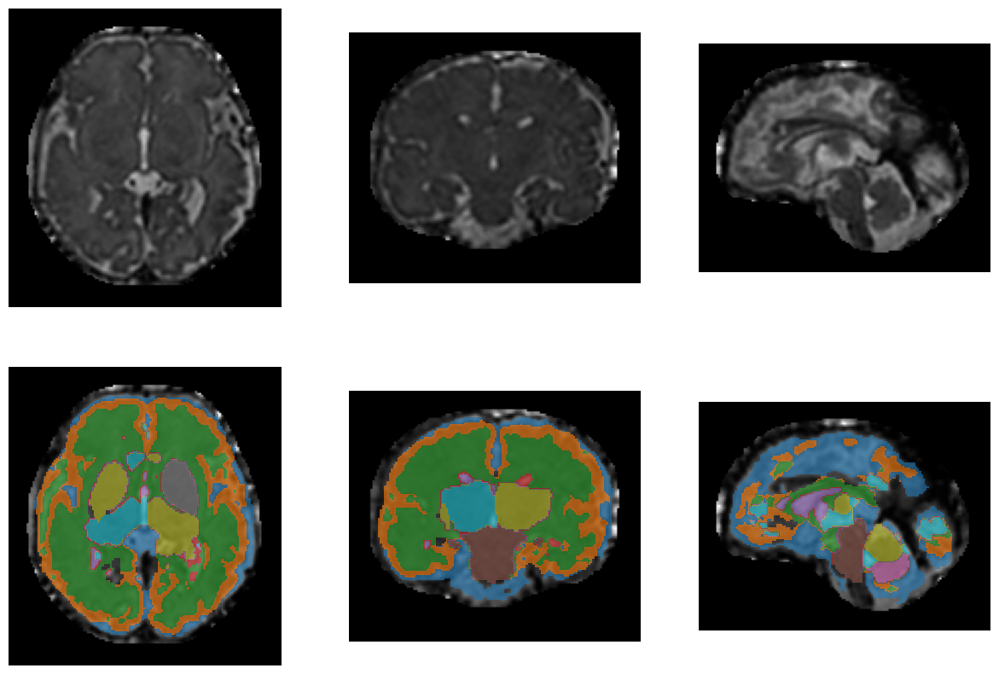

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/mialsrtk/pymialsrtk-2.1.0/sub-chuv162/ses-01/anat/sub-chuv162_ses-01_rec-SR_id-2_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv162/ses-01/anat/sub-chuv162_ses-01_rec-SR_id-2_dseg.nii.gz
Sub chuv162 -- qcglobal: 1.5 -- thresh_pred: 0.6759999999999999
Is reco: 1.0 -- geom_artefact: 2.1 -- recon_artefact: 1.55
Noise: 1.35 -- intensity_gm: 0.75 -- intensity_dgm: 0.85


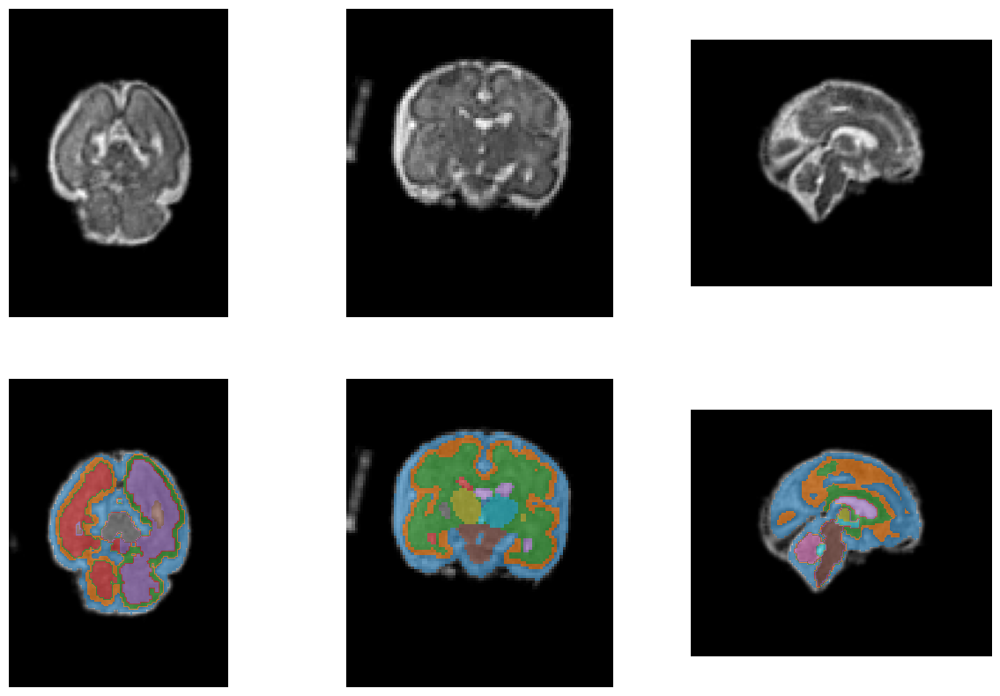

/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/niftymic/niftymic/sub-158/ses-01/anat/sub-158_ses-01_run-1_rec-niftymic_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-158/ses-01/anat/sub-158_ses-01_run-1_rec-niftymic_dseg.nii.gz
Sub 158 -- qcglobal: 1.85 -- thresh_pred: 0.681
Is reco: 1.0 -- geom_artefact: 2.05 -- recon_artefact: 1.45
Noise: 2.35 -- intensity_gm: 1.15 -- intensity_dgm: 1.3


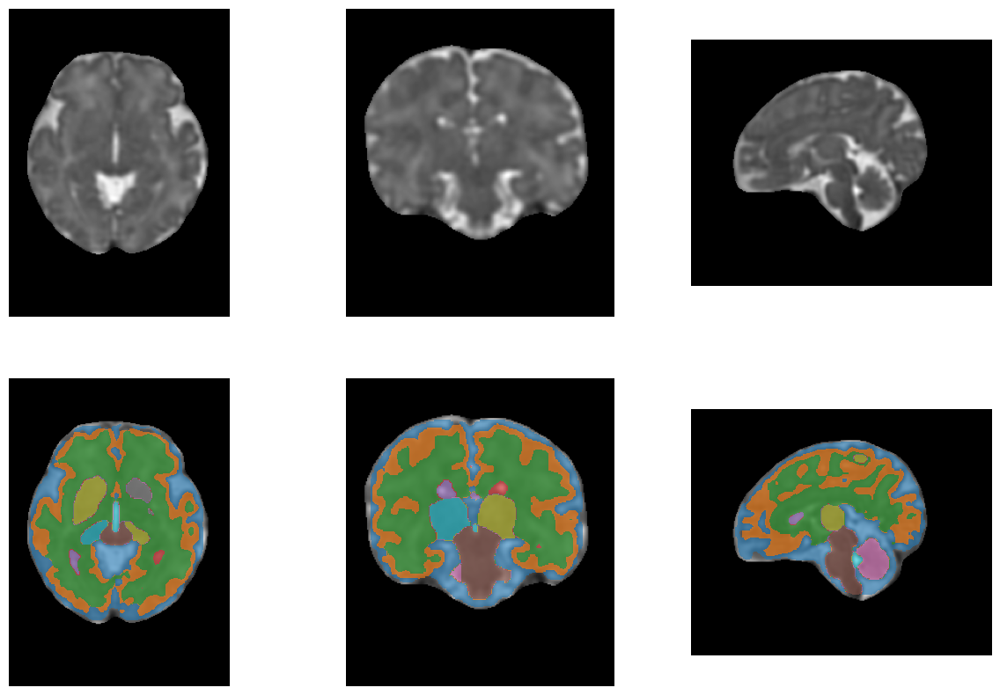

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_0p8/nesvor/sub-022/ses-01/anat/sub-022_ses-01_acq-haste_res-0p8_run-all_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-022/ses-01/anat/sub-022_ses-01_acq-haste_res-0p8_run-all_dseg.nii.gz
Sub 22 -- qcglobal: 1.91 -- thresh_pred: 0.69
Is reco: 1.0 -- geom_artefact: 2.11 -- recon_artefact: 1.88
Noise: 1.13 -- intensity_gm: 1.1 -- intensity_dgm: 1.21


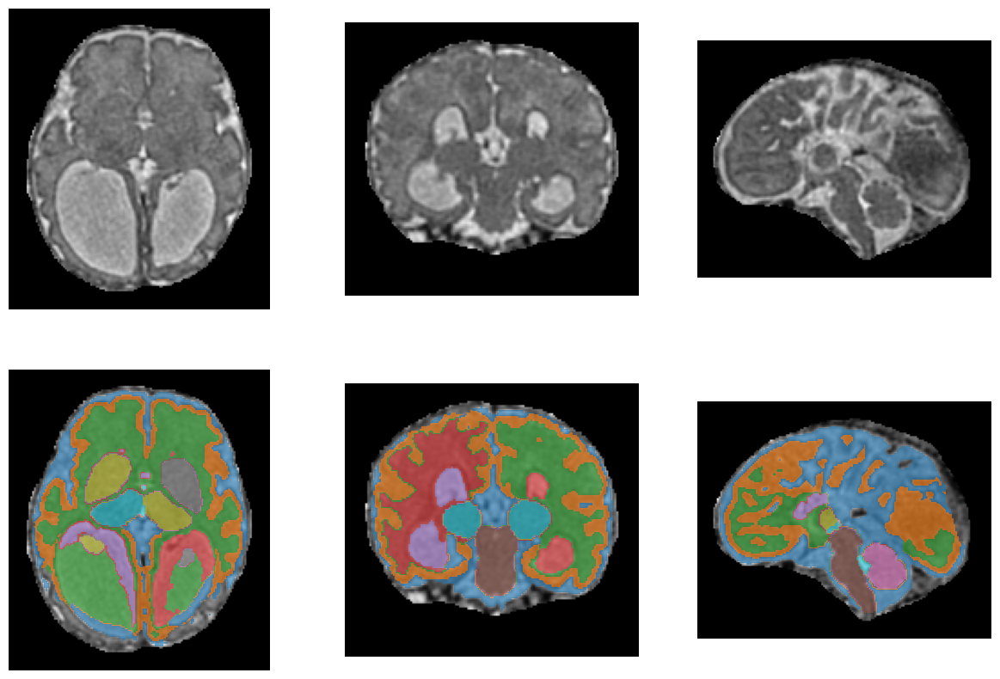

/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-chuv046/ses-01/anat/sub-chuv046_ses-01_run-all1108_rec-SR_T2w.nii.gz
/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv046/ses-01/anat/sub-chuv046_ses-01_run-all1108_rec-SR_dseg.nii.gz
Sub chuv046 -- qcglobal: 1.95 -- thresh_pred: 0.694
Is reco: 1.0 -- geom_artefact: 3.0 -- recon_artefact: 2.9
Noise: 0.85 -- intensity_gm: 2.05 -- intensity_dgm: 1.1


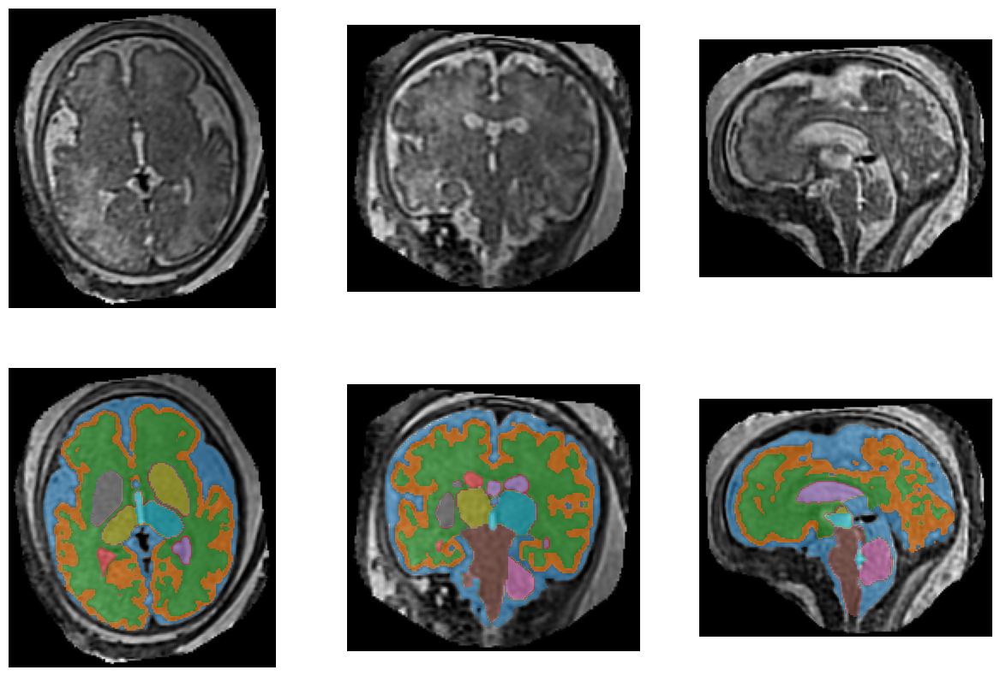

In [76]:
#for i, row in df_failed[df_failed["qcglobal"]<1.0].iterrows():

for i, row in df_failed[df_failed["qcglobal"]>1.0].iterrows():

    sub = row["sub"]
    qcglobal = row["qcglobal"]
    thresh_pred = row["thresh_pred"]
    is_reco = row["is_reconstructed"]
    geom_artefact = row["geom_artefact"]
    recon_artefact = row["recon_artefact"]
    noise = row["noise"]
    intensity_gm = row["intensity_gm"]
    intensity_dgm = row["intensity_dgm"]
    print(row["im"])
    print(row["seg"])
    print(f"Sub {sub} -- qcglobal: {qcglobal} -- thresh_pred: {thresh_pred}") #-- {row['error_abs']:.2f}
    print(f"Is reco: {is_reco} -- geom_artefact: {geom_artefact} -- recon_artefact: {recon_artefact}")
    print(f"Noise: {noise} -- intensity_gm: {intensity_gm} -- intensity_dgm: {intensity_dgm}")
    display(row["im"], row["seg"])


In [119]:
!ls /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv046/ses-01/anat/

sub-chuv046_ses-01_acq-haste_res-0p8_run-qc1108_dseg.nii.gz
sub-chuv046_ses-01_acq-haste_res-0p8_run-qc1108_mask.nii.gz
sub-chuv046_ses-01_run-all1108_rec-SR_dseg.nii.gz
sub-chuv046_ses-01_run-all1108_rec-SR_mask.nii.gz
sub-chuv046_ses-01_run-qc1108_rec-SR_dseg.nii.gz
sub-chuv046_ses-01_run-qc1108_rec-SR_mask.nii.gz
sub-chuv046_ses-01_run-qc1108_SR_dseg.nii.gz
sub-chuv046_ses-01_run-qc1108_SR_mask.nii.gz


In [9]:
import SimpleITK as sitk
from pathlib import Path
import os

In [11]:
sr_dir = Path("/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/corrected_srr")
sr_dir.mkdir(parents=True, exist_ok=True)
for i, row in df_failed[df_failed["error_type.1"] == "bias"].iterrows():
    imp = row["im"]
    maskp = row["mask"]
    imn = Path(imp).name

    im = sitk.ReadImage(imp)
    
    mask = sitk.ReadImage(maskp)
    mask = sitk.Cast(mask, sitk.sitkUInt8)
        
    sub, ses = row["sub"], row["ses"]
    sub = sub if not str.isdigit(sub) else f"{int(sub):03d}"
    if isinstance(ses, (int, float)):
        if np.isnan(ses):
            ses = None
        else:
            ses = int(ses)
    else:
        if str.isdigit(ses):
            ses = int(ses)
        else:
            ses = None
    ses = None if ses is None else f"{int(ses):02d}"
    print(sub, ses, imp)
    display(imp)
    out_dir = sr_dir / f"sub-{sub}"
    if ses is not None:
        out_dir = out_dir / f"ses-{ses}"
    out_dir = out_dir / "anat"
    out_dir.mkdir(parents=True, exist_ok=True)
    # Make a simlink to the original image
    # Make sure im exists
    if not os.path.exists(imp):
        print(f"Image {imp} does not exist")
        raise FileNotFoundError
    if not os.path.exists(out_dir / imn):
        im_max, im_min = sitk.GetArrayFromImage(im).max(), sitk.GetArrayFromImage(im).min()
        # Normalize im with sitk
        rescaler = sitk.RescaleIntensityImageFilter()
        rescaler.SetOutputMaximum(1)
        rescaler.SetOutputMinimum(0)
        im = rescaler.Execute(im)
    
    
        # Correct bias field
        corrector = sitk.N4BiasFieldCorrectionImageFilter()
        corrector.SetBiasFieldFullWidthAtHalfMaximum(0.25)
        corrector.SetSplineOrder(3)

        corrected_im = corrector.Execute(im, mask)
        corrected_im = rescaler.Execute(corrected_im)
        corr = sitk.GetArrayFromImage(corrected_im)
        #Map back to original range
        corr = (corr * (im_max - im_min)) + im_min
        # Recreate and save an image
        corrected_im = sitk.GetImageFromArray(corr)
        corrected_im.CopyInformation(im)
        sitk.WriteImage(corrected_im, str(out_dir / imn))
        display(str(out_dir / imn))
    else:
        df_failed.loc[i,"im_new"] = str(out_dir / imn)

149 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-149/ses-01/anat/sub-149_ses-01_run-all_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-149/ses-01/anat/sub-149_ses-01_run-all_rec-SR_T2w.nii.gz'

152 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-152/ses-01/anat/sub-152_ses-01_run-qc0508_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-152/ses-01/anat/sub-152_ses-01_run-qc0508_rec-SR_T2w.nii.gz'

chuv107 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv107/ses-01/anat/sub-chuv107_ses-01_run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv107/ses-01/anat/sub-chuv107_ses-01_run-1_rec-svrtk_T2w.nii.gz'

142 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-142/ses-01/anat/sub-142_ses-01_run-qc0505_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-142/ses-01/anat/sub-142_ses-01_run-qc0505_rec-SR_T2w.nii.gz'

chuv103 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv103/ses-01/anat/sub-chuv103_ses-01_run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv103/ses-01/anat/sub-chuv103_ses-01_run-1_rec-svrtk_T2w.nii.gz'

chuv178 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv178/ses-01/anat/sub-chuv178_ses-01_run-2_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv178/ses-01/anat/sub-chuv178_ses-01_run-2_rec-svrtk_T2w.nii.gz'

140 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-140/ses-01/anat/sub-140_ses-01_run-all0505_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-140/ses-01/anat/sub-140_ses-01_run-all0505_rec-SR_T2w.nii.gz'

143 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-143/ses-01/anat/sub-143_ses-01_run-qc0505_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-143/ses-01/anat/sub-143_ses-01_run-qc0505_rec-SR_T2w.nii.gz'

135 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-135/ses-01/anat/sub-135_ses-01_run-qc0505_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-135/ses-01/anat/sub-135_ses-01_run-qc0505_rec-SR_T2w.nii.gz'

chuv089 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv089/ses-01/anat/sub-chuv089_ses-01_run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv089/ses-01/anat/sub-chuv089_ses-01_run-1_rec-svrtk_T2w.nii.gz'

chuv159 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv159/ses-01/anat/sub-chuv159_ses-01_run-2_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv159/ses-01/anat/sub-chuv159_ses-01_run-2_rec-svrtk_T2w.nii.gz'

chuv247 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv247/ses-01/anat/sub-chuv247_ses-01_run-2_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv247/ses-01/anat/sub-chuv247_ses-01_run-2_rec-svrtk_T2w.nii.gz'

chuv169 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv169/ses-01/anat/sub-chuv169_ses-01_run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv169/ses-01/anat/sub-chuv169_ses-01_run-1_rec-svrtk_T2w.nii.gz'

chuv063 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-chuv063/ses-01/anat/sub-chuv063_ses-01_run-all1111_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-chuv063/ses-01/anat/sub-chuv063_ses-01_run-all1111_rec-SR_T2w.nii.gz'

chuv201 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv201/ses-01/anat/sub-chuv201_ses-01_run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv201/ses-01/anat/sub-chuv201_ses-01_run-1_rec-svrtk_T2w.nii.gz'

chuv232 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv232/ses-01/anat/sub-chuv232_ses-01_run-2_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv232/ses-01/anat/sub-chuv232_ses-01_run-2_rec-svrtk_T2w.nii.gz'

chuv111 01 /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv111/ses-01/anat/sub-chuv111_ses-01_run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-chuv111/ses-01/anat/sub-chuv111_ses-01_run-1_rec-svrtk_T2w.nii.gz'

chuv062 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-chuv062/ses-01/anat/sub-chuv062_ses-01_run-all1108_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-chuv062/ses-01/anat/sub-chuv062_ses-01_run-all1108_rec-SR_T2w.nii.gz'

kispi032 None /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-kispi032/anat/sub-kispi032__run-2_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-kispi032/anat/sub-kispi032__run-2_rec-svrtk_T2w.nii.gz'

019 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-019/ses-01/anat/sub-019_ses-01_run-qc0508_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-019/ses-01/anat/sub-019_ses-01_run-qc0508_rec-SR_T2w.nii.gz'

kispi2017 None /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native_v2/svrtk/sub-kispi2017/anat/sub-kispi2017__run-all_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native_v2/svrtk/sub-kispi2017/anat/sub-kispi2017__run-all_rec-svrtk_T2w.nii.gz'

kispi034 None /media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-kispi034/anat/sub-kispi034__run-1_rec-svrtk_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/SR/svrtk/svrtk/sub-kispi034/anat/sub-kispi034__run-1_rec-svrtk_T2w.nii.gz'

chuv025 01 /media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-chuv025/ses-01/anat/sub-chuv025_ses-01_run-all1111_rec-SR_T2w.nii.gz


'/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-chuv025/ses-01/anat/sub-chuv025_ses-01_run-all1111_rec-SR_T2w.nii.gz'

In [21]:
ims = sitk.ReadImage(imp)

ims.GetSpacing()

(1.100000023841858, 1.100000023841858, 1.100000023841858)

(95, 106, 93)
(95, 106, 93)
[[  1.10000002   0.           0.         -53.89999771]
 [  0.          -1.10000002   0.          57.74999619]
 [  0.           0.           1.10000002 -48.94999695]]
[[ -1.10000002   0.           0.          53.89999771]
 [  0.           1.10000002   0.         -57.74999619]
 [  0.           0.           1.10000002 -48.94999695]
 [  0.           0.           0.           1.        ]]


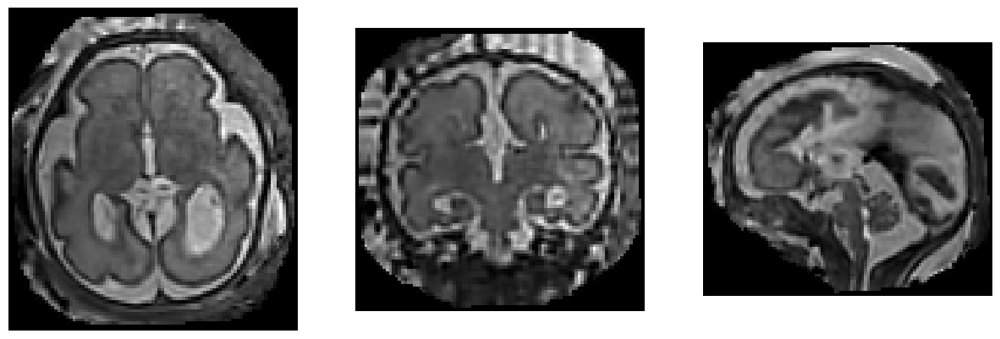

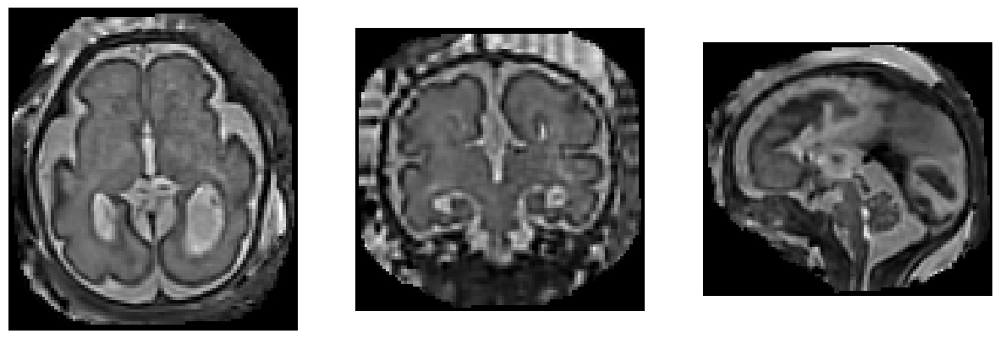

In [53]:
imp = train_y.loc[0, "im"]

ims = sitk.ReadImage(imp)

imp = train_y.loc[0, "im"]
display(imp)
maskp = train_y.loc[0, "mask"]
im = sitk.ReadImage(imp)


mask = sitk.ReadImage(maskp)
mask = sitk.Cast(mask, sitk.sitkUInt8)
im_max, im_min = sitk.GetArrayFromImage(im).max(), sitk.GetArrayFromImage(im).min()
# Normalize im with sitk
rescaler = sitk.RescaleIntensityImageFilter()
rescaler.SetOutputMaximum(1)
rescaler.SetOutputMinimum(0)
im = rescaler.Execute(im)


# Correct bias field
corrector = sitk.N4BiasFieldCorrectionImageFilter()
corrector.SetBiasFieldFullWidthAtHalfMaximum(0.25)
corrector.SetSplineOrder(3)

corrected_im = corrector.Execute(im, mask)
corrected_im = rescaler.Execute(corrected_im)
corr = sitk.GetArrayFromImage(corrected_im)
#Map back to original range
corr = (corr * (im_max - im_min)) + im_min
# Recreate and save an image
sitk_corr = corr
corrected_im = sitk.GetImageFromArray(corr)
corrected_im.CopyInformation(im)
display(sitk.GetArrayFromImage(corrected_im).transpose(2,1,0))

im = nib.load(imp)

#aff = im.affine


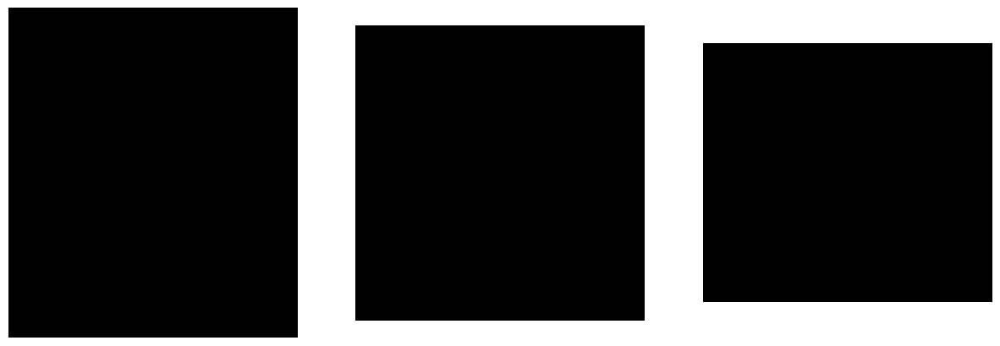

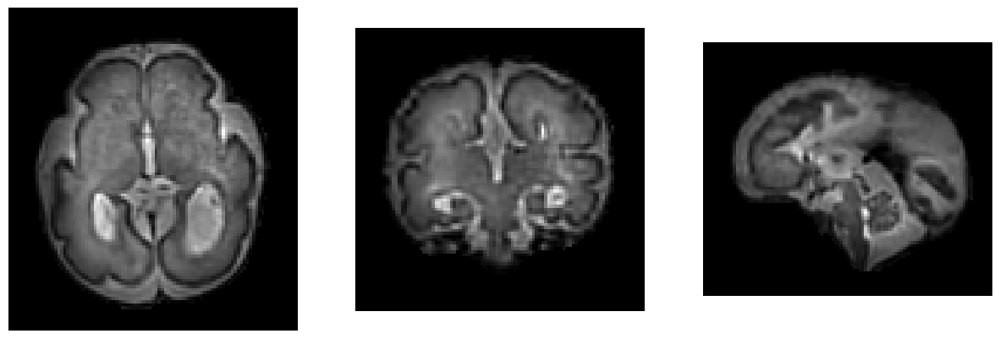

In [64]:
im_ni = nib.load(imp)
mask_ni = nib.load(maskp)
im_ni = nib.Nifti1Image(im_ni.get_fdata()*mask_ni.get_fdata(), im_ni.affine, im_ni.header)
def nib2sitk(im):
    if isinstance(im, str):
        im = nib.load(im)
    im_sitk = sitk.GetImageFromArray(im.get_fdata().transpose(2,1,0))
    x,y,z = im.header.get_zooms()
    im_sitk.SetSpacing((float(x), float(y), float(z)))
    # get qform
    x,y,z = im.affine[:3,3]
    im_sitk.SetOrigin((float(x), float(y), float(z)))
    return im_sitk

im_sitk = nib2sitk(im_ni)
#mask_sitk = nib2sitk(mask_ni)
#mask_sitk = sitk.Cast(mask_sitk, sitk.sitkUInt8)

#sitk.WriteImage(im_sitk, "test.nii.gz")
display(sitk.GetArrayFromImage(sitk.ReadImage("test.nii.gz")) - sitk.GetArrayFromImage(sitk.ReadImage(imp)))

im_max, im_min = sitk.GetArrayFromImage(im_sitk).max(), sitk.GetArrayFromImage(im_sitk).min()
# Normalize im with sitk
rescaler = sitk.RescaleIntensityImageFilter()
rescaler.SetOutputMaximum(1)
rescaler.SetOutputMinimum(0)
im_sitk = rescaler.Execute(im_sitk)


# Correct bias field
corrector = sitk.N4BiasFieldCorrectionImageFilter()
corrector.SetBiasFieldFullWidthAtHalfMaximum(0.2)
corrector.SetSplineOrder(3)

corrected_im = corrector.Execute(im_sitk)
corrected_im = rescaler.Execute(corrected_im)
corr = sitk.GetArrayFromImage(corrected_im)
#Map back to original range
corr = (corr * (im_max - im_min)) + im_min
# Recreate and save an image
im_ni_corr = nib.Nifti1Image(corr.transpose(2,1,0), im_ni.affine, im_ni.header)
display(im_ni_corr.get_fdata())

In [60]:
(im_ni_corr.get_fdata()-sitk_corr.transpose(2,1,0))

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0.

In [18]:
# Rename columns in_new -> im, im -> im_old
df_bias = df_bias.rename(columns={"im_new":"im", "im":"im_old"})
# Remove mask and seg columns
df_bias = df_bias.drop(columns=["mask", "seg"])
df_bias.to_csv("bids_bias_corrected.csv", index=False)

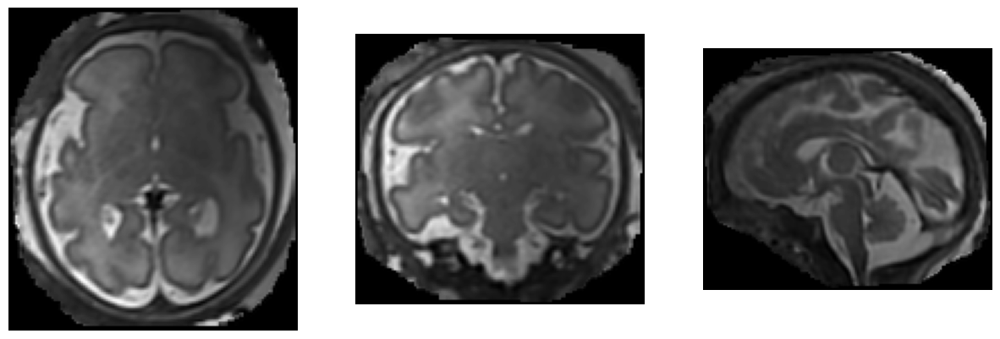

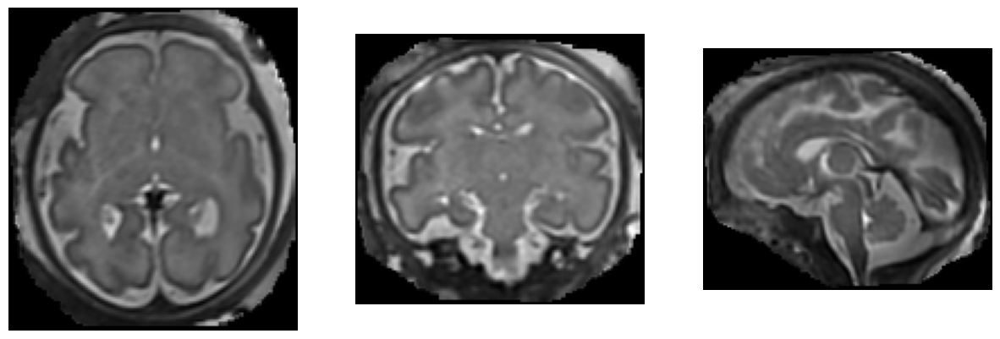

In [ ]:
# Correct bias field of image
#imp = "/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_0p8/svrtk/sub-149/ses-01/anat/sub-149_ses-01_run-all_rec-SR_T2w.nii.gz"
#maskp = "/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-149/ses-01/anat/sub-149_ses-01_run-all_rec-SR_mask.nii.gz"#

#imp = "/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/svrtk_native/svrtk/sub-chuv025/ses-01/anat/sub-chuv025_ses-01_run-all1111_rec-SR_T2w.nii.gz"
#maskp = "/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-chuv025/ses-01/anat/sub-chuv025_ses-01_run-all1111_rec-SR_dseg.nii.gz"
row = df_failed[df_failed["error_type.1"] == "bias"].iloc[12]
imp = row["im"]
maskp = row["mask"]



im = sitk.ReadImage(imp)
mask = sitk.ReadImage(maskp)
mask = sitk.Cast(mask, sitk.sitkUInt8)
sitk.WriteImage(im, "test.nii.gz")
im_max, im_min = sitk.GetArrayFromImage(im).max(), sitk.GetArrayFromImage(im).min()
# Normalize im with sitk
rescaler = sitk.RescaleIntensityImageFilter()
rescaler.SetOutputMaximum(1)
rescaler.SetOutputMinimum(0)
im = rescaler.Execute(im)
#im = sitk.Normalize(im)

ima = sitk.GetArrayFromImage(im)

display(imp)

# Correct bias field
corrector = sitk.N4BiasFieldCorrectionImageFilter()
corrector.SetBiasFieldFullWidthAtHalfMaximum(0.25)
#corrector.SetMaximumNumberOfIterations([100, 100, 50, 30])
#corrector.SetConvergenceThreshold(1e-6)
corrector.SetSplineOrder(3)
# corrector.SetWienerFilterNoise(0.11)

#shrink_factor = 2
#bias_field_fwhm = 0.05
#num_iterations = [100, 100, 50, 30]  # More iterations refine the bias field

# corrected_im = sitk.N4BiasFieldCorrection(im,
#     shrinkFactor=shrink_factor, 
#     biasFieldFullWidthAtHalfMaximum=bias_field_fwhm,
#     maximumNumberOfIterations=num_iterations
# )

corrected_im = corrector.Execute(im, mask)
corrected_im = rescaler.Execute(corrected_im)
corr = sitk.GetArrayFromImage(corrected_im)
#Map back to original range
corr = (corr * (im_max - im_min)) + im_min
# Recreate and save an image
corrected_im = sitk.GetImageFromArray(corr)
corrected_im.CopyInformation(im)
#saveim
imp = "test_im.nii.gz"

sitk.WriteImage(corrected_im, "test_corr.nii.gz")
display(imp)


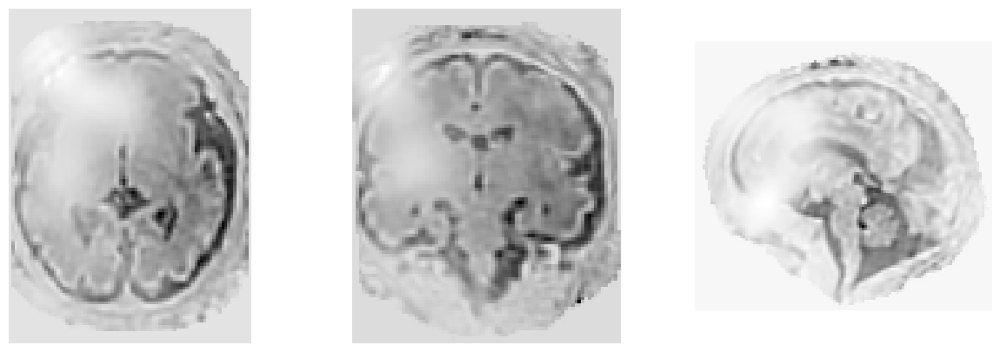

In [93]:
# Do the difference between both images and show it

ima = sitk.GetArrayFromImage(im)
rescaler = sitk.RescaleIntensityImageFilter()
rescaler.SetOutputMaximum(1)
rescaler.SetOutputMinimum(0)
corrected_im = rescaler.Execute(corrected_im)
imb = sitk.GetArrayFromImage(corrected_im)


diff = imb-ima
# Save to "test.nii.gz"
imp = "test.nii.gz"
sitk.WriteImage(sitk.GetImageFromArray(diff), imp)
display(imp)


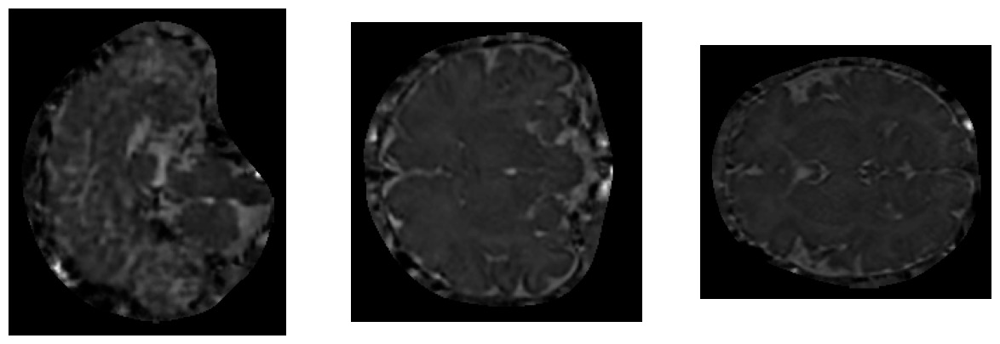

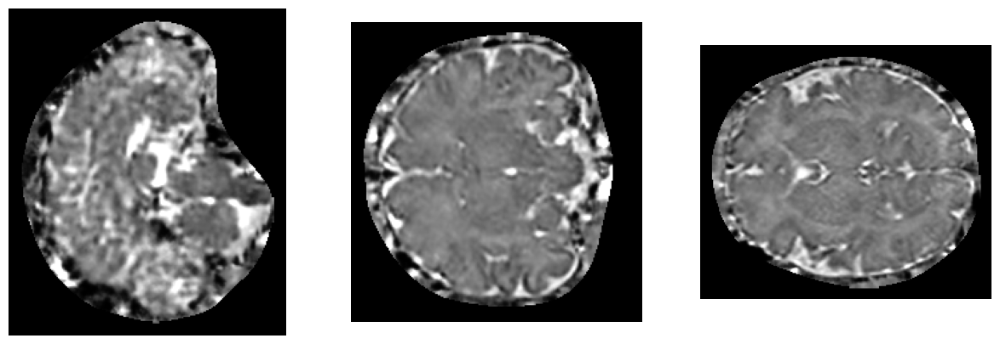

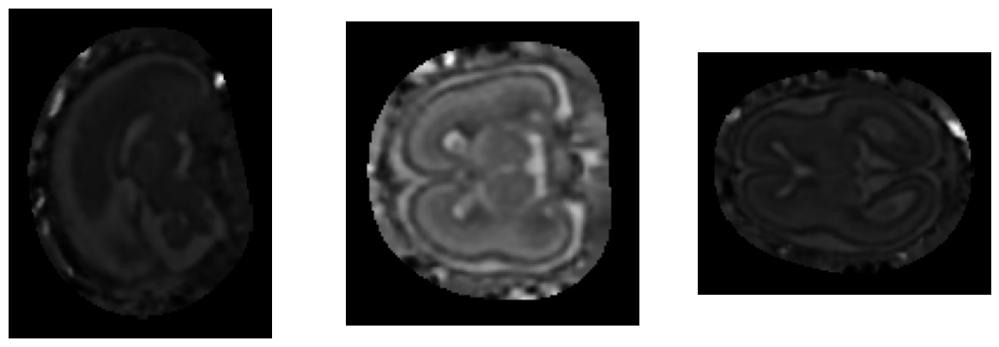

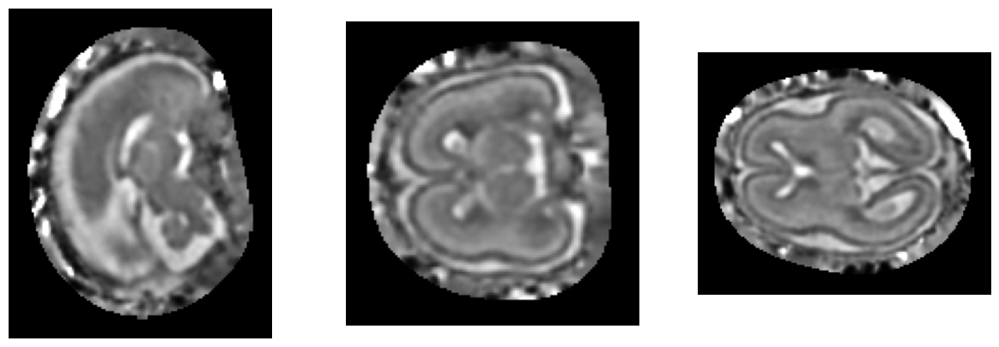

In [105]:
iml = ["/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-150/ses-01/anat/sub-150_ses-01_acq-haste_res-0p5_run-all0505_T2w.nii.gz",
"/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native_v2/nesvor/sub-kispi2017/anat/sub-kispi2017_res-0p5_run-all_rec-nesvor_T2w.nii.gz"]

maskl = ["/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-150/ses-01/anat/sub-150_ses-01_acq-haste_res-0p5_run-all0505_mask.nii.gz",
"/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-kispi2017/anat/sub-kispi2017_res-0p5_run-all_rec-nesvor_dseg.nii.gz"]

for i, (imp, maskp) in enumerate(zip(iml,maskl)):
    im = sitk.ReadImage(imp)
    imc = sitk.GetArrayFromImage(im)
    display(imc)
    # Numpy get intensity at 99th quantile and clip there
    intensity = np.quantile(imc, 0.995)
    imc[imc > intensity] = intensity

    im_out = sitk.GetImageFromArray(imc)

    #mask = sitk.ReadImage(maskp)
    #display(sitk.GetArrayFromImage(im))
    # Mask image
    #mask = sitk.Cast(mask, sitk.sitkUInt8)
    #im = sitk.Mask(im, mask)
    im_out.CopyInformation(im)

    display(sitk.GetArrayFromImage(im_out))

    # Save image
    imp = f"test_im_{i}.nii.gz"
    sitk.WriteImage(im_out, imp)

In [ ]:
imp ="/media/tsanchez/tsanchez_data/data/SR_QC_study/derivatives/nesvor_native/nesvor/sub-150/ses-01/anat/sub-150_ses-01_acq-haste_res-0p5_run-all0505_T2w.nii.gz"
im = sitk.ReadImage(imp)

# Do a quantile normalization of the intensity of the image (above 0.99 to 0.99 value)
rescaler = sitk.RescaleIntensityImageFilter()



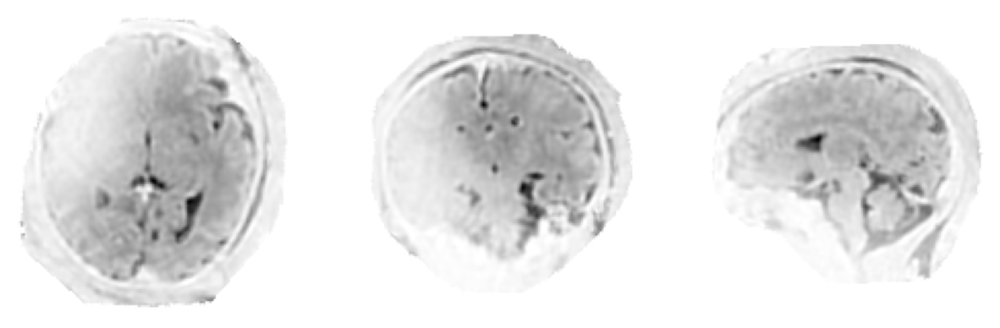

In [80]:
# Do the difference between both images and show it

ima = sitk.GetArrayFromImage(im)
imb = sitk.GetArrayFromImage(corrected_im)

diff = ima - imb
# Save to "test.nii.gz"
imp = "test.nii.gz"
sitk.WriteImage(sitk.GetImageFromArray(diff), imp)
display(imp)


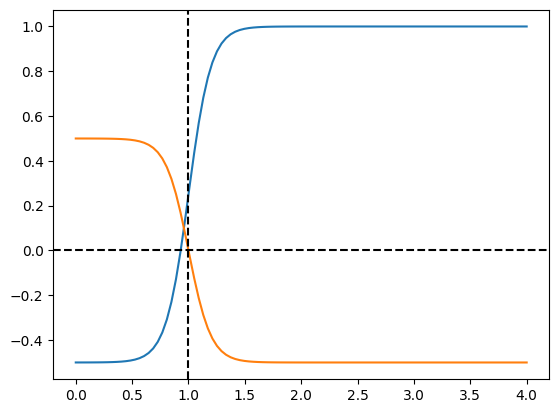

In [242]:
x = np.linspace(0,4,100)

y = 1./(1+np.exp(-10*(x-1)))-0.5
y2 = 1-1/(1+np.exp(-10*(x-1)))-0.5

# Create a function that has 0 at 0.5 and goes towards 1 at 0 and 1


plt.plot(x,y)
plt.plot(x,y2)
plt.axhline(0, color="black", linestyle="--")
plt.axline(1, color="black", linestyle="--")

In [330]:
def piecewise_tanh2(x, a=1, k=3):
    if x >= a+0.2:
        return np.tanh(k*(x-(a+0.2)))
    elif x <= a-0.2:
        return np.tanh(k*(a-0.2-x))
    else:
        return 0

In [287]:
# Sum two half tanh

def piecewise_tanh(x, a=1, k=3):
    if x >= a:
        return np.tanh(k*(x-a))
    else:
        return np.tanh(k*(a-x))

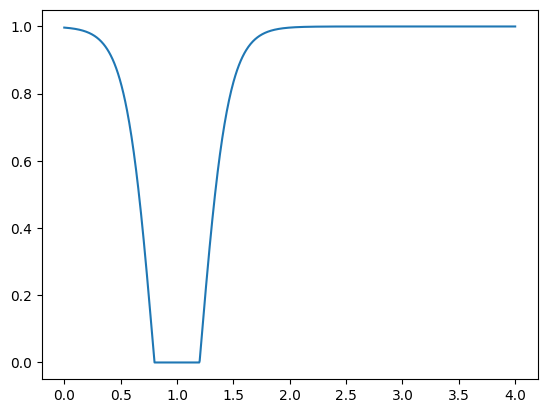

In [331]:
import numpy as np
import matplotlib.pyplot as plt

# Generate x values
x = np.linspace(0, 4, 1000)

# Calculate the corresponding y values
y = np.vectorize(piecewise_tanh2)(x, a=1, k=4)
#y = [piecewise_tanh(i) for i in x]
# Plot the function
plt.plot(x, y)


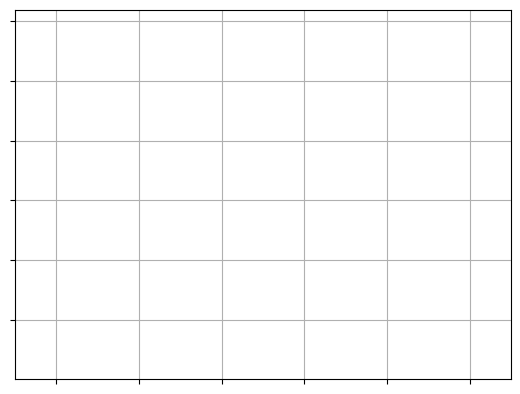

In [87]:
# Generate an empty scatter plot with 6 categories (1-6) and y from 0.4 to 0.9 with ticks at 1-6 and every 0.1

plt.xticks(np.arange(1,7,1))
plt.yticks(np.arange(0.4,1.0,0.1))
# Remove xticks labels  
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
plt.xlim(0.5,6.5)
plt.ylim(0.3,0.92)
# Seaborn style whitgrid
sns.set_style("whitegrid")
plt.grid()
plt.show()


In [8]:
# Author: Liu Li, Priscille de Dumast
# First version: 2022/05/20
# Updated on: 2024/07/16

import os

import numpy as np
import SimpleITK as sitk
import skimage
import gudhi as gd



def compute_topological_features(map):
    """
    Evaluate the topology of a given map.

    Parameters:
    - map: A 3D numpy array representing the map.

    Returns:
    - A tuple containing the Betti numbers and the Euler characteristic of the map.
    """

    # Betti number computation
    cubic = gd.CubicalComplex(dimensions=map.shape,
                              top_dimensional_cells=map.flatten(order='F'))

    cubic.persistence(homology_coeff_field=2, min_persistence=0.99)
    pairs_nda = cubic.cofaces_of_persistence_pairs()

    betti_number_0dim = pairs_nda[0][2].shape[0]
    betti_number_1dim = pairs_nda[0][1].shape[0]
    betti_number_2dim = pairs_nda[0][0].shape[0]
    betti_number_list = [betti_number_0dim, betti_number_1dim, betti_number_2dim]
    ec = int(betti_number_0dim) - int(betti_number_1dim) + int(betti_number_2dim)
    return betti_number_list, ec




"""
Sample code to evaluate the betti number and Euler characteristic on segmentation data from FeTA challenge.
"""

file_dir = os.path.join("/media/tsanchez/tsanchez_data/data/ERANET_bids/derivatives/bounti_seg/sub-150/ses-01/anat/sub-150_ses-01_acq-haste_res-0p5_run-all0505_dseg.nii.gz")

# Load labelmap image from nifty file
reader = sitk.ImageFileReader()
reader.SetFileName(file_dir)
dseg_sitk = reader.Execute();
dseg_sitk = sitk.Cast(dseg_sitk, sitk.sitkUInt16)

# Extract tissue of interest (cortex)
binarizer = sitk.BinaryThresholdImageFilter()
binarizer.SetLowerThreshold(2)
binarizer.SetUpperThreshold(2)
dseg_sitk = binarizer.Execute(dseg_sitk)

# Convert sitk image to np array
dseg = sitk.GetArrayFromImage(dseg_sitk).astype(int)


# # Crop array around main region of interest (to reduce computational cost of BN computation)
nda_ri = skimage.measure.regionprops((dseg > 0).astype(np.uint8), dseg)
nda_min_0, nda_min_1, nda_min_2, nda_max_0, nda_max_1, nda_max_2 = nda_ri[0].bbox

min_0 = max(0, nda_min_0 - 2)
max_0 = min(dseg.shape[0], nda_max_0 + 3)

min_1 = max(0, nda_min_1 - 2)
max_1 = min(dseg.shape[1], nda_max_1 + 3)

min_2 = max(0, nda_min_2 - 2)
max_2 = min(dseg.shape[2], nda_max_2 + 3)

dseg = dseg[min_0:max_0, min_1:max_1, min_2:max_2]

betti_number_list, ec = compute_topological_features(map=dseg, )


print('0-dimensional Betti number (# of connected components)   : {}'.format(betti_number_list[0]))
print('1-dimensional Betti number (# of tunnel holes)           : {}'.format(betti_number_list[1]))
print('2-dimensional Betti number (# of cavity holes)           : {}'.format(betti_number_list[2]))
print('Euler characteristics                                    : {}'.format(ec))


0-dimensional Betti number (# of connected components)   : 183
1-dimensional Betti number (# of tunnel holes)           : 259
2-dimensional Betti number (# of cavity holes)           : 0
Euler characteristics                                    : -76


In [802]:
import nibabel as nib
dseg2 = nib.load(file_dir).get_fdata()
dseg2 = dseg2.astype(int)
dseg2[dseg2 > 0] = 1



dseg2 = dseg2[min_2:max_2, min_1:max_1, min_0:max_0]

betti_number_list, ec = compute_topological_features(map=dseg2, )


print('0-dimensional Betti number (# of connected components)   : {}'.format(betti_number_list[0]))
print('1-dimensional Betti number (# of tunnel holes)           : {}'.format(betti_number_list[1]))
print('2-dimensional Betti number (# of cavity holes)           : {}'.format(betti_number_list[2]))
print('Euler characteristics                                    : {}'.format(ec))


0-dimensional Betti number (# of connected components)   : 3
1-dimensional Betti number (# of tunnel holes)           : 24
2-dimensional Betti number (# of cavity holes)           : 26
Euler characteristics                                    : 5


In [787]:
dseg.shape

(155, 189, 135)

In [788]:
dseg2.shape

(135, 189, 155)

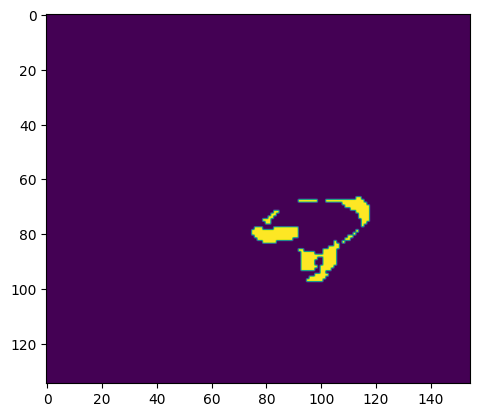

In [792]:
plt.imshow(dseg2[:,128,:])